# LSTM, GRU 하이퍼 파라미터 튜닝
- 따로 라이브러리를 사용하는 것은 아니고 단순히 경우의 수에 따라 반복하여 진행
- 돌린 뒤 MSE, RMSE, 시각화 결과를 보고 최종 하이퍼 파라미터 결정
- **저장한 파일은 content 폴더에 저장된다. 꼭 자기 노트북에 저장해두기!!!!! (런타임 해제하면 다 날아갑니다!!!!)**

### 데이터 RobustScaler로 정규화 및 train test split
- train test는 각각 5 ~ 25주, 26 ~ 30주. 81%, 19%

In [ ]:
import pandas as pd
from sklearn.preprocessing import RobustScaler

def scaling_train_test_split(df, columns) : # df, 스케일링할 columns
  # RobustScaler 객체 생성
  scaler = RobustScaler()

  # 선택한 열 스케일링
  df[columns] = scaler.fit_transform(df[columns])

  # 독립 변수와 종속 변수 분리
  X = df.drop(columns=['flw_get'])  # 독립 변수
  y = df['flw_get']  # 종속 변수

  # 주차(week) 정보를 기준으로 데이터를 그룹화
  week_groups = df.groupby('week')

  # 5주차부터 25주차까지를 훈련 데이터로 선택
  train_weeks = list(range(5, 26))
  train_data = pd.concat([group for week, group in week_groups if week in train_weeks])

  # 26주차부터 30주차까지를 테스트 데이터로 선택
  test_weeks = list(range(26, 31))
  test_data = pd.concat([group for week, group in week_groups if week in test_weeks])# 주차(week) 정보를 기준으로 데이터를 그룹화

  # 독립 변수와 종속 변수 분리
  X_train = train_data.drop(columns=['flw_get', 'id', 'week', 'obj_num', 'week_start_date'])  # 독립 변수 (week_start_date 열 제거)
  y_train = train_data['flw_get']  # 종속 변수
  X_test = test_data.drop(columns=['flw_get', 'id', 'week', 'obj_num', 'week_start_date'])  # 독립 변수 (week_start_date 열 제거)
  y_test = test_data['flw_get']  # 종속 변수


  return X_train, y_train, X_test, y_test

### 모델 생성 및 학습

In [ ]:
import tensorflow as tf
from sklearn.metrics import mean_squared_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, LSTM, Dense

# random seed 설정
tf.random.set_seed(42)

def lstm(X_train, y_train, num_units = 75, num_layers = 2, learning_rate = 0.00005, epochs = 200, batch_size = 32) :
  # 모델 생성 및 학습
  models = []

  # LSTM 모델
  model = Sequential()
  model.add(LSTM(num_units, input_shape=(X_train.shape[1], 1), return_sequences=True))
  for _ in range(num_layers - 1):
      model.add(LSTM(num_units, return_sequences=True))
  model.add(LSTM(num_units))
  model.add(Dense(1, activation='linear'))

  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate), loss='mean_squared_error')

  model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, verbose=0)
  models.append(model)

  return models


def gru(X_train, y_train, num_units = 75, num_layers = 2, learning_rate = 0.00005, epochs = 200, batch_size = 32) :
  # 모델 생성 및 학습
  models = []

  # GRU 모델
  model = Sequential()
  model.add(GRU(num_units, input_shape=(X_train.shape[1], 1), return_sequences=True))
  for _ in range(num_layers - 1):
      model.add(GRU(num_units, return_sequences=True))
  model.add(GRU(num_units))
  model.add(Dense(1, activation='linear'))

  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate), loss='mean_squared_error')

  model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, verbose=0)
  models.append(model)

  return models

### MSE, RMSE 계산 및 시각화

In [ ]:
# 검증

import numpy as np
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# 파일 다운로드용
# from google.colab import files

def validation(X_test, y_test, models, title) :
  validation_results_mse = []
  validation_results_rmse = []

  for model in models:
      y_pred = model.predict(X_test)
      mse = mean_squared_error(y_test, y_pred)
      rmse = np.sqrt(mean_squared_error(y_test, y_pred))

      validation_results_mse.append(mse)
      validation_results_rmse.append(rmse)

  # 검증 결과 평균 출력
  mean_mse = np.mean(validation_results_mse)
  print("평균 검증 MSE:", mean_mse)

  mean_rmse = np.mean(validation_results_rmse)
  print("평균 검증 RMSE:", mean_rmse)

  plt.figure(figsize=(15,10))

  plt.plot(range(len(y_test)), y_test, color='blue')
  plt.plot(range(len(y_pred)), y_pred,  color='red')

  for i in range(1, 11) :
    plt.axvline(x=20*i, linestyle='dotted')

  plt.title(title)
  plt.savefig(f"{title}.png")

  # # 파일 다운로드용
  # files.download(f"{title}.png")
  plt.show()

  return mean_mse, mean_rmse

### 튜닝할 하이퍼 파라미터 후보 정의
- 각자가 맡은 것에 따라 수정하기

In [ ]:
# 튜닝할 하이퍼파라미터 후보 정의
# num_units_case = [32, 64, 75]             # 레이어 별 노드 개수(units)
num_units_case = [64]             # 레이어 별 노드 개수(units)
num_layers_case = [2, 3]                       # 히든 레이어 개수
learning_rate_case = [0.00005, 0.0001, 0.001]  # 학습률
epochs_case = [100, 150, 200]                  # 에포크
batch_size_case = [16, 32]                 # 배치 크기

### A case 코드 실행
- 최최종데이터 파일에 업로드
- 최대한 원본 코드 수정하지 않기 (문제가 생길 수도 있으니)

#### 데이터 불러오기 및 split

In [ ]:
df = pd.read_csv("/최최종데이터_a_지난주추가.csv")
df.sort_values(by=["id", "week", "obj_num"], inplace=True)

columns = df.columns[4:]

X_train, y_train, X_test, y_test = scaling_train_test_split(df, columns)

#### 모델 돌리기 (LSTM)
- 마지막 줄의 history 저장할 때, 파일명 주의!!! 자기 상황에 맞게 수정하기!!!

A_LSTM(64_2_5e-05_100_16)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.6376049619266164
평균 검증 RMSE: 0.7985016981363386


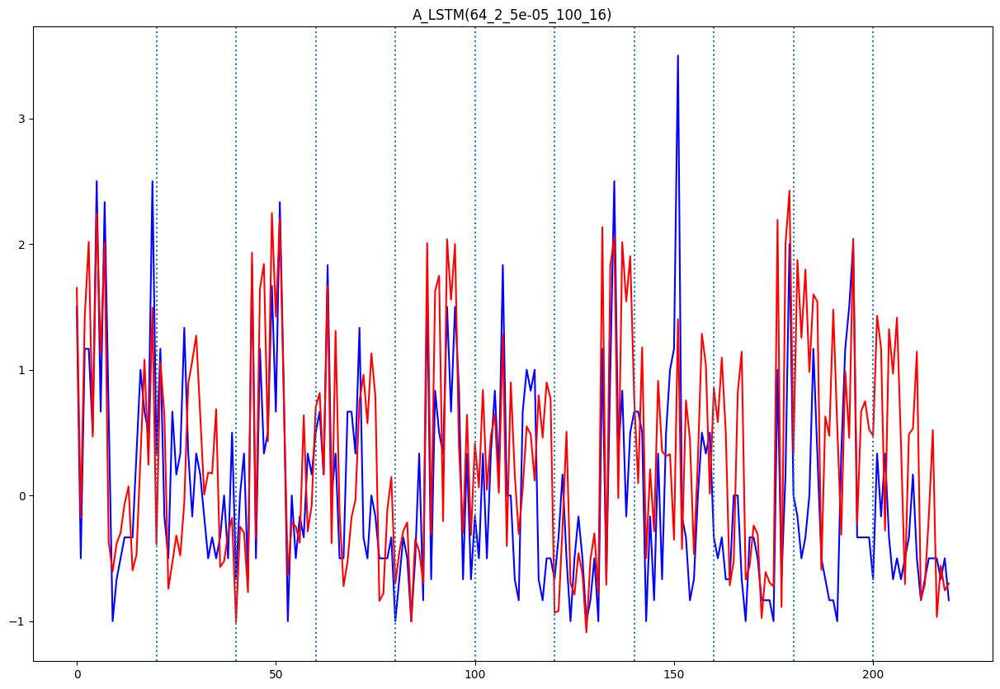

A_LSTM(64_2_5e-05_100_32)
7/7 [==============================] - 1s 4ms/step
평균 검증 MSE: 0.5146999426585172
평균 검증 RMSE: 0.7174259144040708


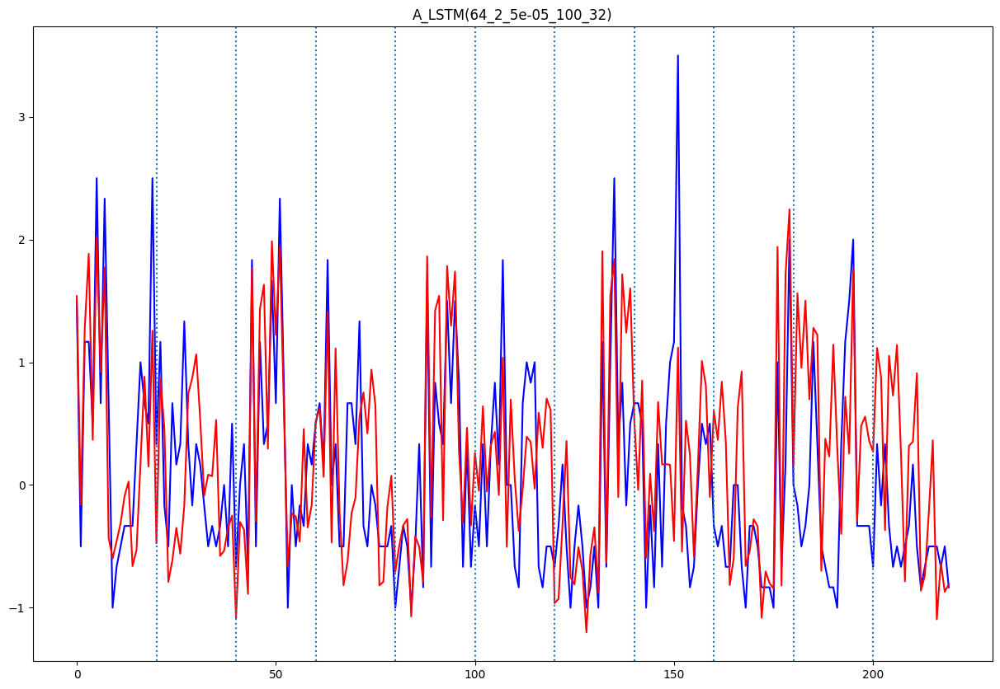

A_LSTM(64_2_5e-05_150_16)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.4938385179019676
평균 검증 RMSE: 0.7027364498174031


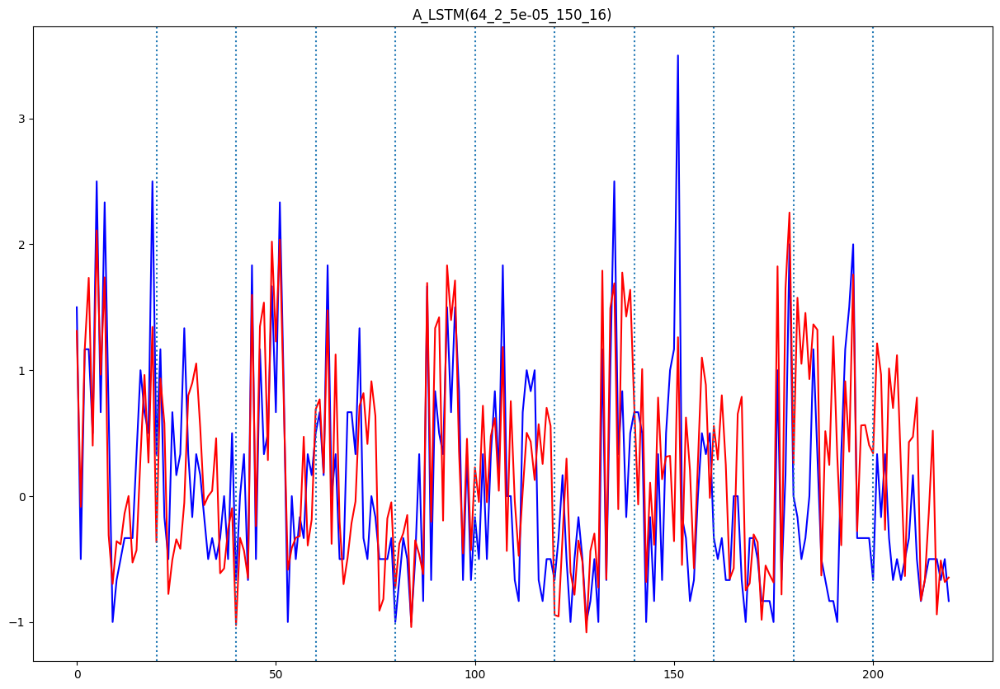

A_LSTM(64_2_5e-05_150_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.4191008317390955
평균 검증 RMSE: 0.6473799747745489


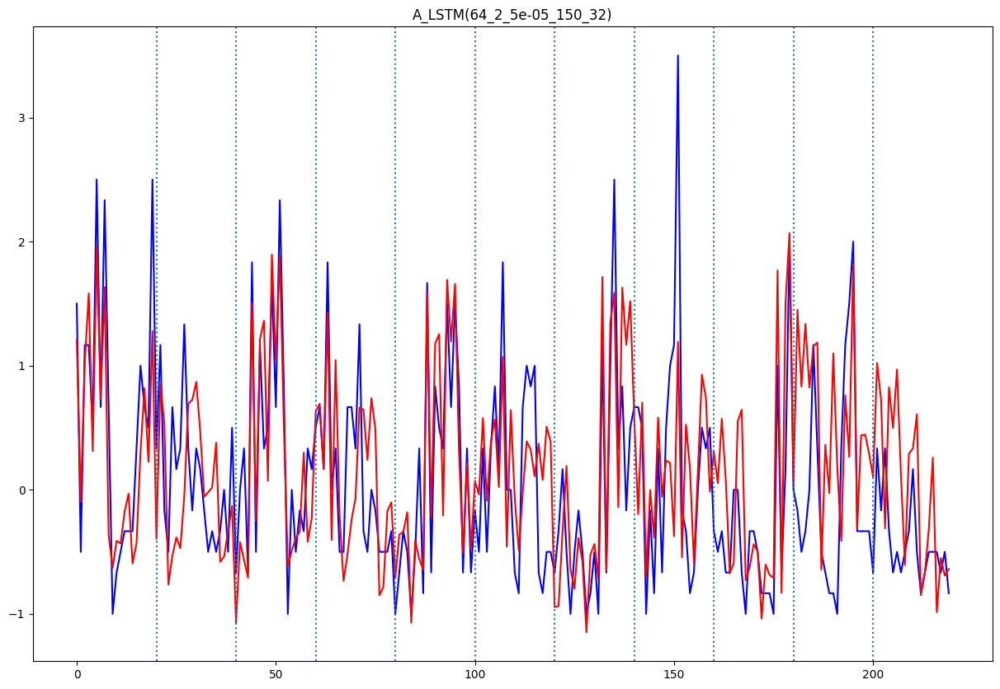

A_LSTM(64_2_5e-05_200_16)
7/7 [==============================] - 2s 9ms/step
평균 검증 MSE: 0.6433397426520026
평균 검증 RMSE: 0.8020846231240208


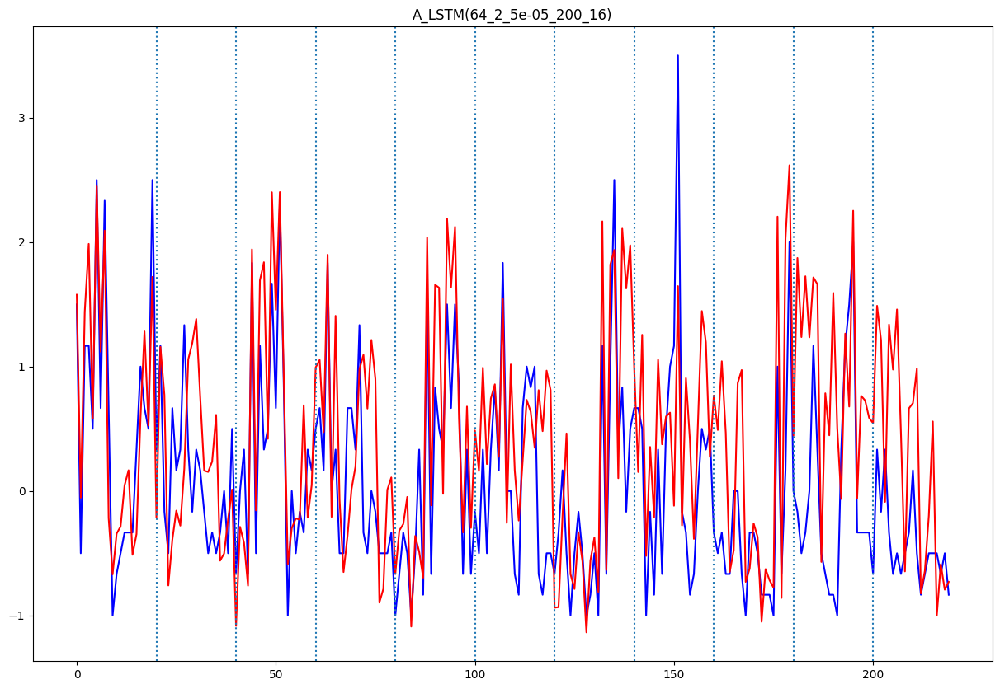

A_LSTM(64_2_5e-05_200_32)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.5192768033171826
평균 검증 RMSE: 0.7206086339457658


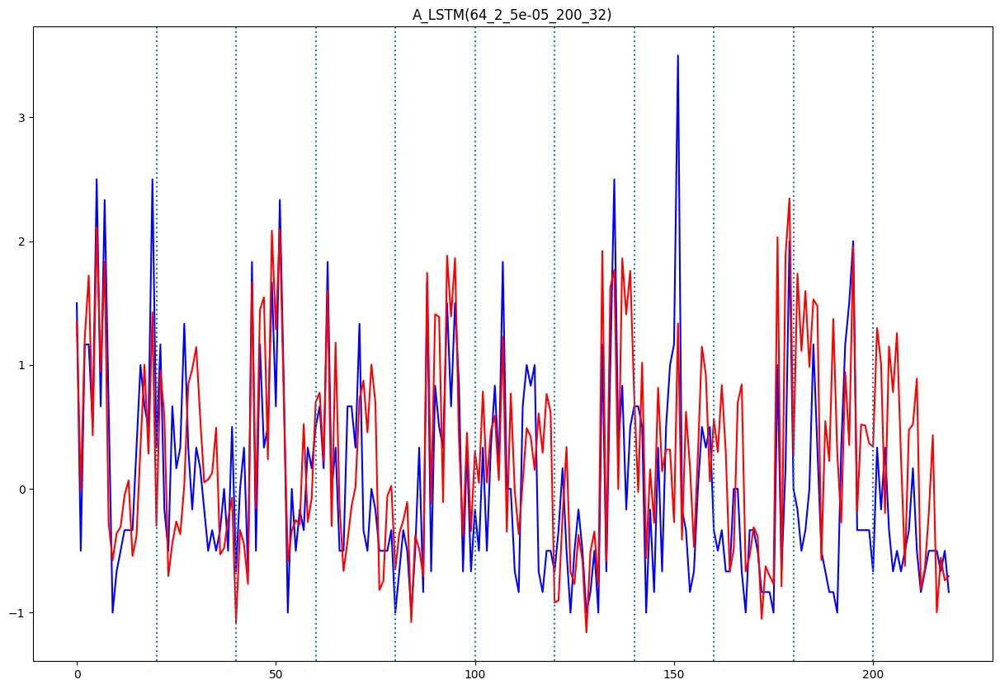

A_LSTM(64_2_0.0001_100_16)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.6848907671643902
평균 검증 RMSE: 0.8275812752620677


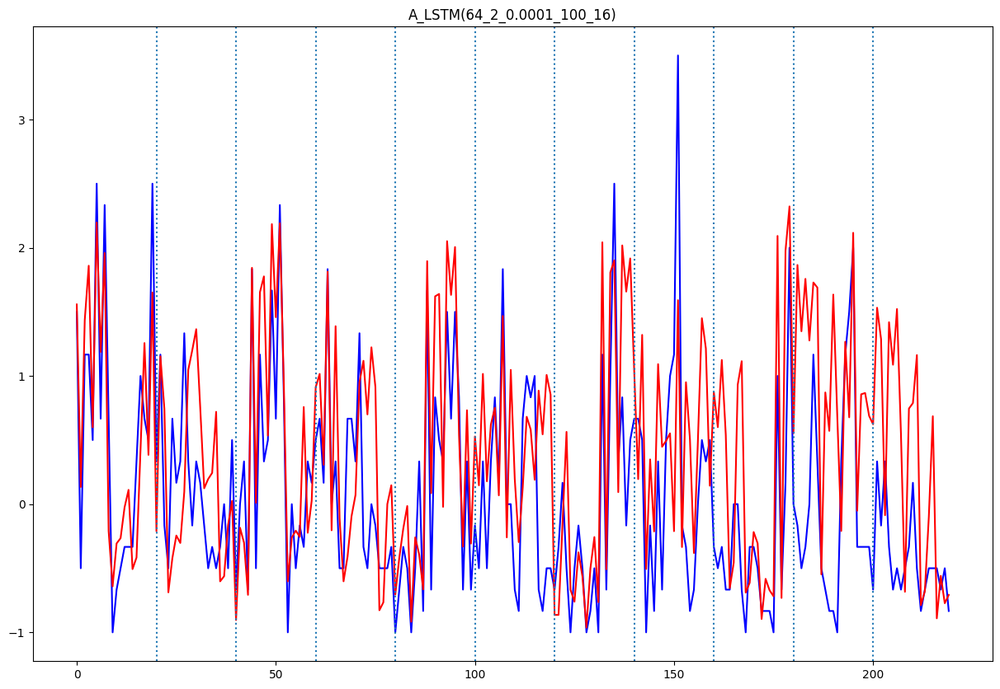

A_LSTM(64_2_0.0001_100_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.564160739858214
평균 검증 RMSE: 0.7511063439075815


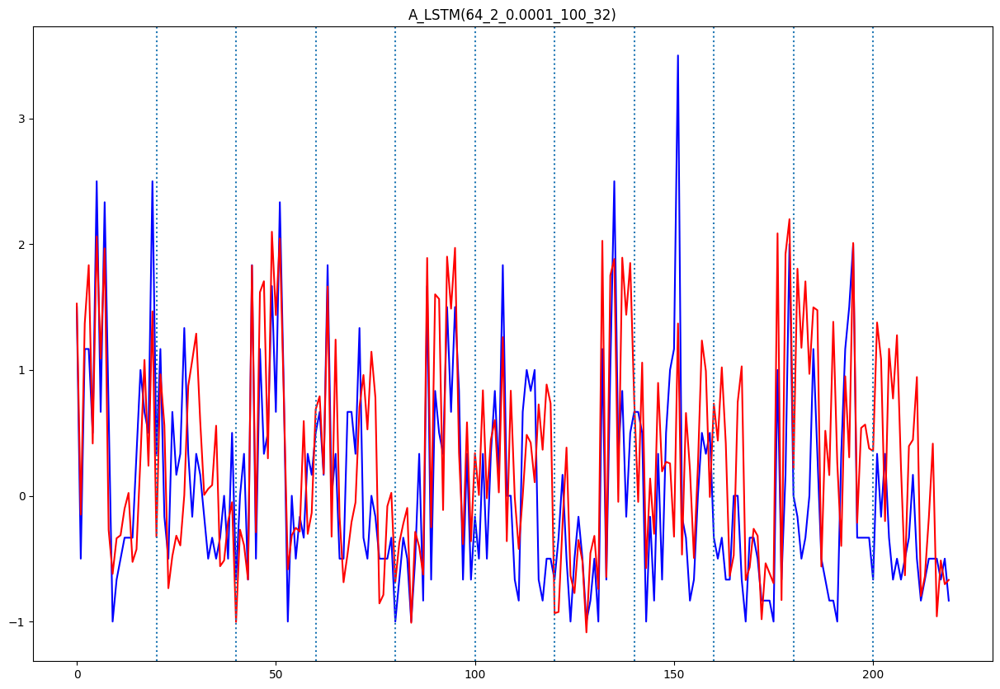

A_LSTM(64_2_0.0001_150_16)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.45940056002612706
평균 검증 RMSE: 0.6777909412393522


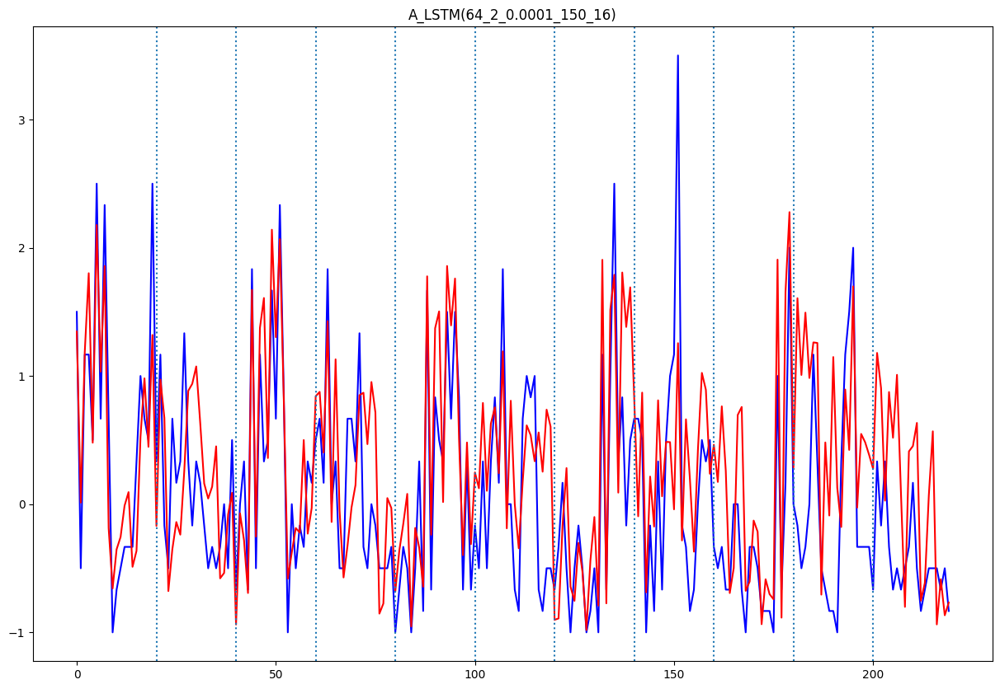

A_LSTM(64_2_0.0001_150_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.3602436058249446
평균 검증 RMSE: 0.6002029705232594


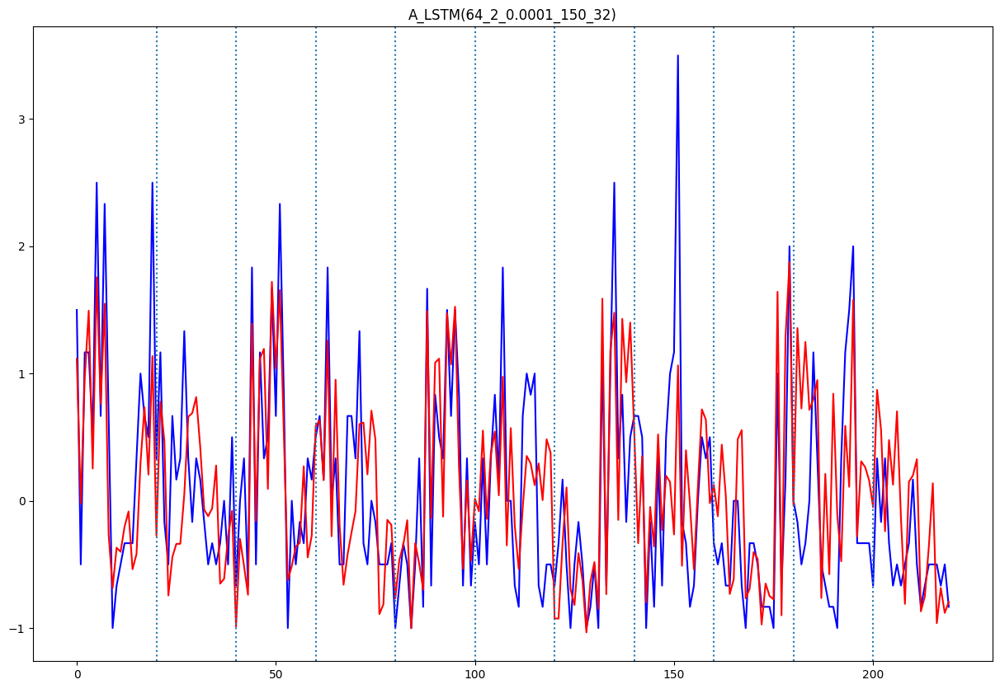

A_LSTM(64_2_0.0001_200_16)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.504930089054603
평균 검증 RMSE: 0.7105843293055393


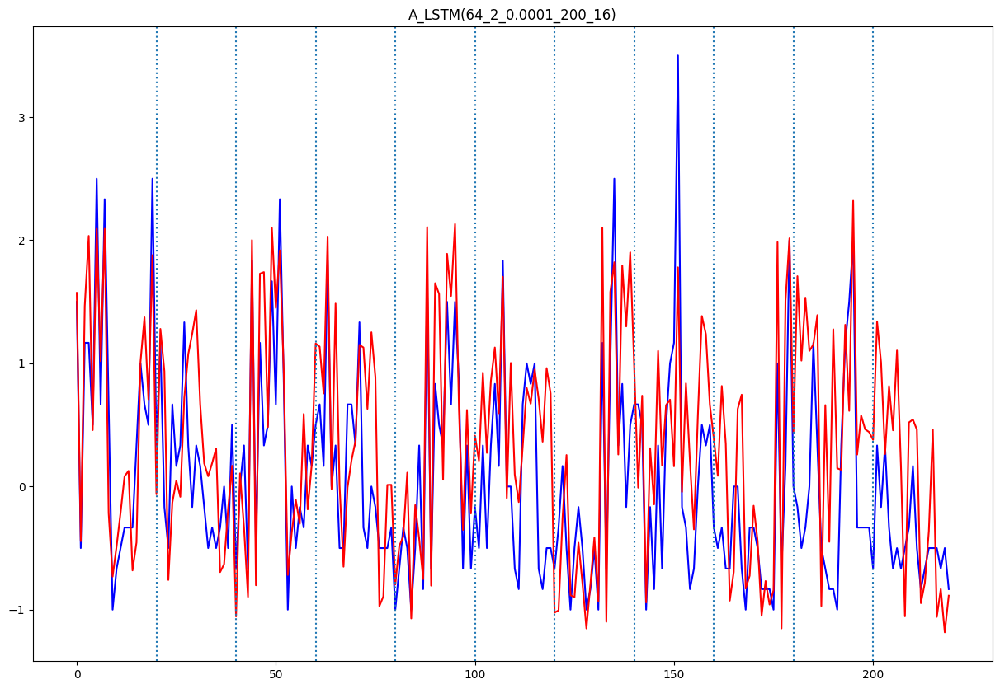

A_LSTM(64_2_0.0001_200_32)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.39157192359023907
평균 검증 RMSE: 0.6257570803356836


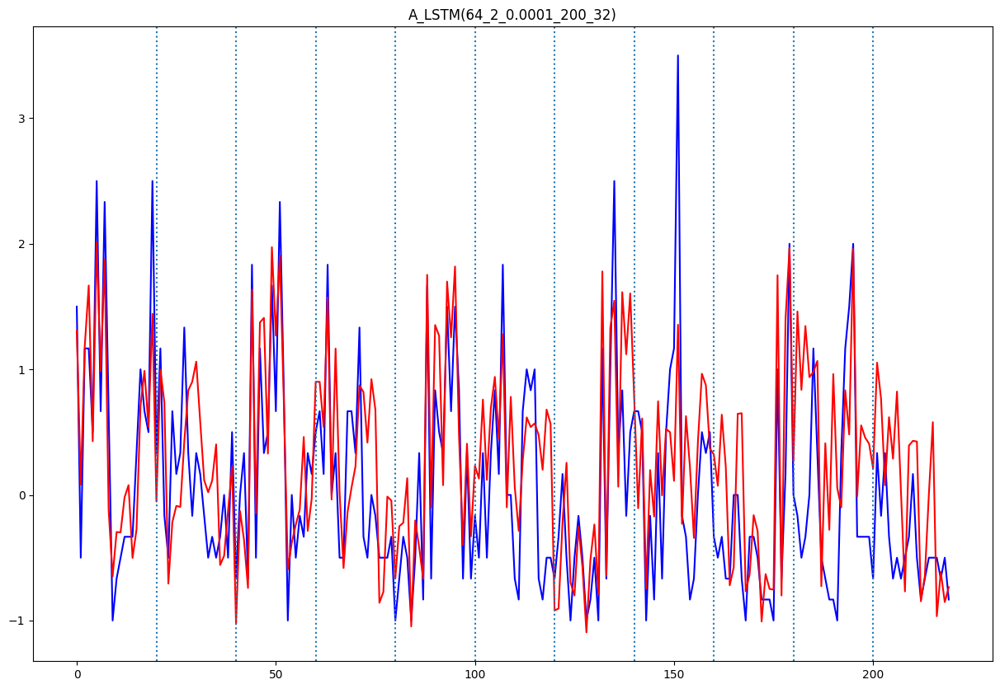

A_LSTM(64_2_0.001_100_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.3863932285817795
평균 검증 RMSE: 0.6216053640226888


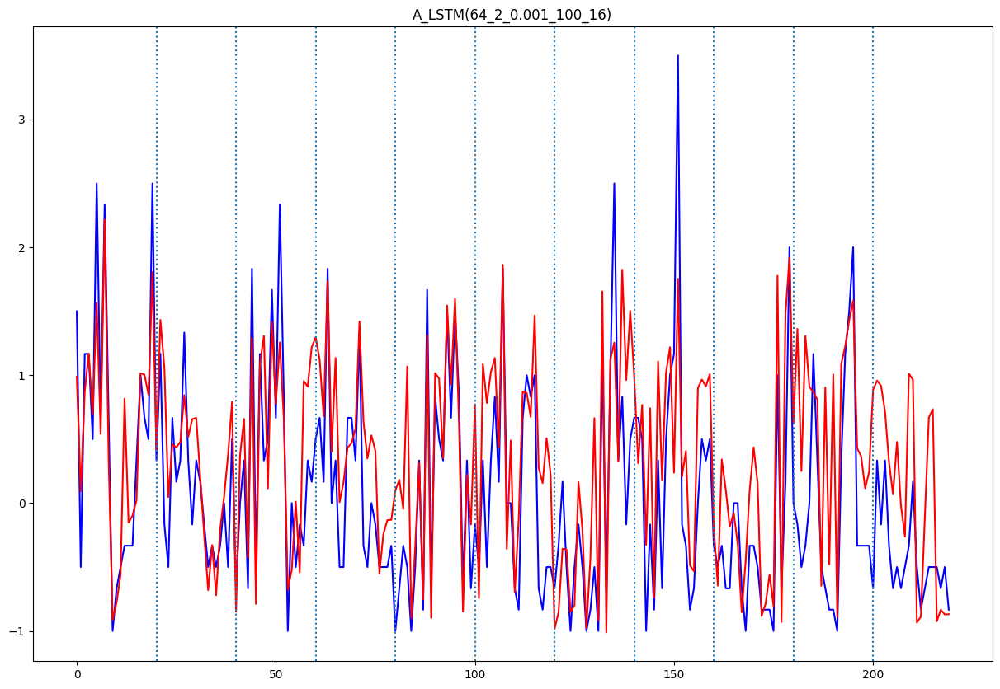

A_LSTM(64_2_0.001_100_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.45672801295691434
평균 검증 RMSE: 0.6758165527396576


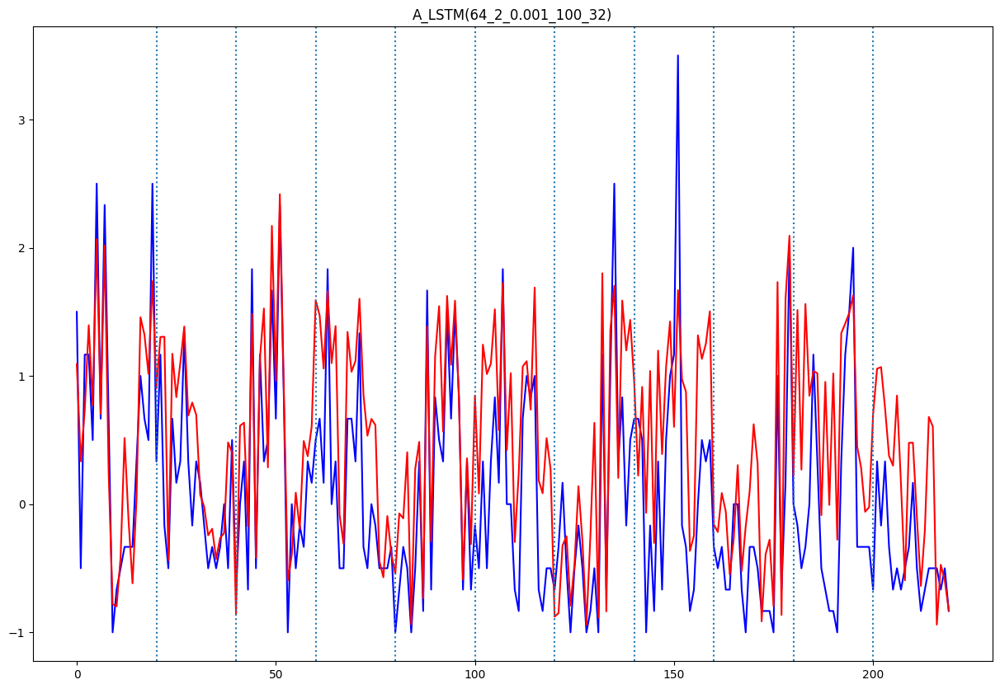

A_LSTM(64_2_0.001_150_16)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.4617759648215571
평균 검증 RMSE: 0.679540995688676


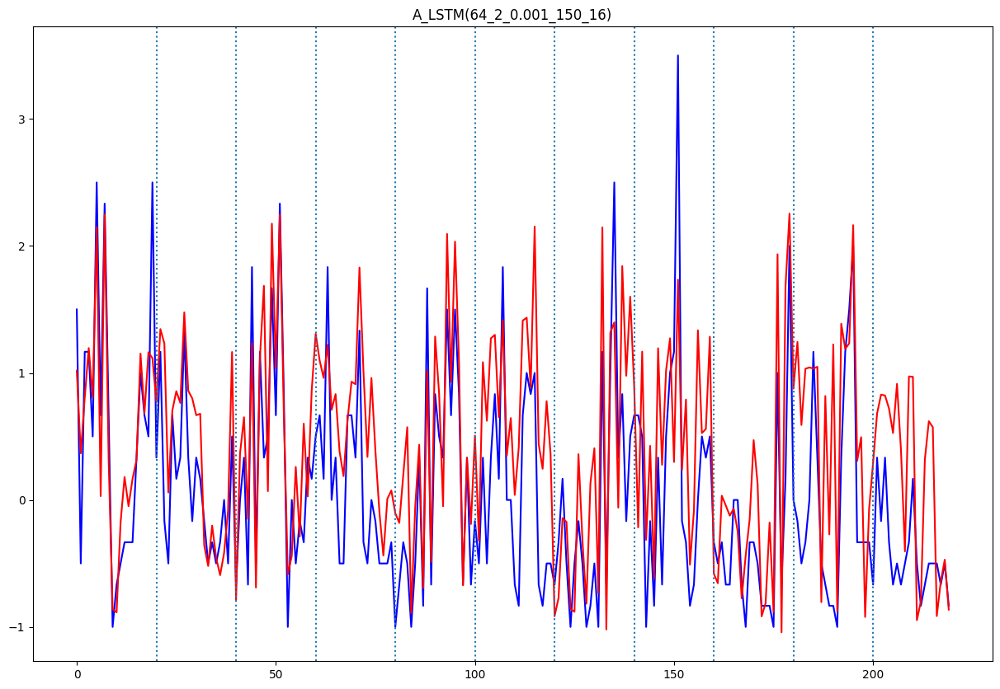

A_LSTM(64_2_0.001_150_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.4441518292610583
평균 검증 RMSE: 0.6664471691447554


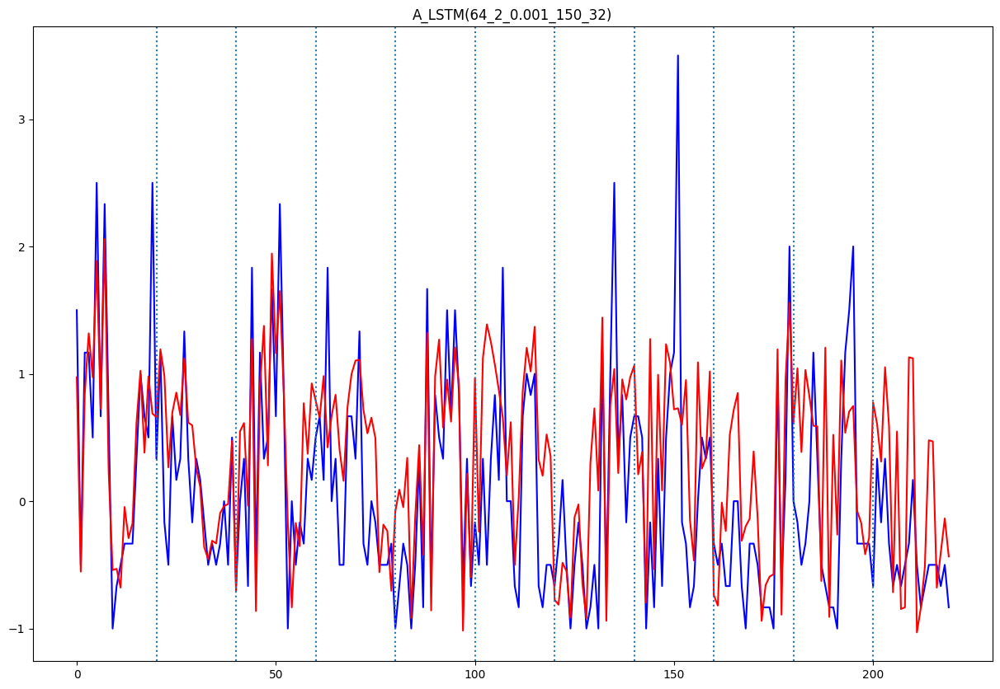

A_LSTM(64_2_0.001_200_16)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.36153048801083915
평균 검증 RMSE: 0.6012740539977084


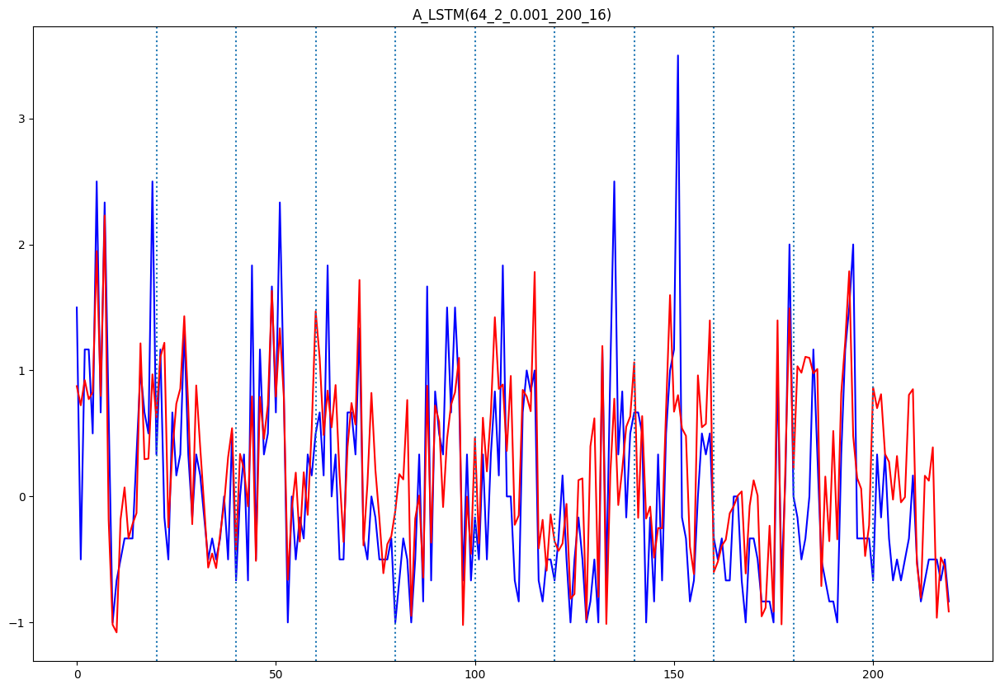

A_LSTM(64_2_0.001_200_32)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.500923328770599
평균 검증 RMSE: 0.707759372082489


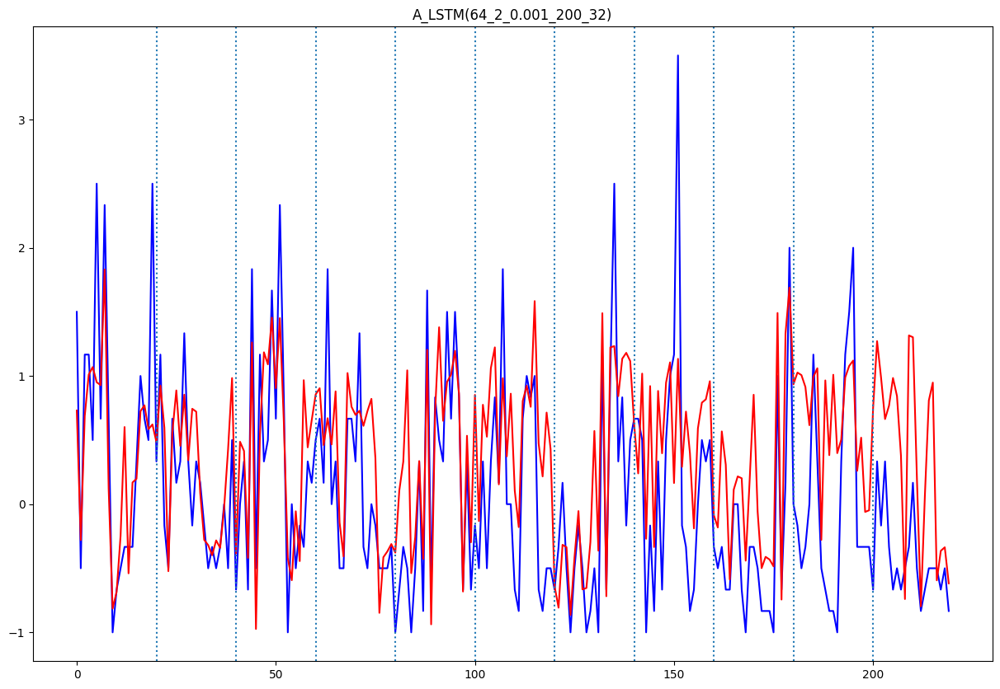

A_LSTM(64_3_5e-05_100_16)
7/7 [==============================] - 1s 8ms/step
평균 검증 MSE: 0.726049393446496
평균 검증 RMSE: 0.852085320520484


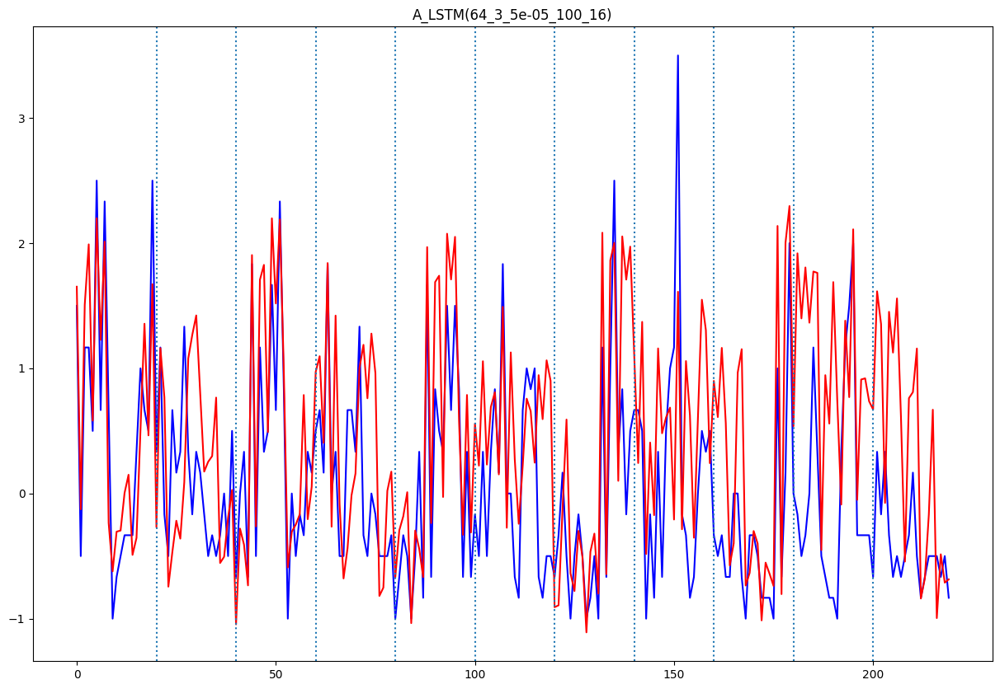

A_LSTM(64_3_5e-05_100_32)
7/7 [==============================] - 3s 6ms/step
평균 검증 MSE: 0.4981359074944308
평균 검증 RMSE: 0.7057874378978637


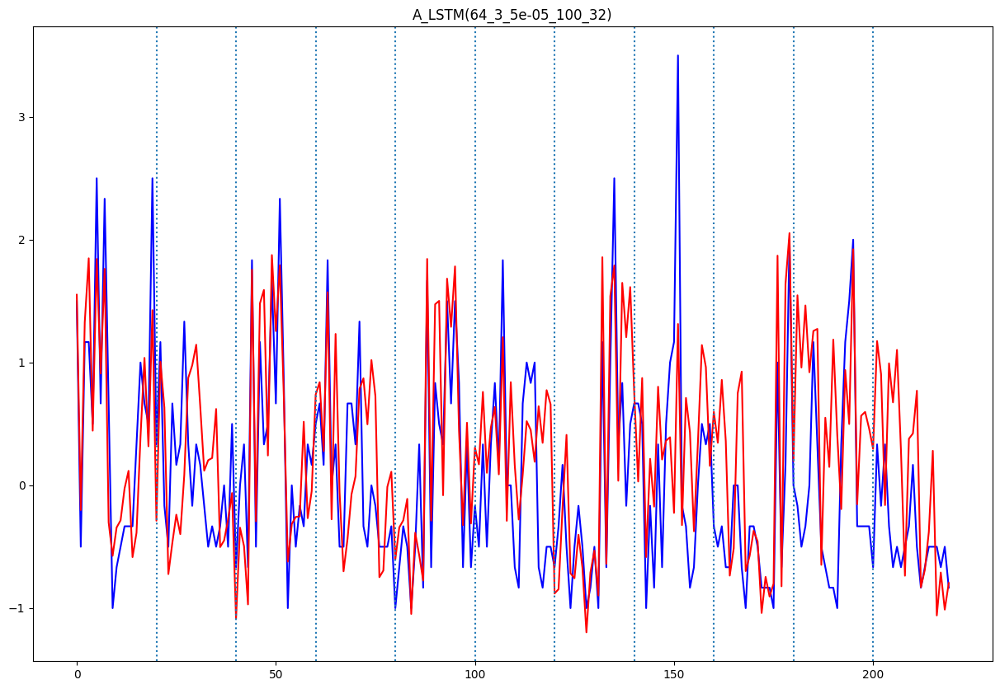

A_LSTM(64_3_5e-05_150_16)
7/7 [==============================] - 1s 9ms/step
평균 검증 MSE: 0.4728736864487848
평균 검증 RMSE: 0.6876581174164854


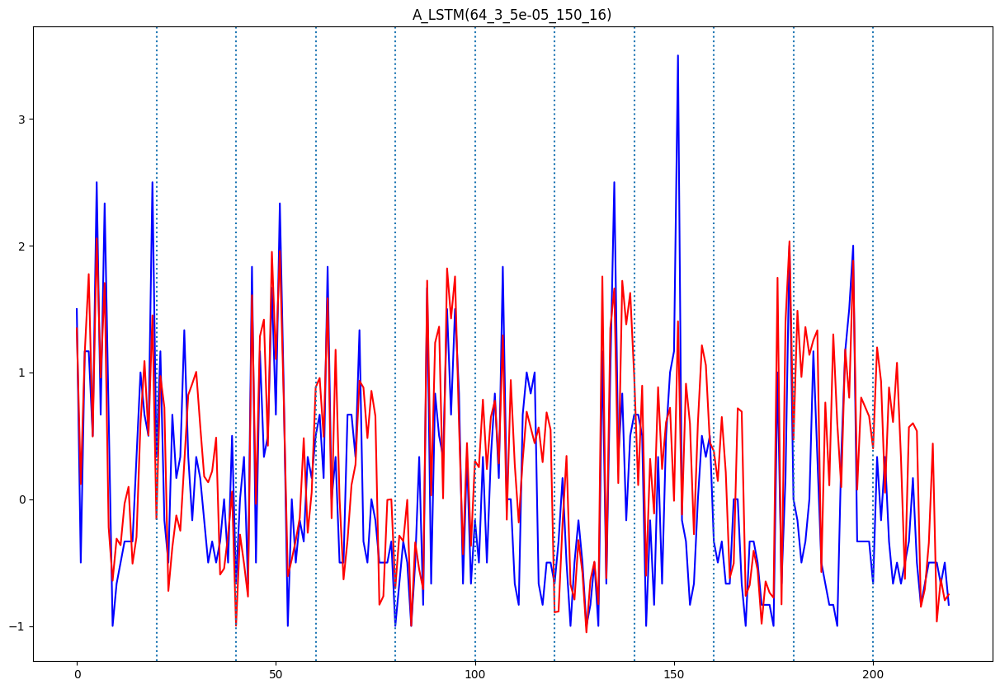

A_LSTM(64_3_5e-05_150_32)
7/7 [==============================] - 1s 9ms/step
평균 검증 MSE: 0.410180189562606
평균 검증 RMSE: 0.6404531126964768


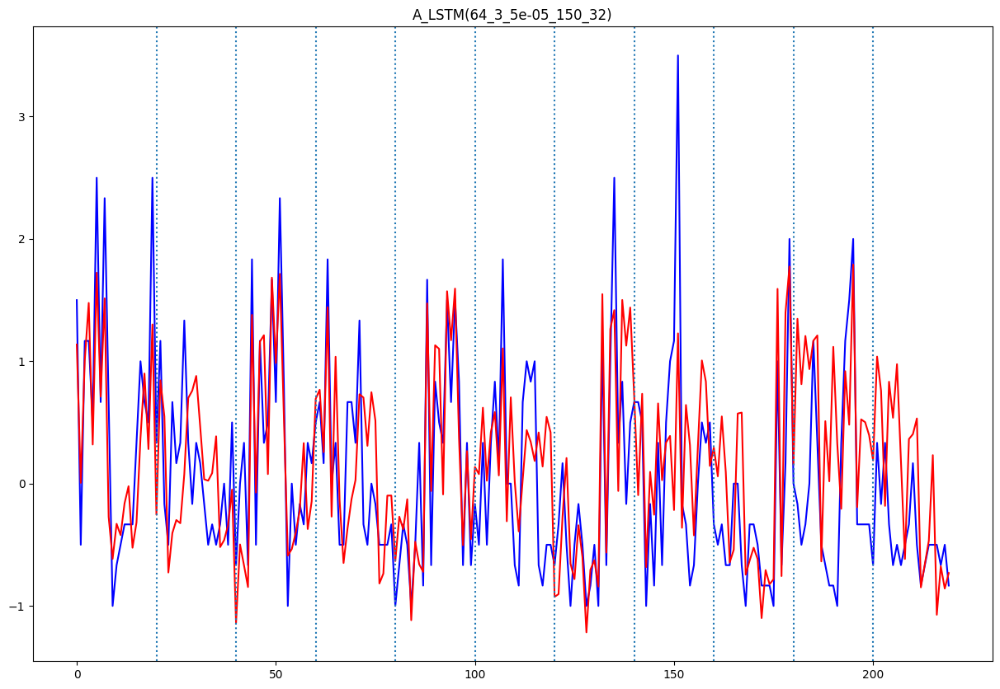

A_LSTM(64_3_5e-05_200_16)
7/7 [==============================] - 1s 8ms/step
평균 검증 MSE: 0.6234234667678276
평균 검증 RMSE: 0.7895716983072706


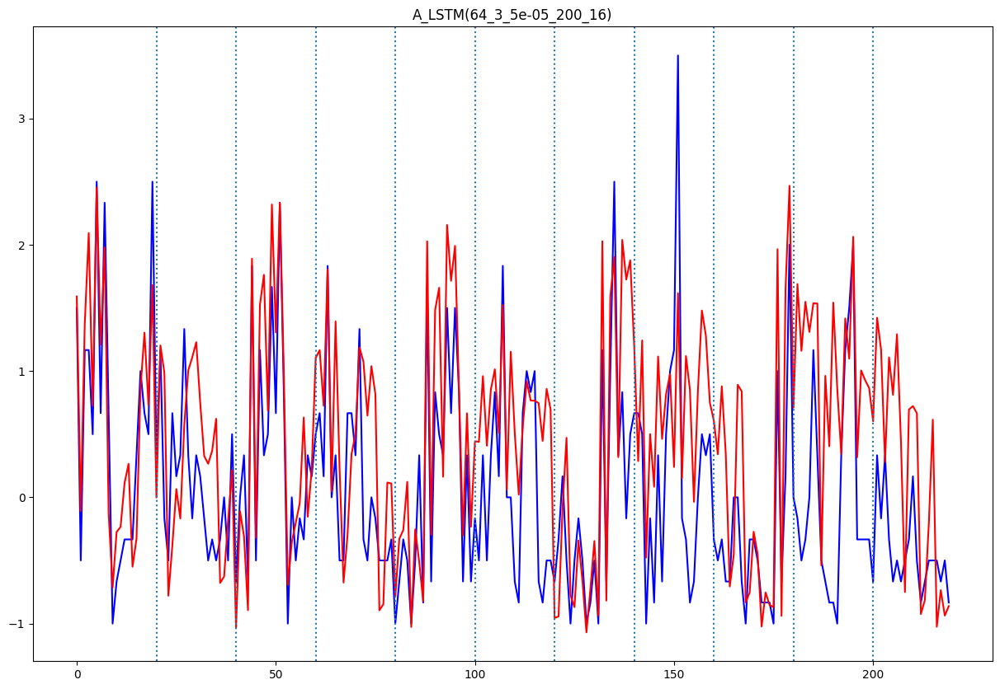

A_LSTM(64_3_5e-05_200_32)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.5069594670015407
평균 검증 RMSE: 0.7120108615755385


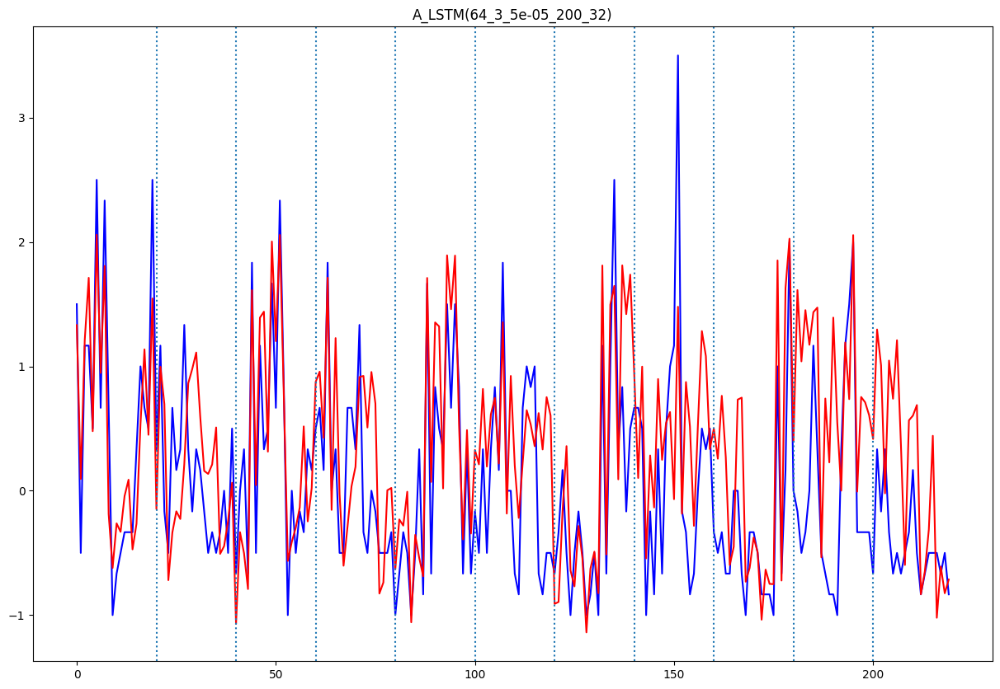

A_LSTM(64_3_0.0001_100_16)
7/7 [==============================] - 1s 8ms/step
평균 검증 MSE: 0.5623538141464439
평균 검증 RMSE: 0.7499025364315312


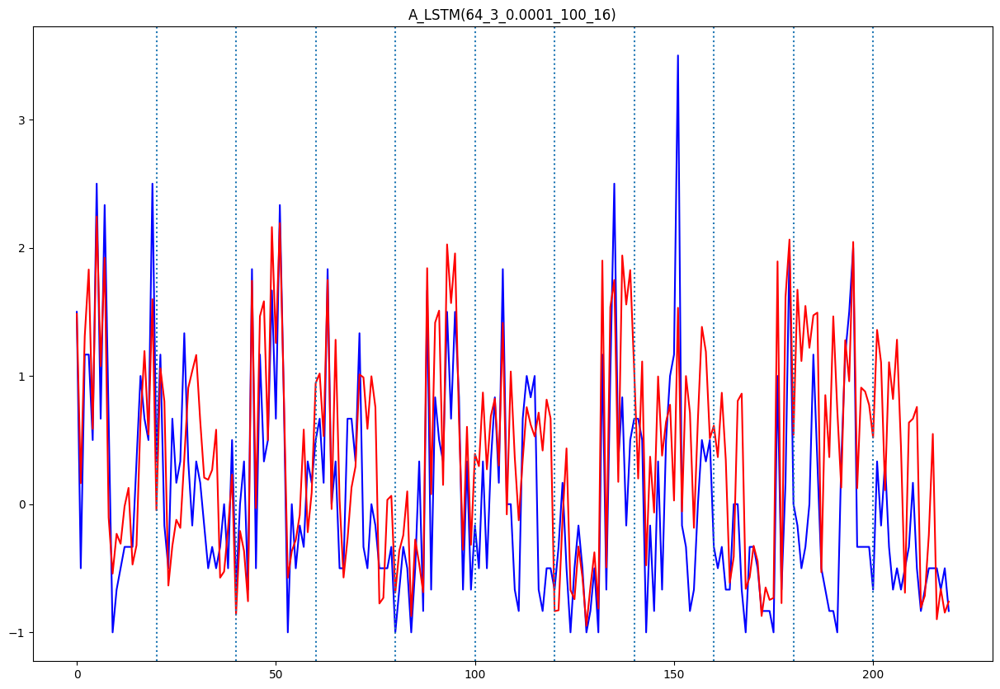

A_LSTM(64_3_0.0001_100_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.7687343320706187
평균 검증 RMSE: 0.8767749609053732


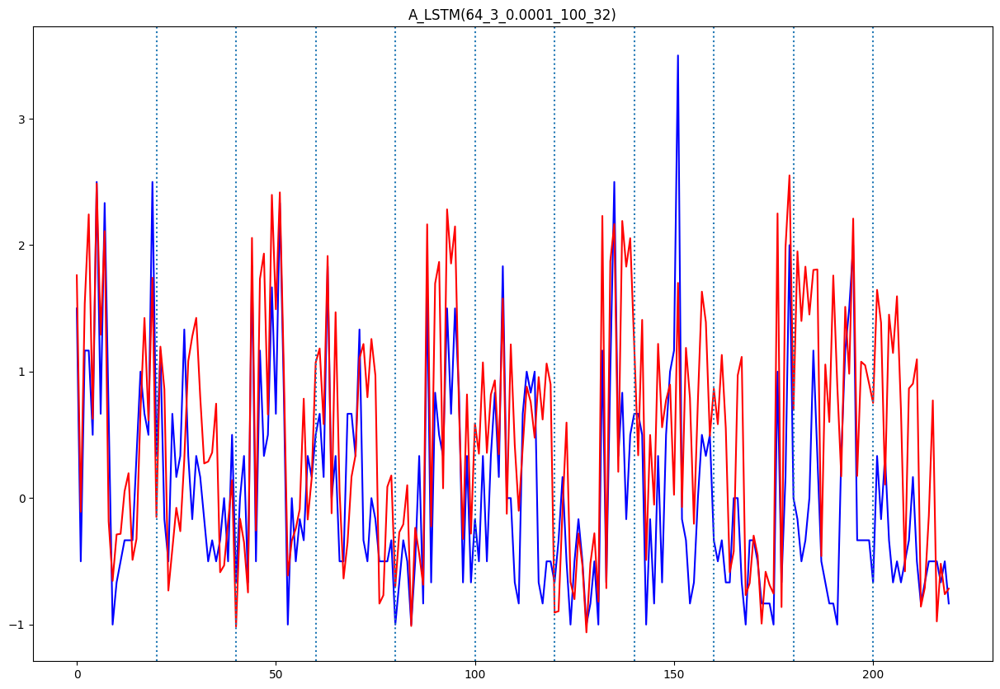

A_LSTM(64_3_0.0001_150_16)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.40674269338148805
평균 검증 RMSE: 0.6377638225718735


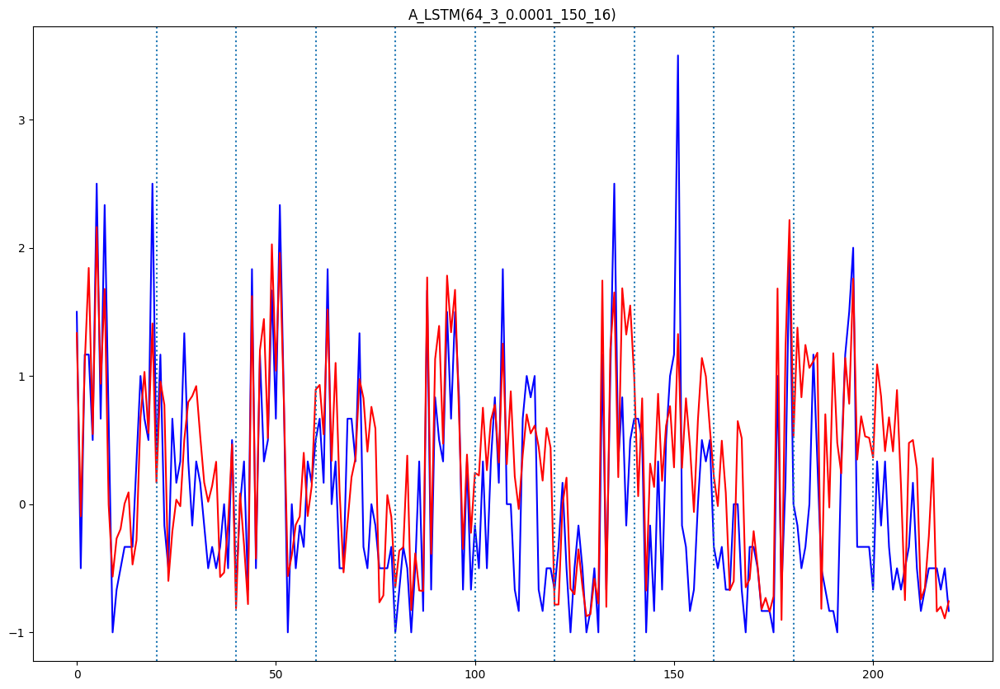

A_LSTM(64_3_0.0001_150_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.38525692009872
평균 검증 RMSE: 0.6206906798871077


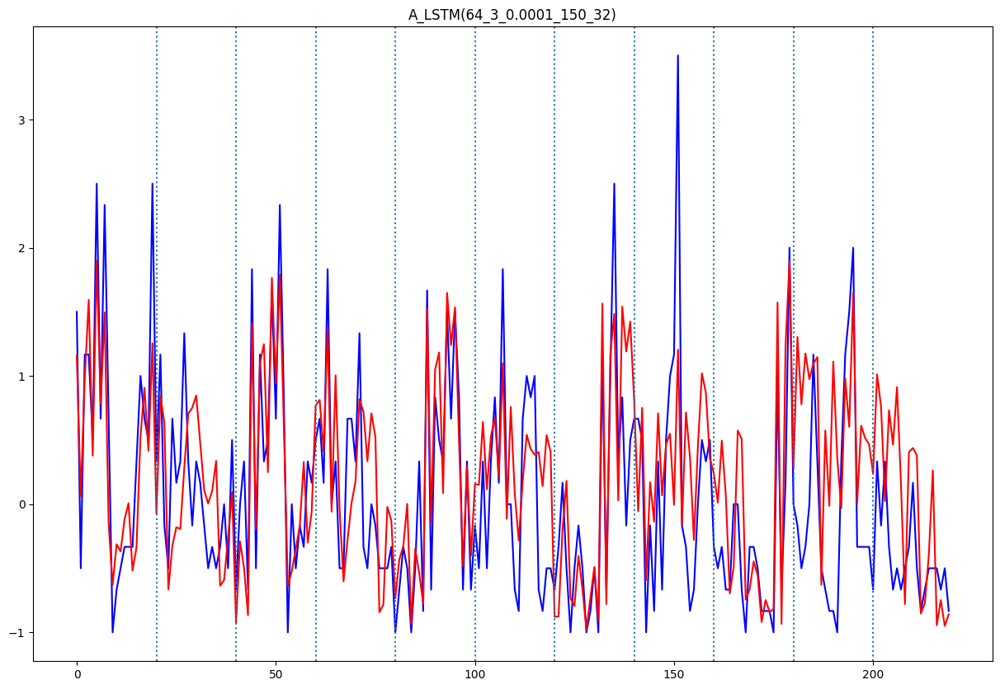

A_LSTM(64_3_0.0001_200_16)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.5003344517384188
평균 검증 RMSE: 0.7073432347442214


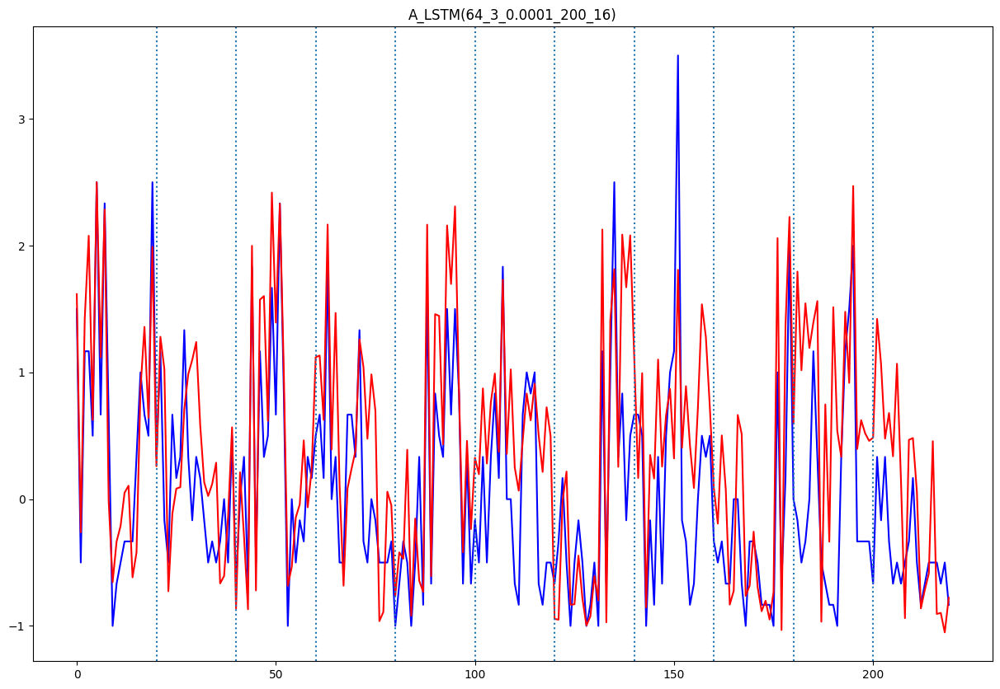

A_LSTM(64_3_0.0001_200_32)
7/7 [==============================] - 1s 8ms/step
평균 검증 MSE: 0.48075946133947967
평균 검증 RMSE: 0.6933682004097677


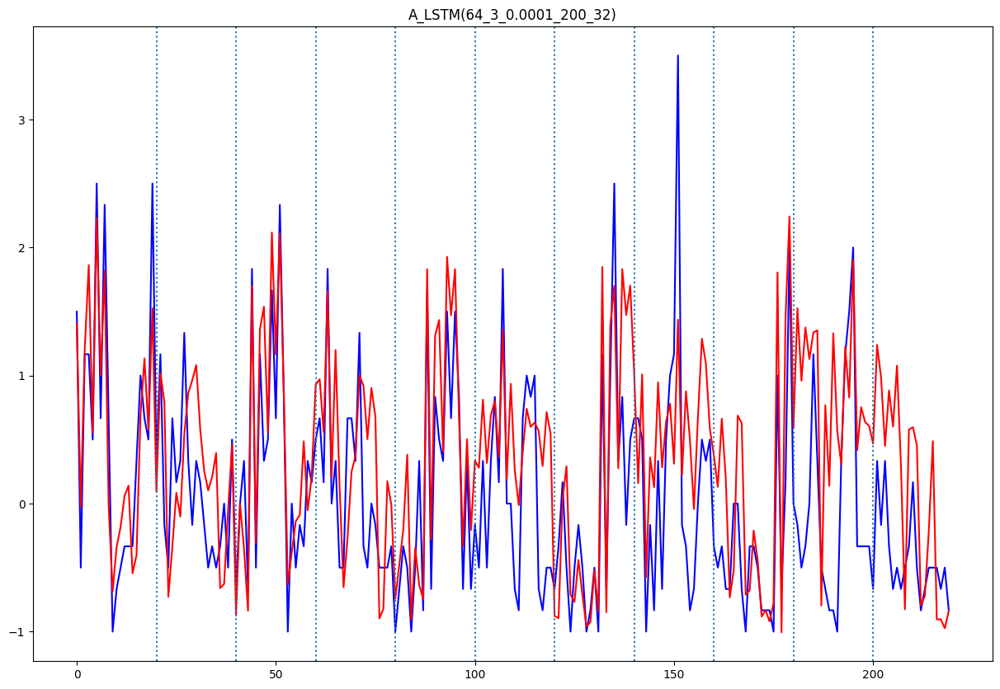

A_LSTM(64_3_0.001_100_16)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.44972993616437884
평균 검증 RMSE: 0.6706190693414398


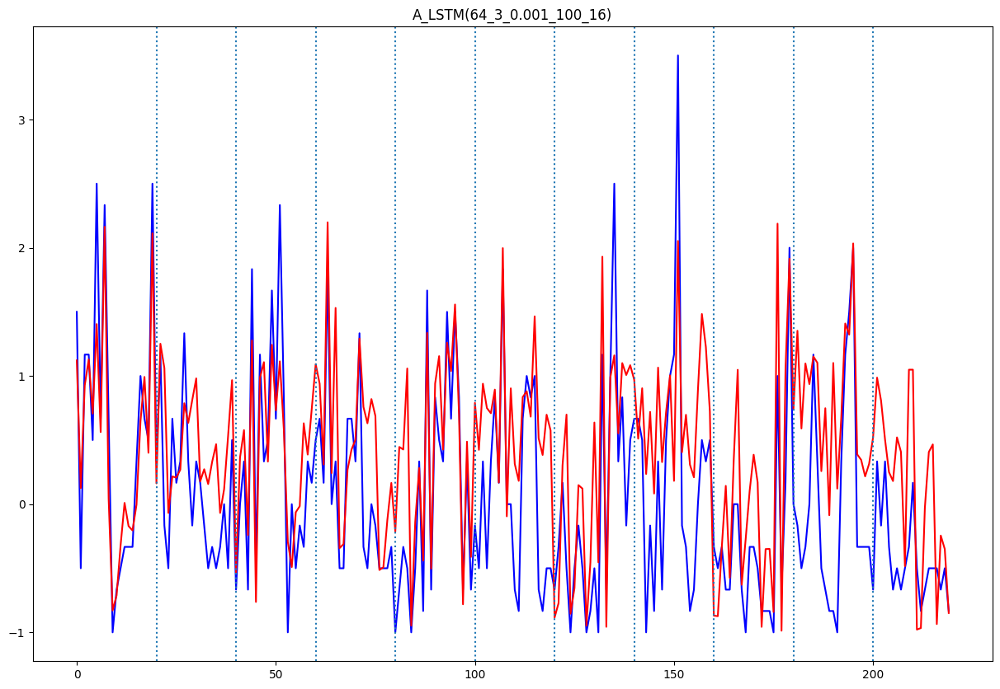

A_LSTM(64_3_0.001_100_32)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.3883758522119767
평균 검증 RMSE: 0.6231980842492832


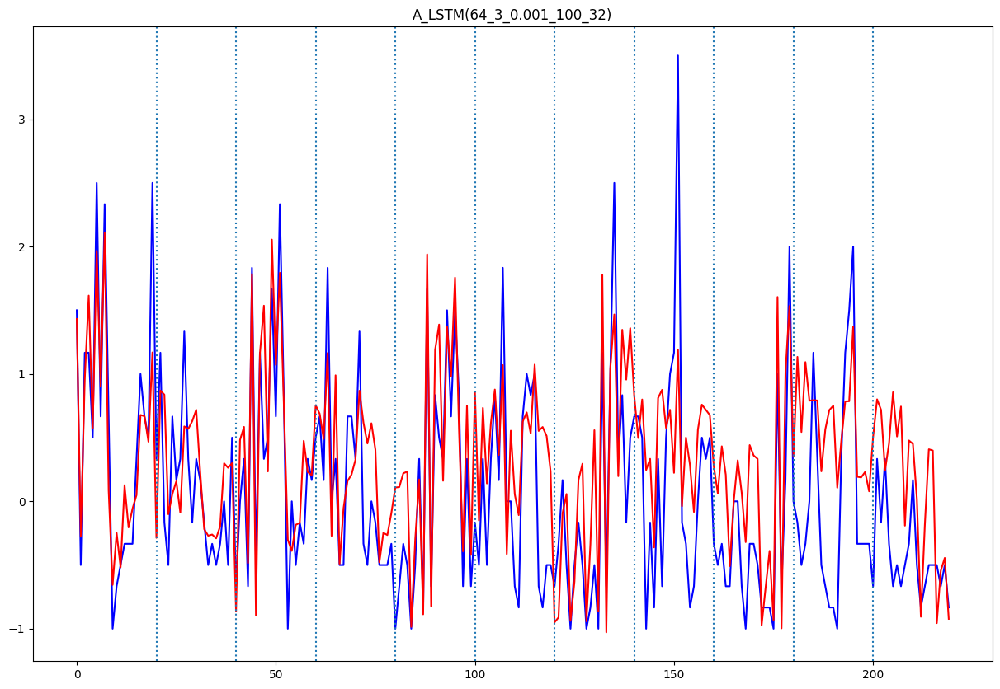

A_LSTM(64_3_0.001_150_16)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.3112259932261269
평균 검증 RMSE: 0.5578763243104397


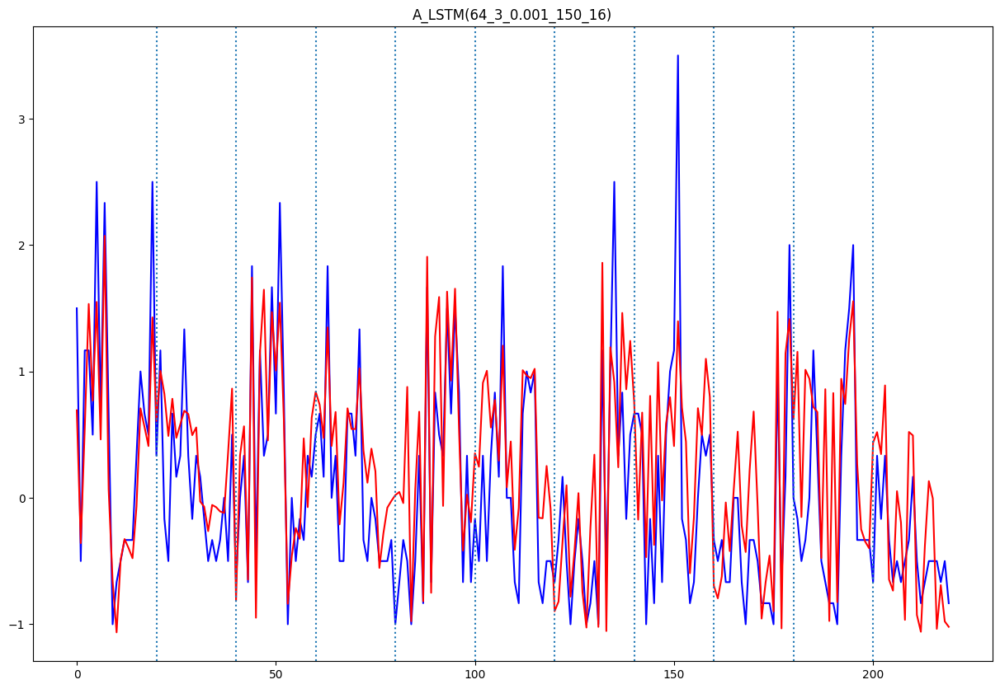

A_LSTM(64_3_0.001_150_32)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.41372103828408613
평균 검증 RMSE: 0.6432115035383665


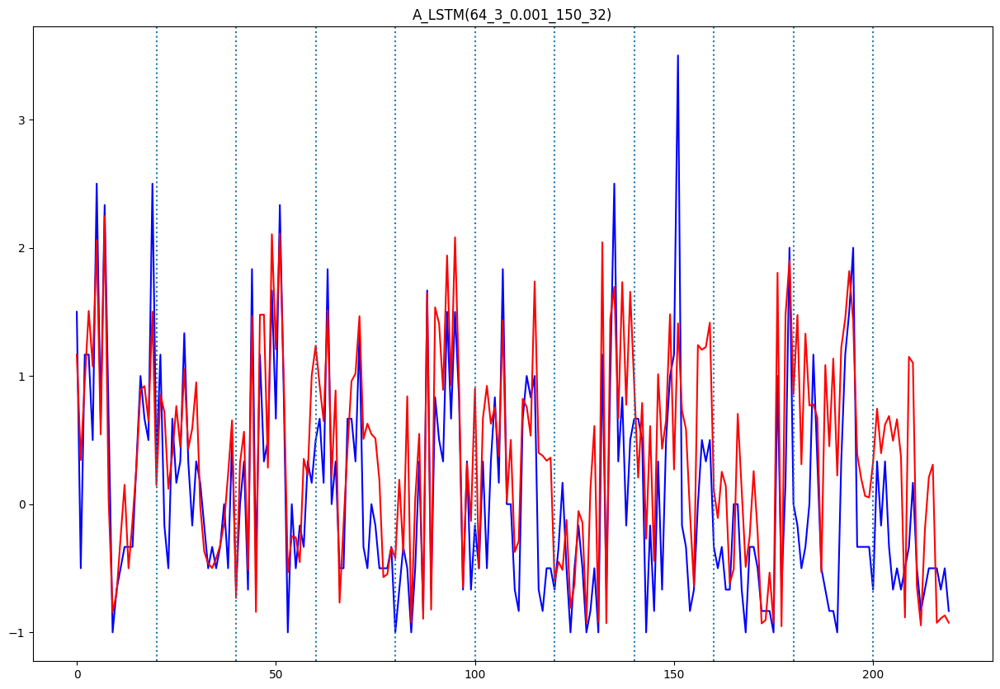

A_LSTM(64_3_0.001_200_16)
7/7 [==============================] - 1s 9ms/step
평균 검증 MSE: 0.379005321500218
평균 검증 RMSE: 0.6156340808469086


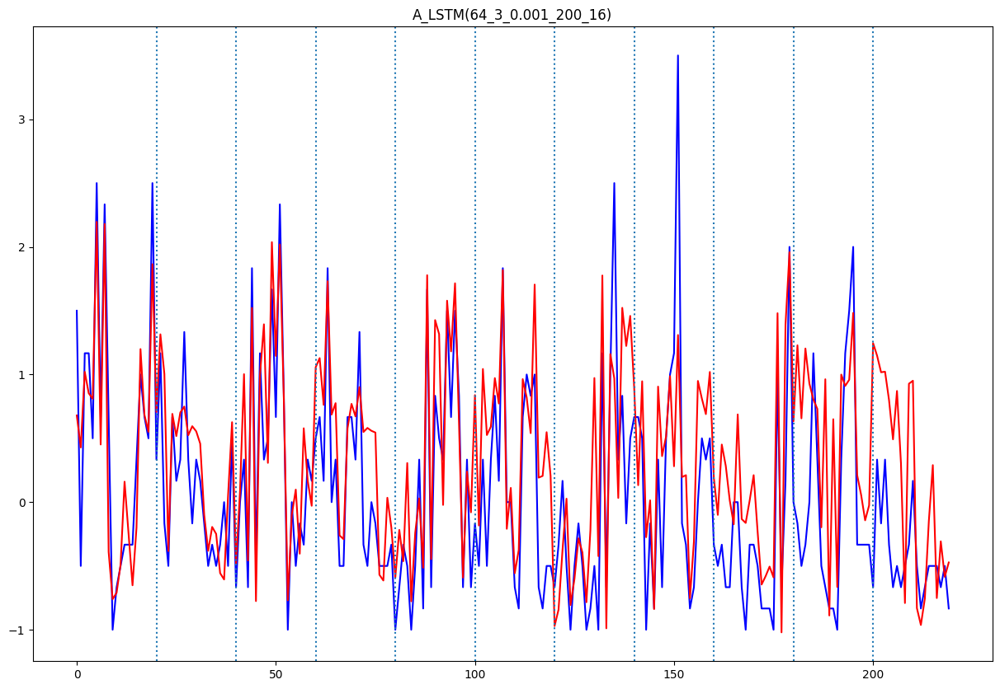

A_LSTM(64_3_0.001_200_32)
7/7 [==============================] - 2s 10ms/step
평균 검증 MSE: 0.4211385356902122
평균 검증 RMSE: 0.6489518747104536


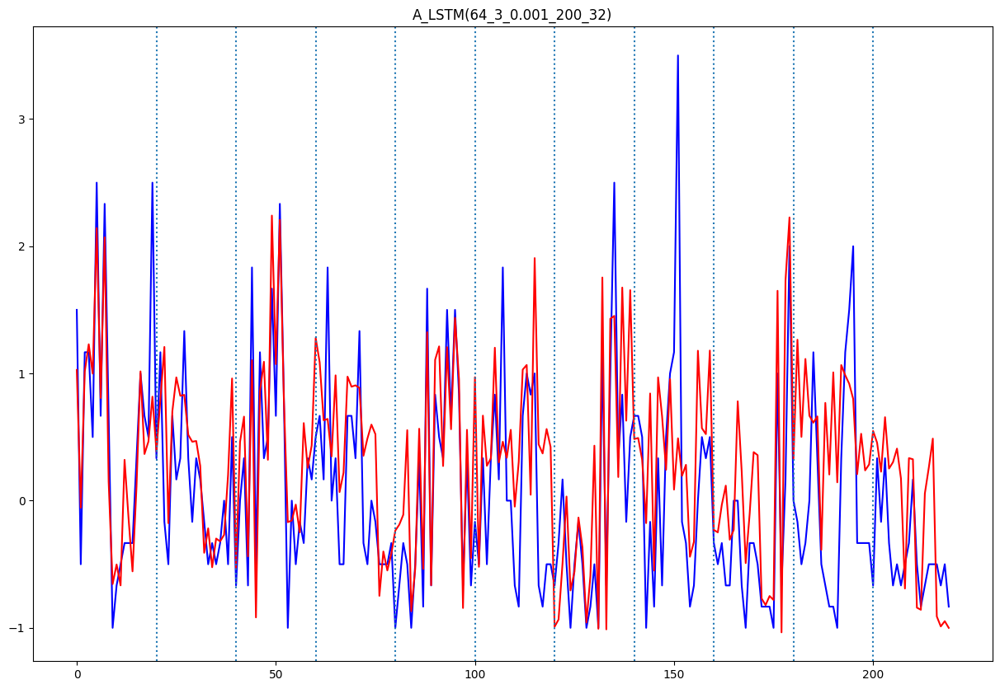

In [ ]:
history = {"case" : [], "model" : [],
           "num_units" : [], "num_layers" : [], "learning_rate" : [], "epochs" : [], "batch_size" : [],
           "mean_mse" : [], "mean_rmse" : []}

case_ = "A"
model_ = "LSTM"

for num_units in num_units_case :
  for num_layers in num_layers_case :
    for learning_rate in learning_rate_case :
      for epochs in epochs_case :
        for batch_size in batch_size_case :
          # 파일 저장용 제목
          title = f"{case_}_{model_}({num_units}_{num_layers}_{learning_rate}_{epochs}_{batch_size})"

          print(f"{title}")

          # 모델 학습
          models = lstm(X_train, y_train,
                      num_units = num_units,
                      num_layers = num_layers,
                      learning_rate = learning_rate,
                      epochs = epochs,
                      batch_size = batch_size)

          # 검증 진행
          mean_mse, mean_rmse = validation(X_test, y_test, models, title)

          # 기록
          history["case"].append(case_)
          history["model"].append(model_)
          history["num_units"].append(num_units)
          history["num_layers"].append(num_layers)
          history["learning_rate"].append(learning_rate)
          history["epochs"].append(epochs)
          history["batch_size"].append(batch_size)
          history["mean_mse"].append(mean_mse)
          history["mean_rmse"].append(mean_rmse)

# 기록 저장
history_df = pd.DataFrame.from_dict(data=history, orient='columns')
history_df.to_csv(f"history_{case_}_{model_}.csv", index=False)

#### 모델 돌리기 (GRU)
- 마지막 줄의 history 저장할 때, 파일명 주의!!! 자기 상황에 맞게 수정하기!!!

A_GRU(64_2_5e-05_100_16)
7/7 [==============================] - 1s 4ms/step
평균 검증 MSE: 0.5556841372310289
평균 검증 RMSE: 0.7454422427197355


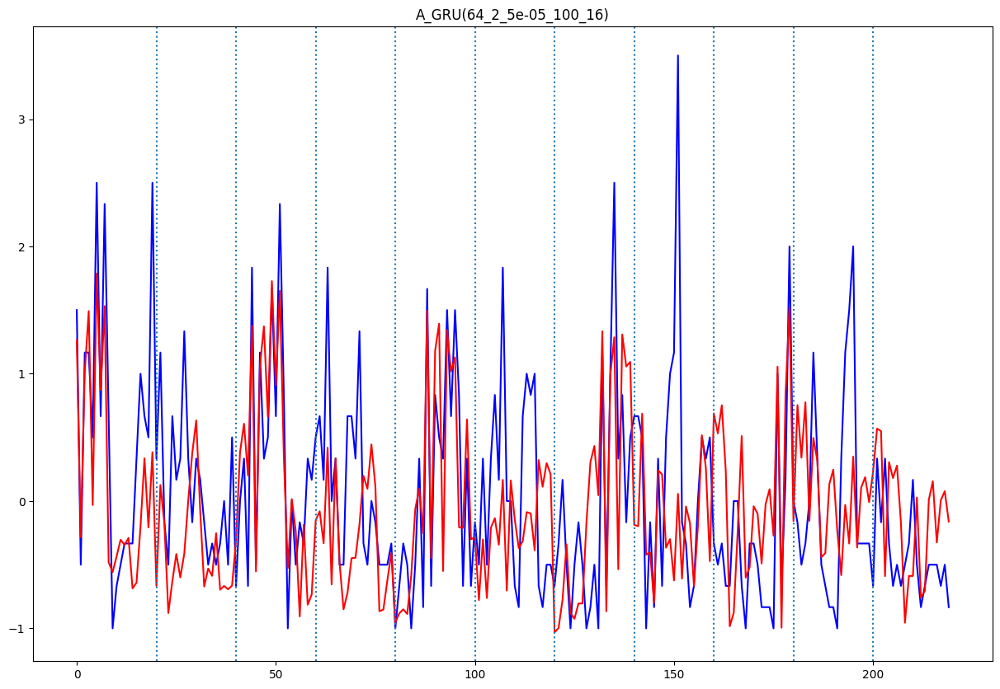

A_GRU(64_2_5e-05_100_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.5917935335012128
평균 검증 RMSE: 0.7692811797393804


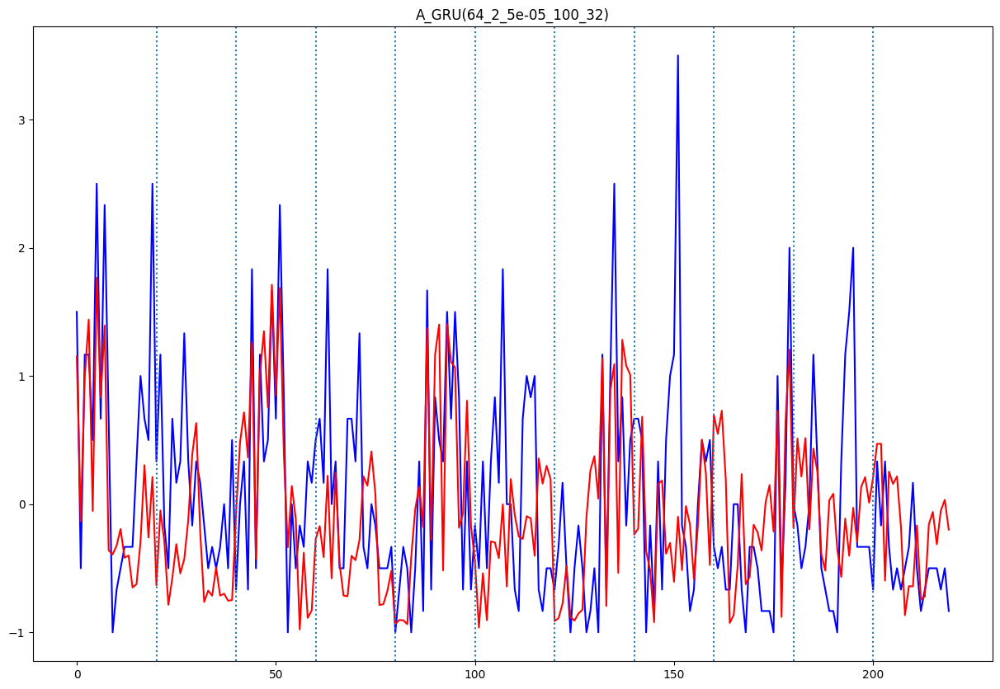

A_GRU(64_2_5e-05_150_16)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.41079694094520525
평균 검증 RMSE: 0.6409344279606185


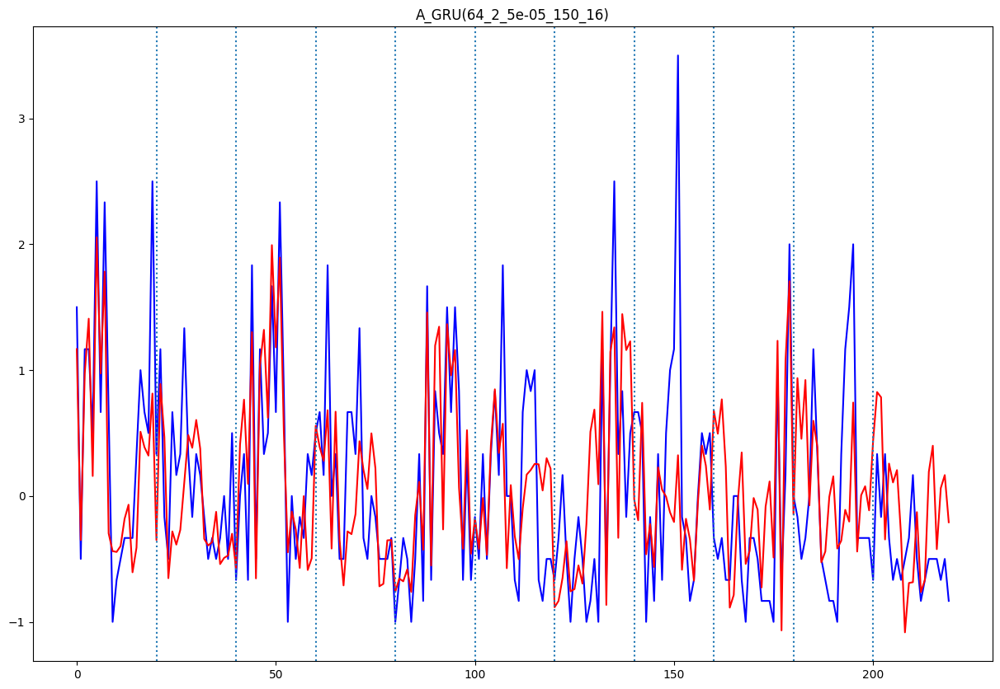

A_GRU(64_2_5e-05_150_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.49983677878818583
평균 검증 RMSE: 0.7069913569402286


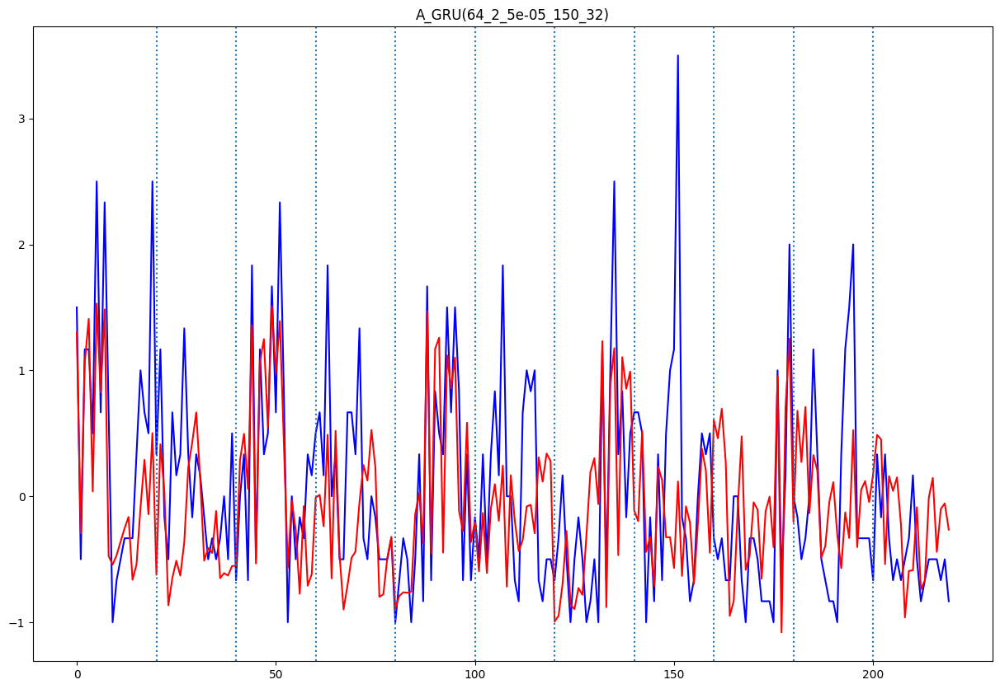

A_GRU(64_2_5e-05_200_16)
7/7 [==============================] - 1s 8ms/step
평균 검증 MSE: 0.3272839868313894
평균 검증 RMSE: 0.5720873944000072


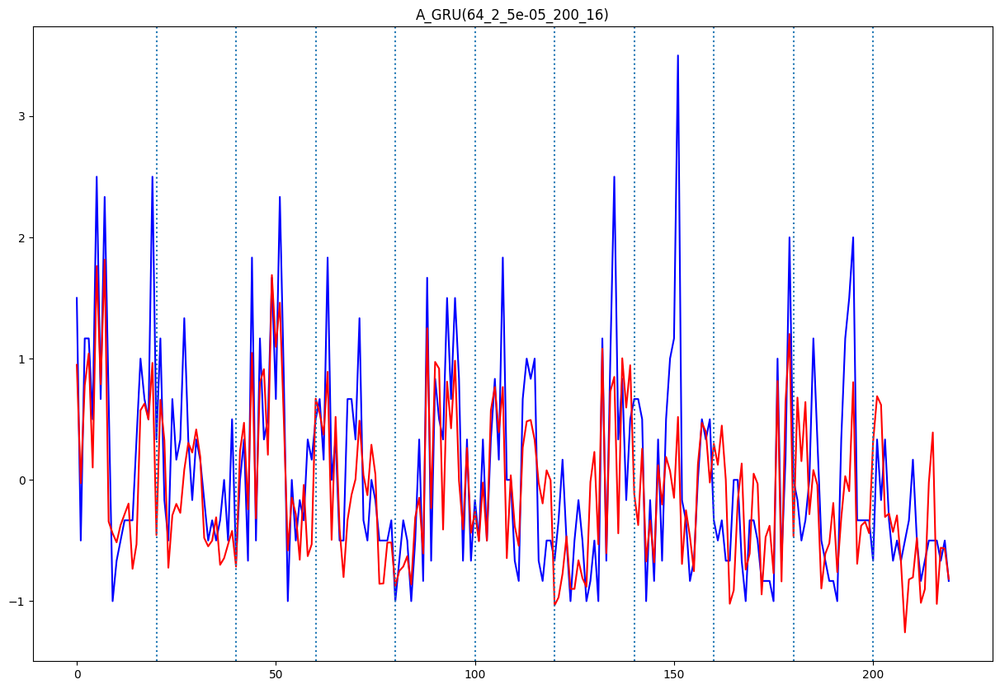

A_GRU(64_2_5e-05_200_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.4112003095002203
평균 검증 RMSE: 0.6412490230013769


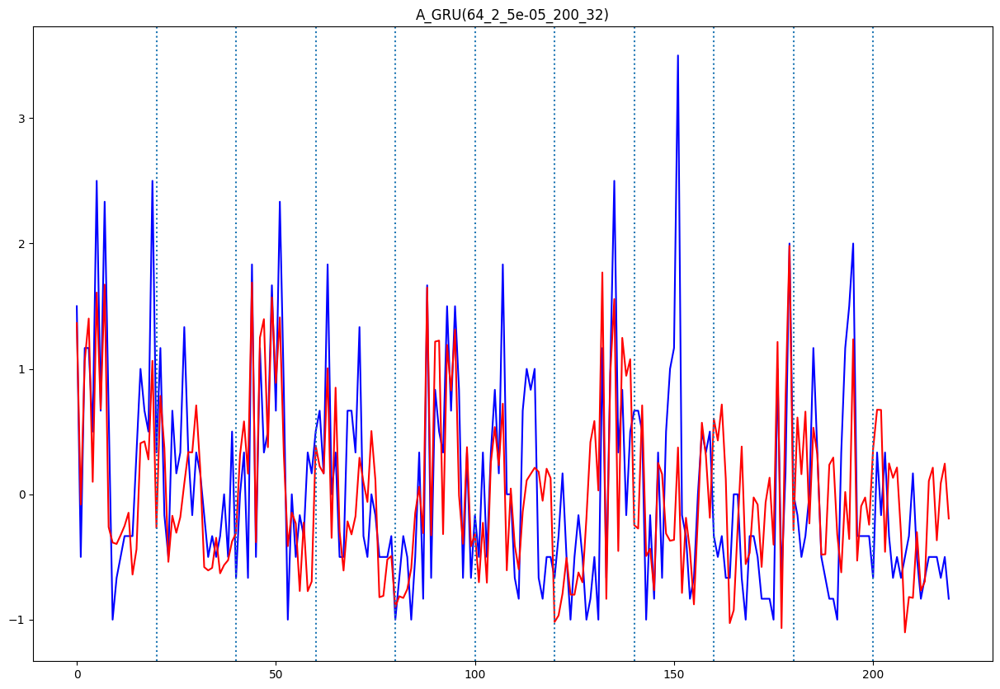

A_GRU(64_2_0.0001_100_16)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.3168536174957698
평균 검증 RMSE: 0.5628975195324366


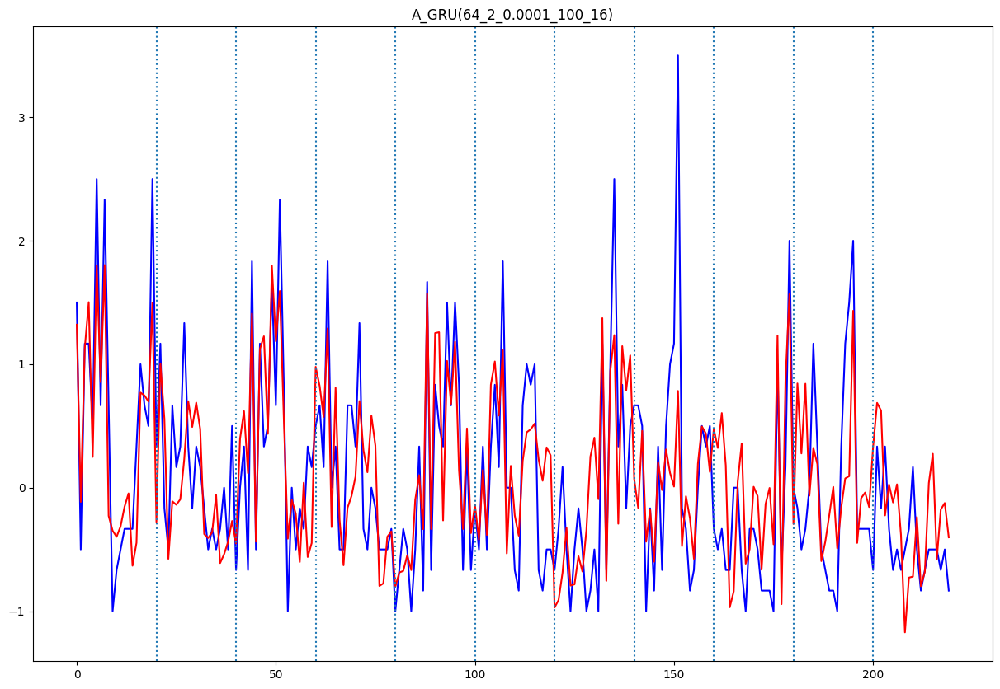

A_GRU(64_2_0.0001_100_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.37314099871918605
평균 검증 RMSE: 0.6108526816828965


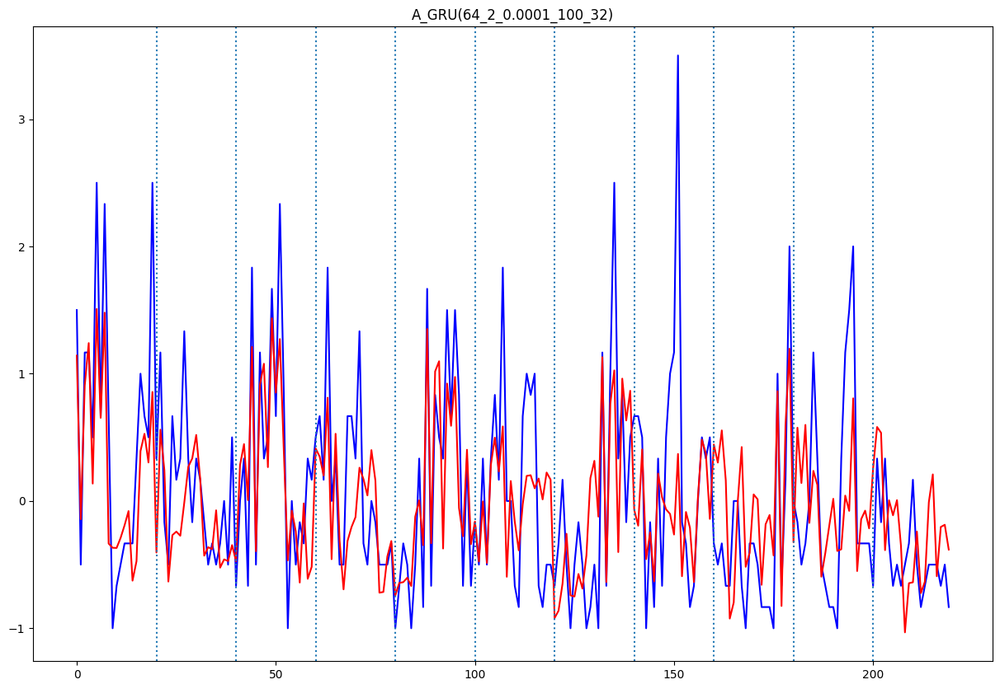

A_GRU(64_2_0.0001_150_16)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.24131762407197563
평균 검증 RMSE: 0.4912409022790912


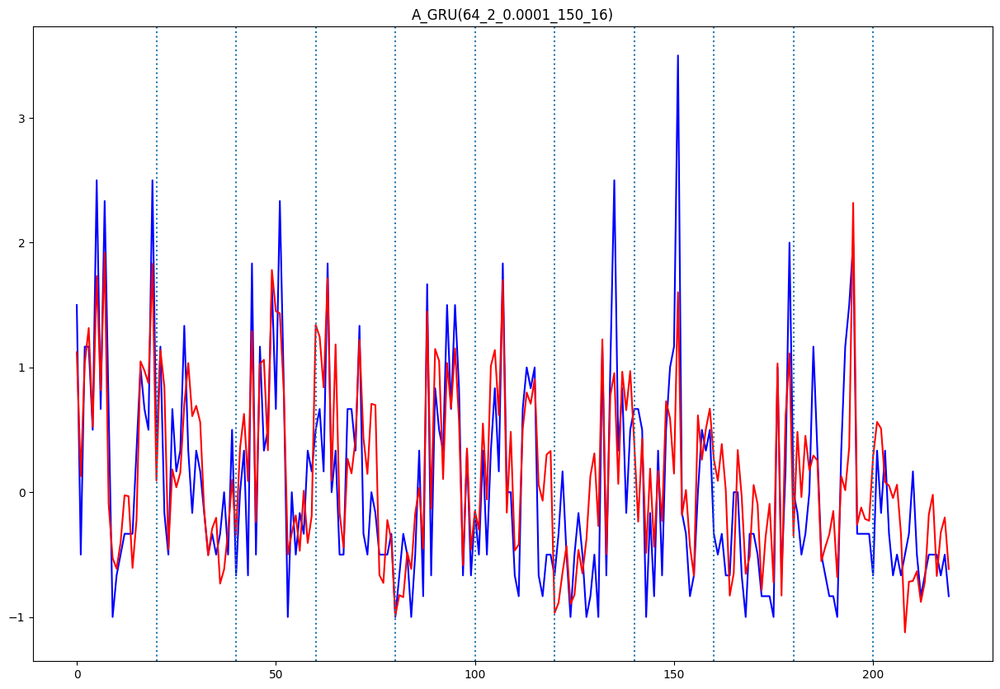

A_GRU(64_2_0.0001_150_32)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.23801948555135943
평균 검증 RMSE: 0.48787240704036483


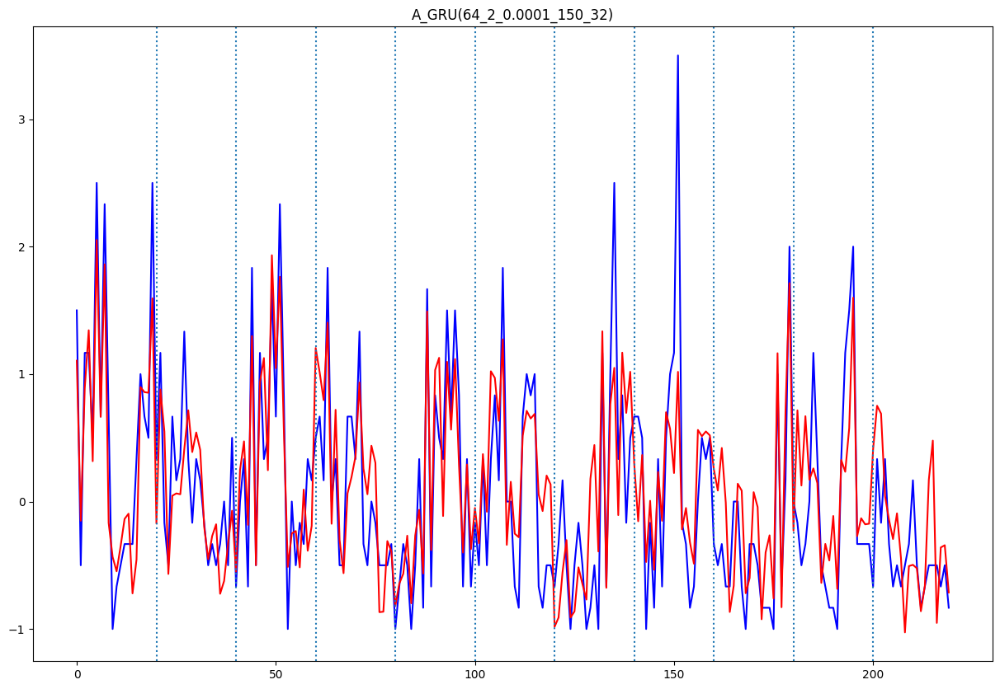

A_GRU(64_2_0.0001_200_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.23466263972774684
평균 검증 RMSE: 0.4844199002185468


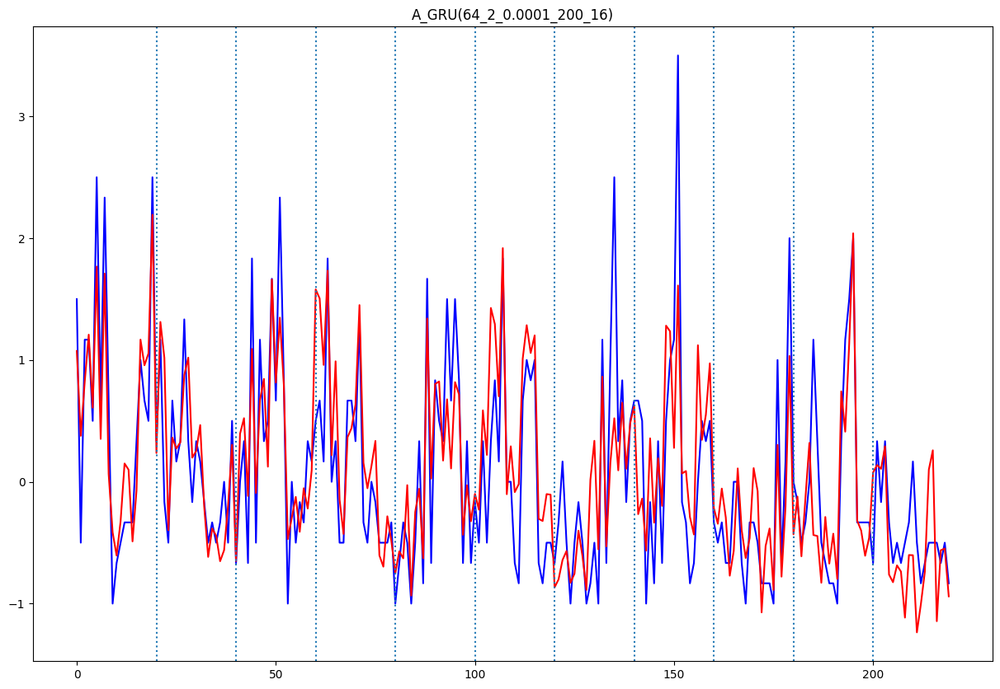

A_GRU(64_2_0.0001_200_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.22951548608227418
평균 검증 RMSE: 0.47907774534231307


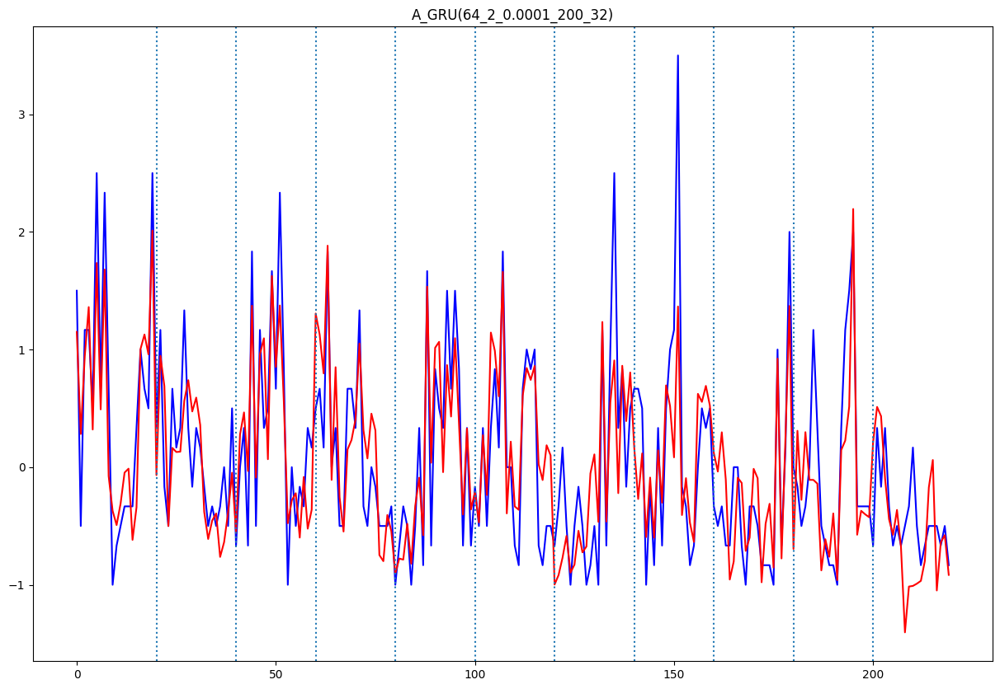

A_GRU(64_2_0.001_100_16)
7/7 [==============================] - 1s 4ms/step
평균 검증 MSE: 0.32815105463862215
평균 검증 RMSE: 0.57284470377112


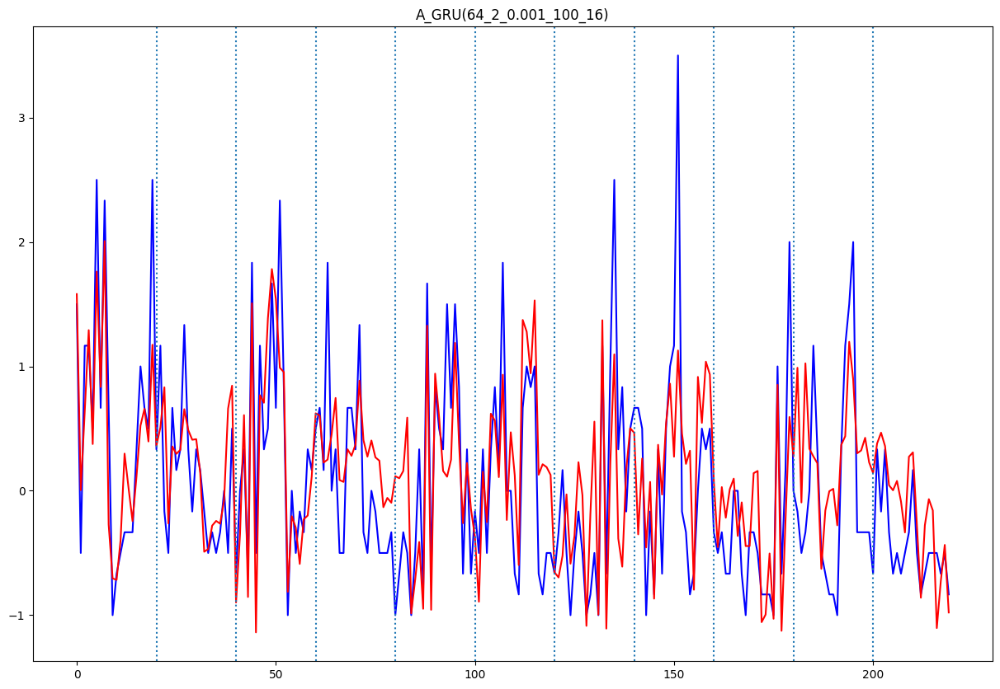

A_GRU(64_2_0.001_100_32)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.3583966379854345
평균 검증 RMSE: 0.5986623739516578


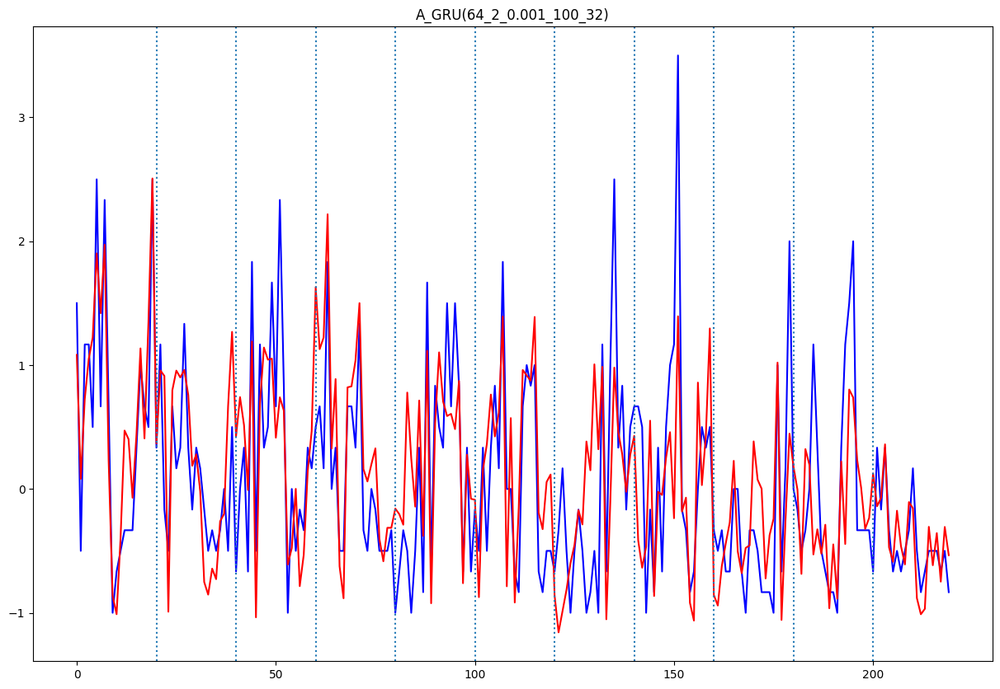

A_GRU(64_2_0.001_150_16)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.40650455039655237
평균 검증 RMSE: 0.6375770936887181


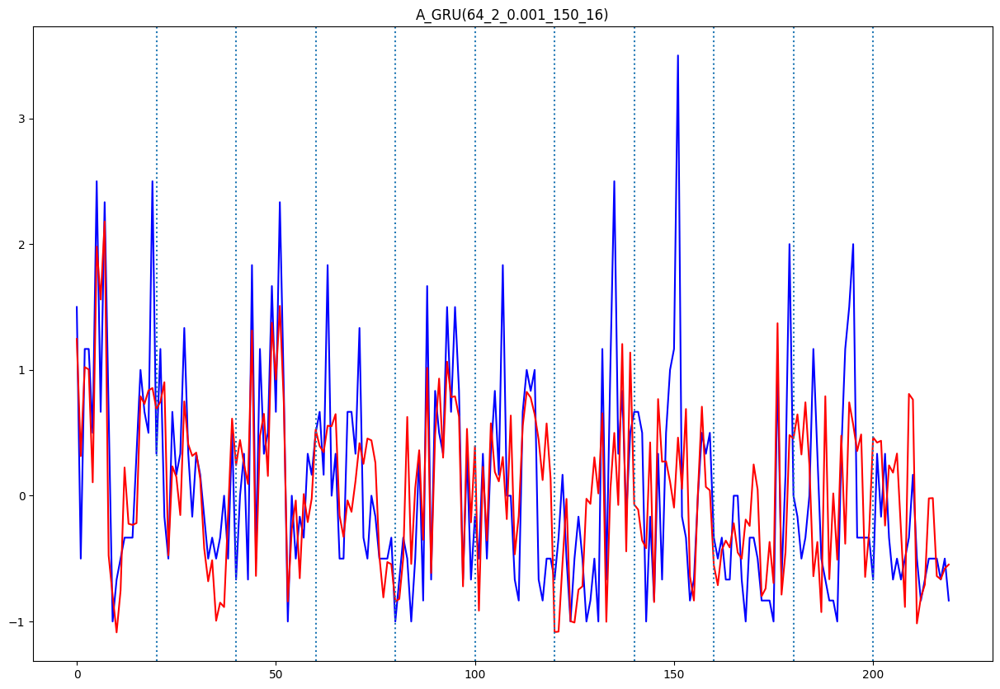

A_GRU(64_2_0.001_150_32)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.31321907065105575
평균 검증 RMSE: 0.5596597811626772


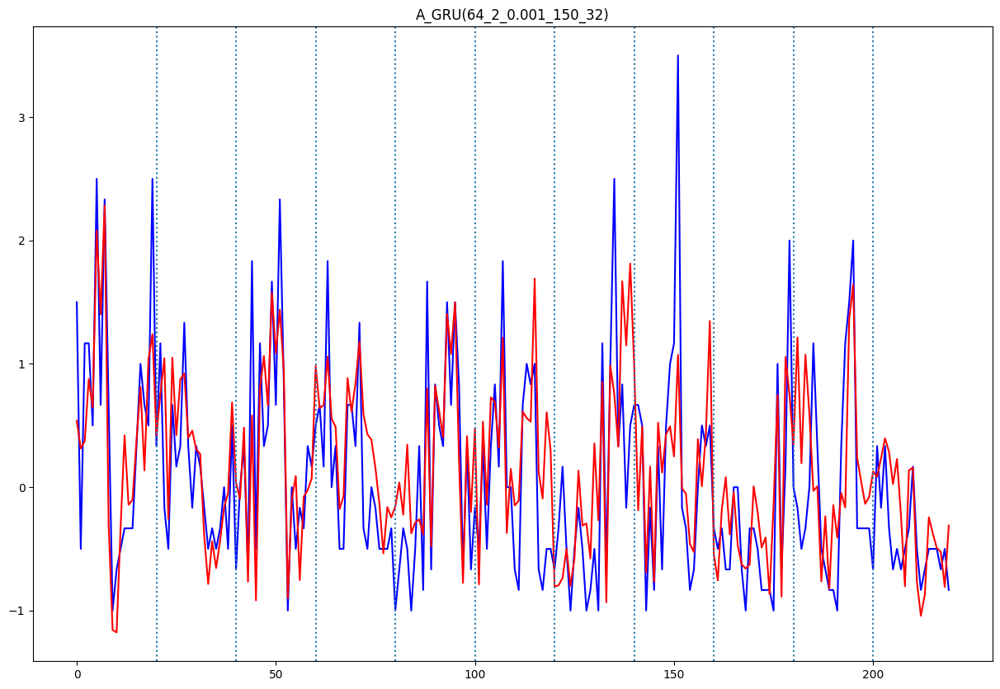

A_GRU(64_2_0.001_200_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.336375426951854
평균 검증 RMSE: 0.5799788159509397


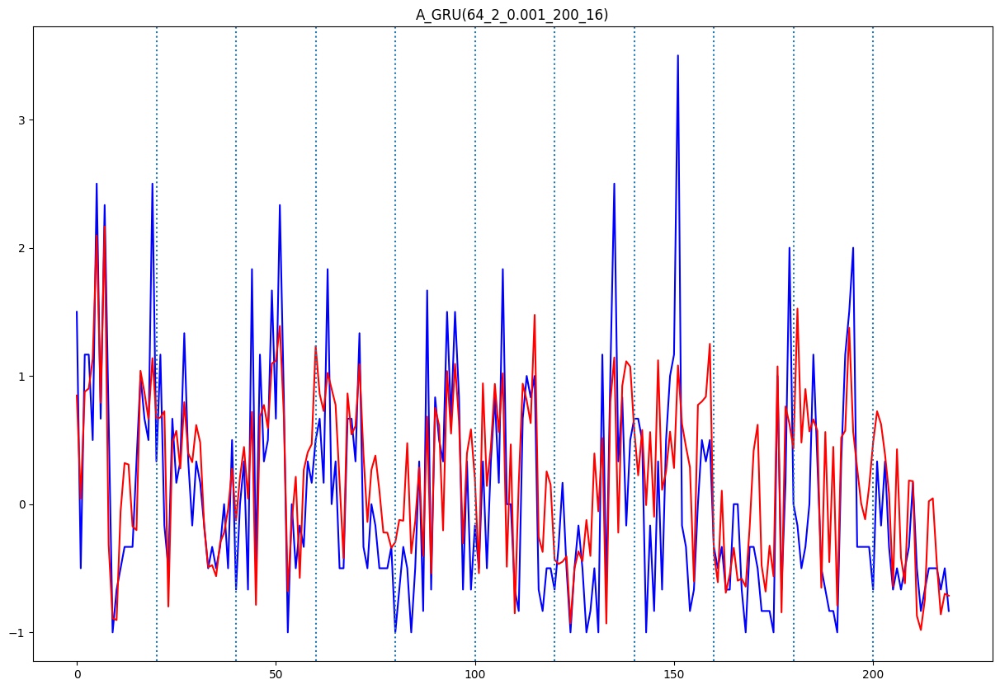

A_GRU(64_2_0.001_200_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.4004178391261162
평균 검증 RMSE: 0.6327857766465016


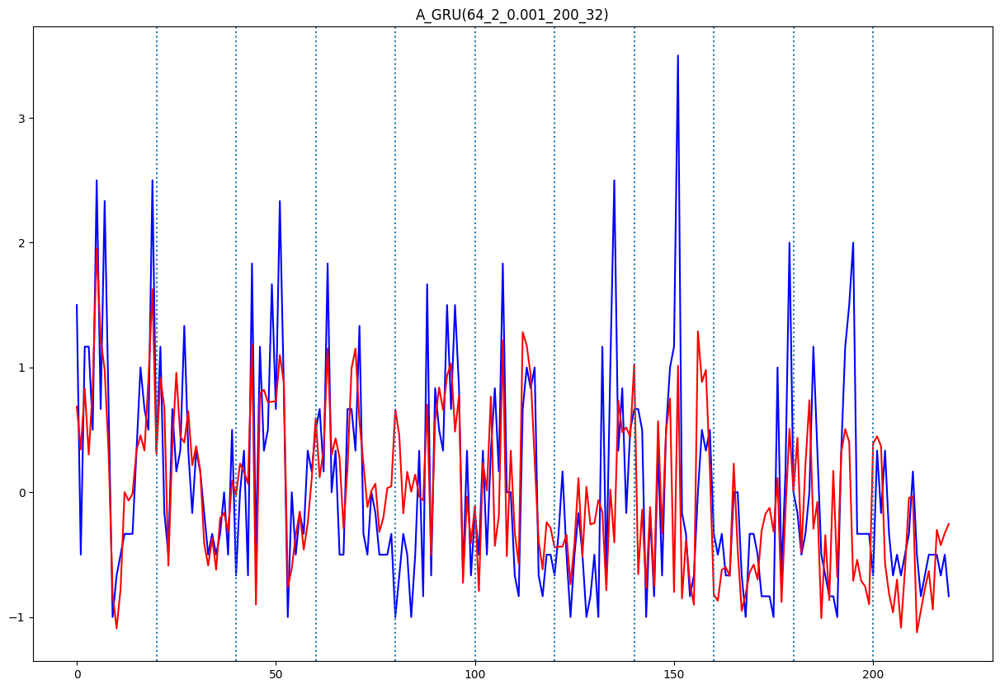

A_GRU(64_3_5e-05_100_16)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.5263688605010206
평균 검증 RMSE: 0.7255128258694126


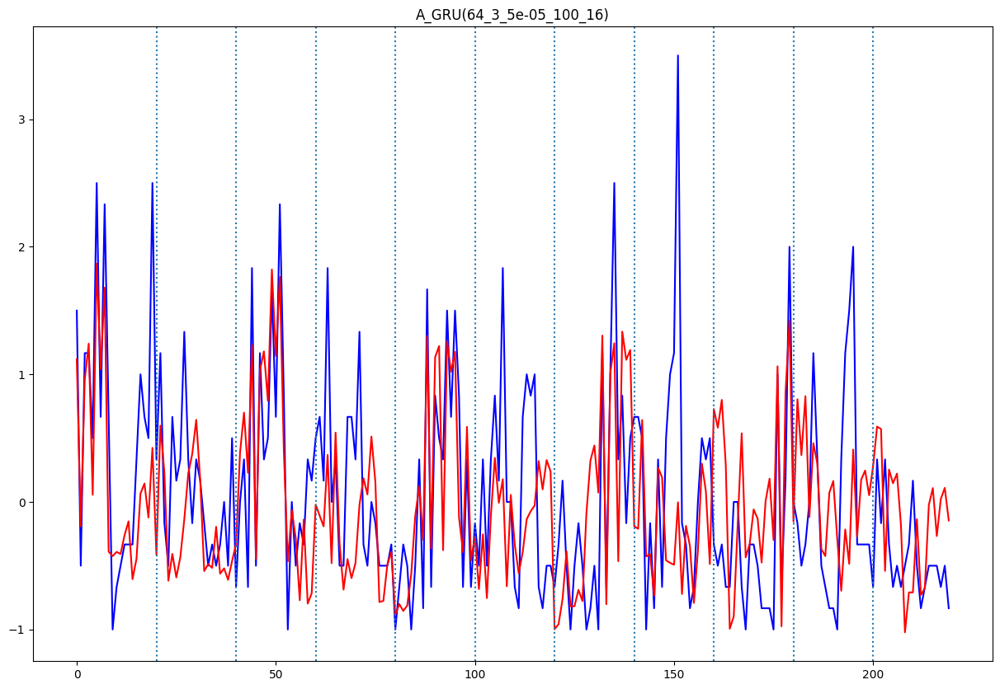

A_GRU(64_3_5e-05_100_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.5955616756485181
평균 검증 RMSE: 0.7717264253921322


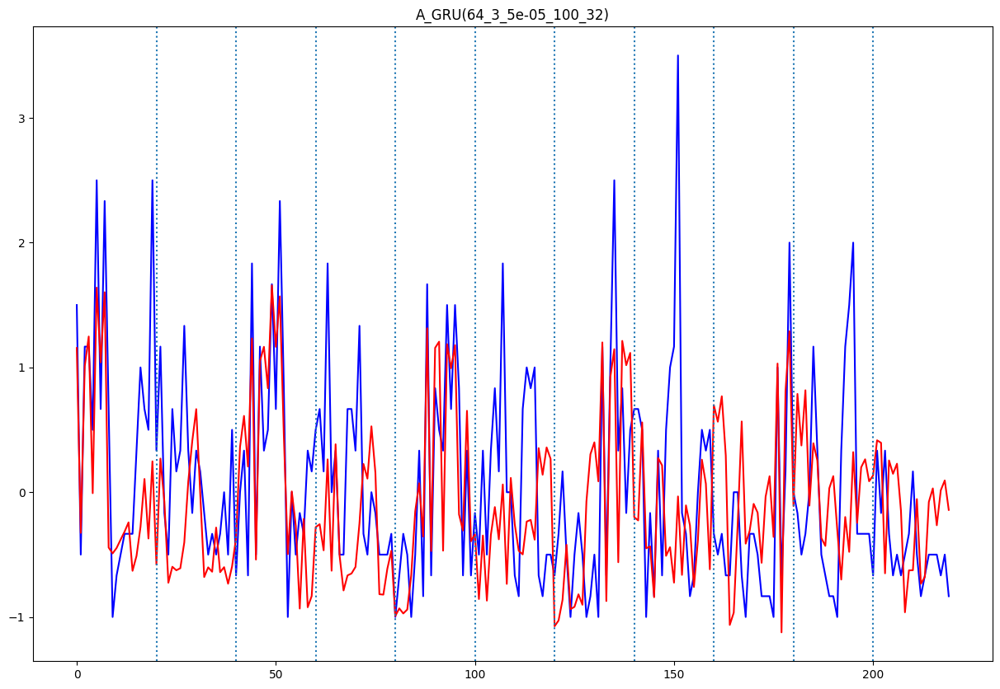

A_GRU(64_3_5e-05_150_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.3962462394600032
평균 검증 RMSE: 0.6294809285911712


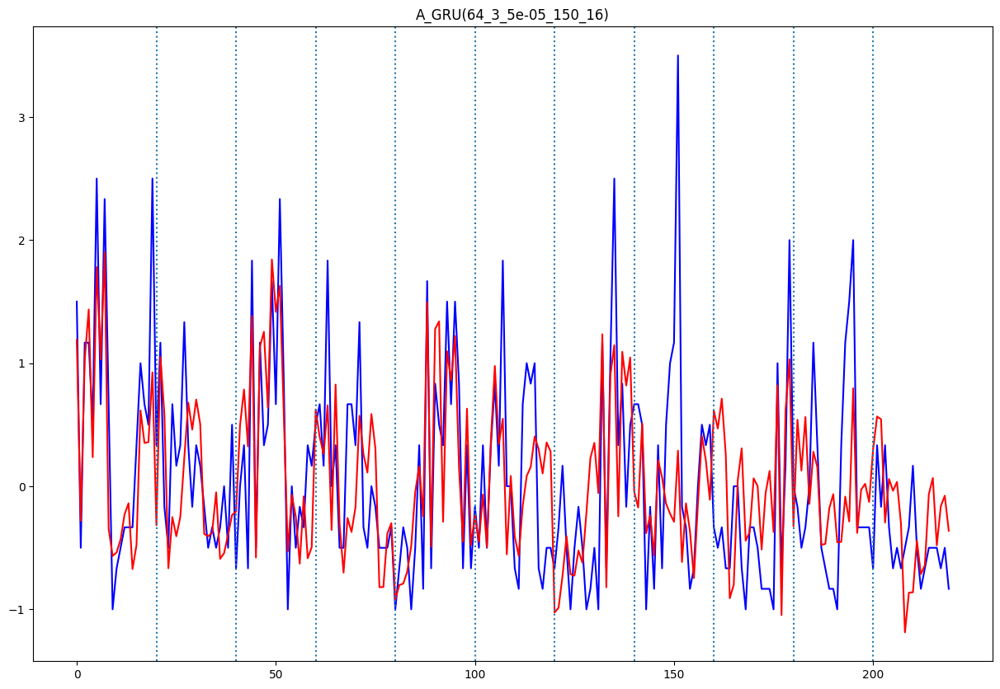

A_GRU(64_3_5e-05_150_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.48634142106561984
평균 검증 RMSE: 0.6973818330481658


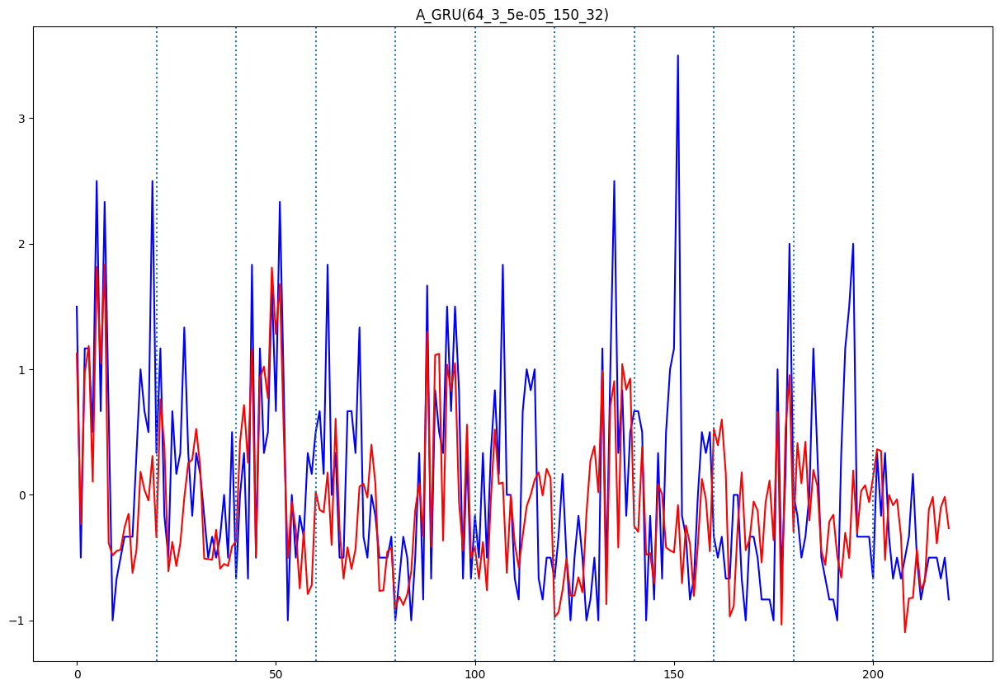

A_GRU(64_3_5e-05_200_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.3422967456233598
평균 검증 RMSE: 0.585061317832037


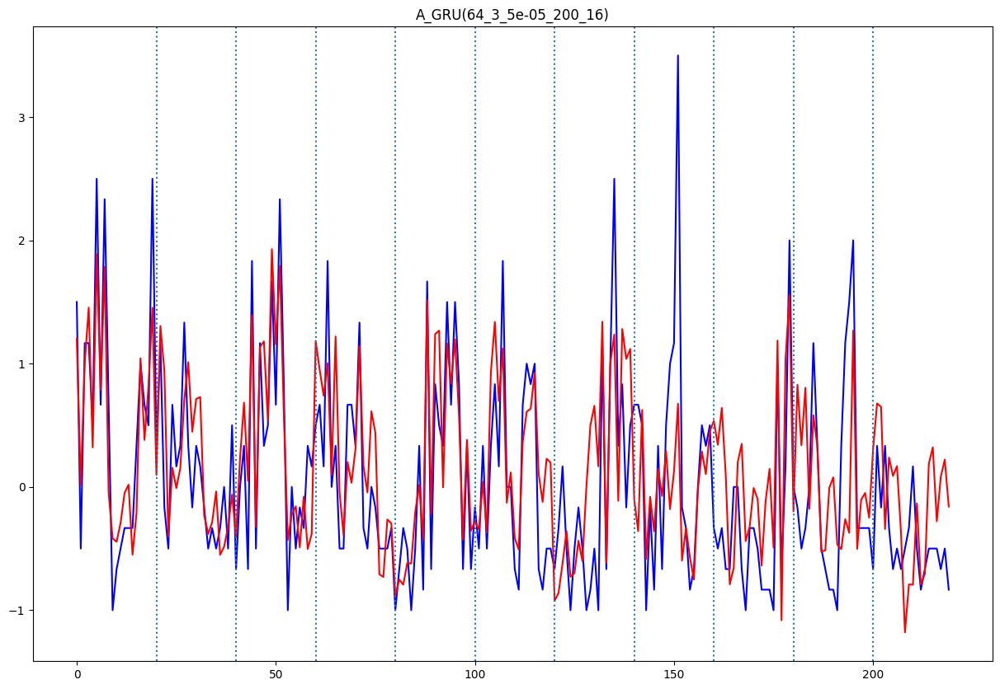

A_GRU(64_3_5e-05_200_32)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.472395780135132
평균 검증 RMSE: 0.6873105412658328


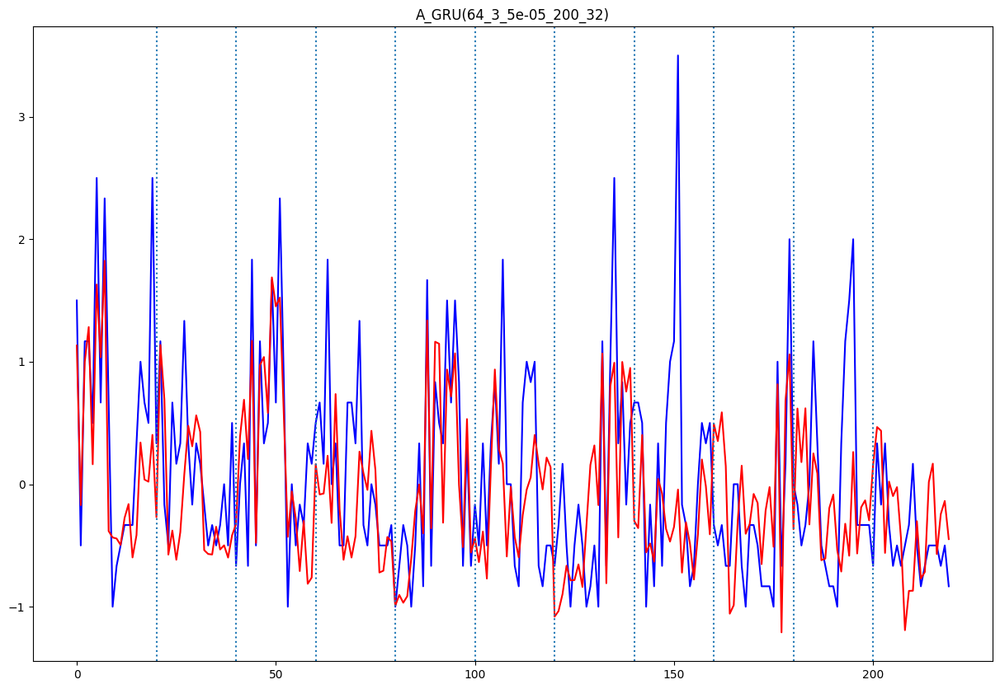

A_GRU(64_3_0.0001_100_16)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.27030816525715645
평균 검증 RMSE: 0.5199116898639196


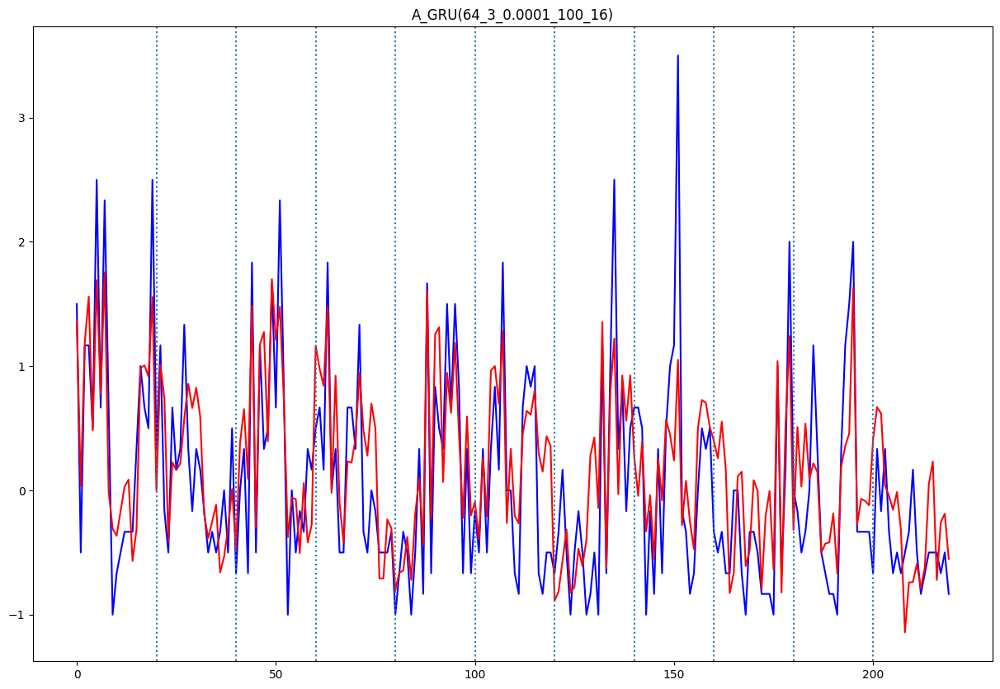

A_GRU(64_3_0.0001_100_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.44302057723355664
평균 검증 RMSE: 0.6655979095772137


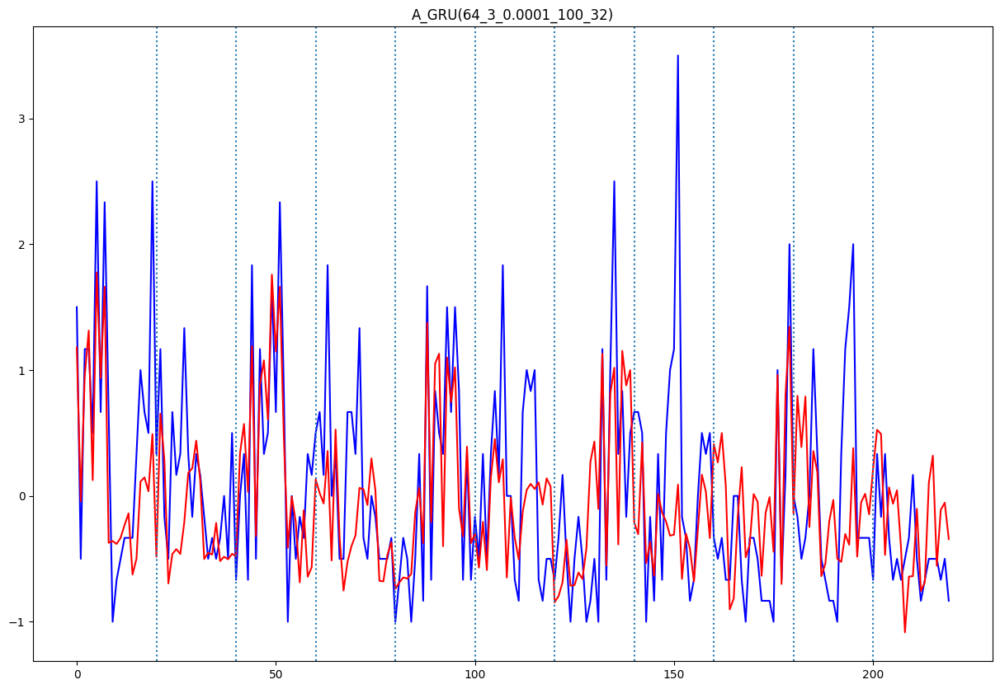

A_GRU(64_3_0.0001_150_16)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.3302771900038531
평균 검증 RMSE: 0.5746974769423067


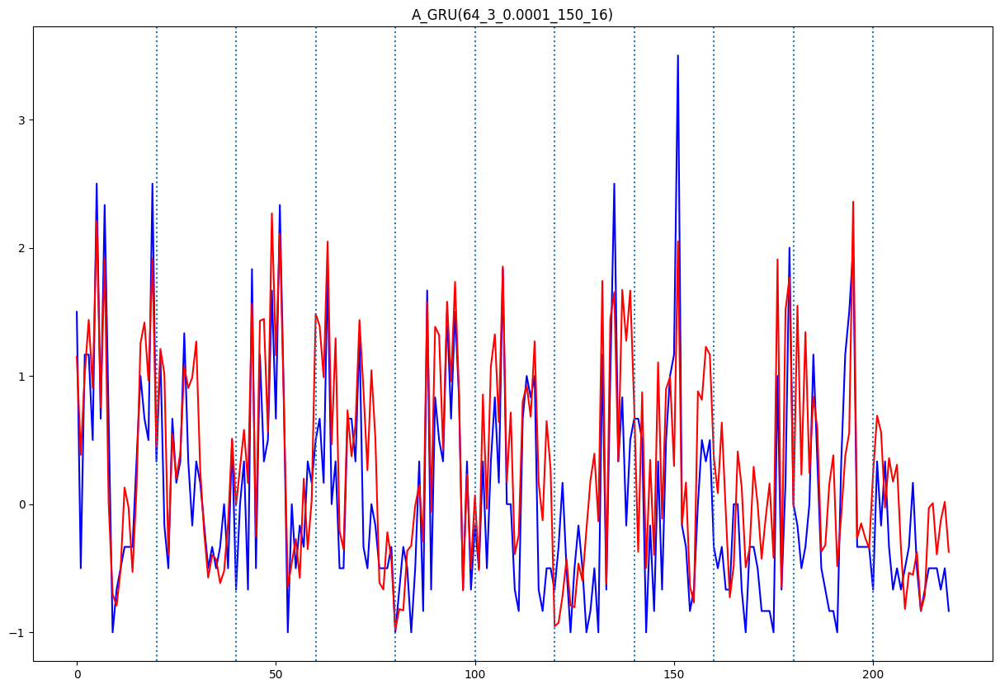

A_GRU(64_3_0.0001_150_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.257942631180479
평균 검증 RMSE: 0.5078805284517994


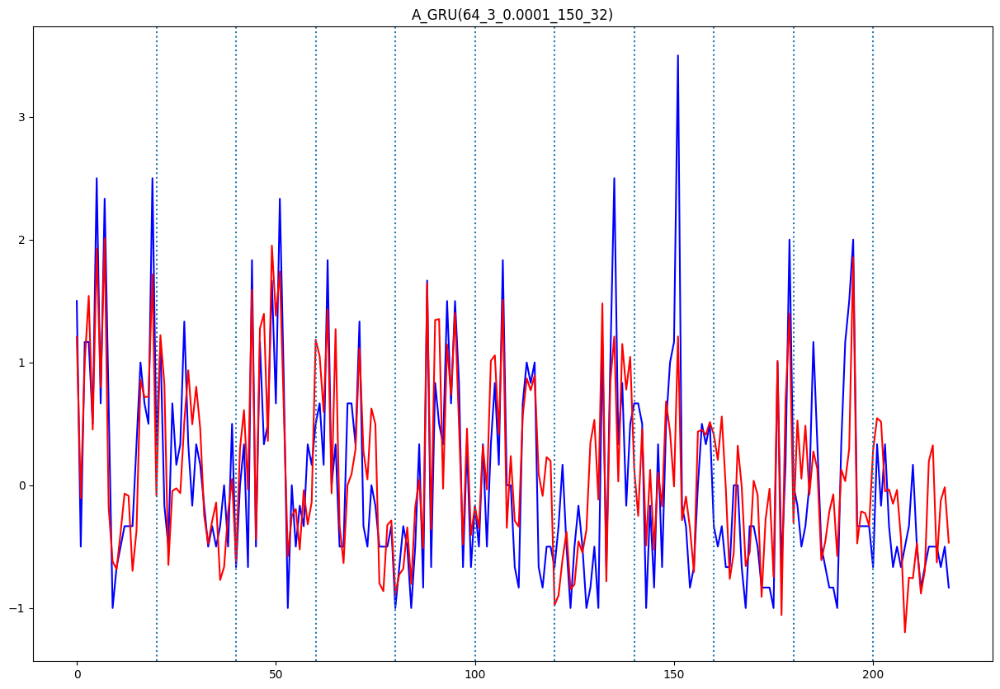

A_GRU(64_3_0.0001_200_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.3359652030826143
평균 검증 RMSE: 0.5796250538776031


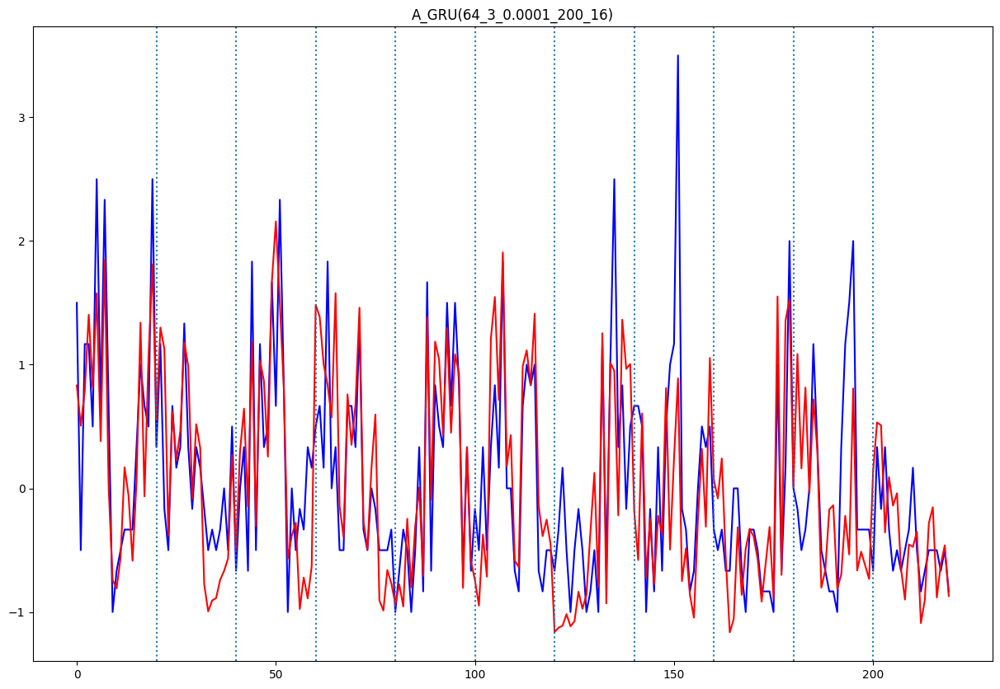

A_GRU(64_3_0.0001_200_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.21625535898219642
평균 검증 RMSE: 0.4650326429211141


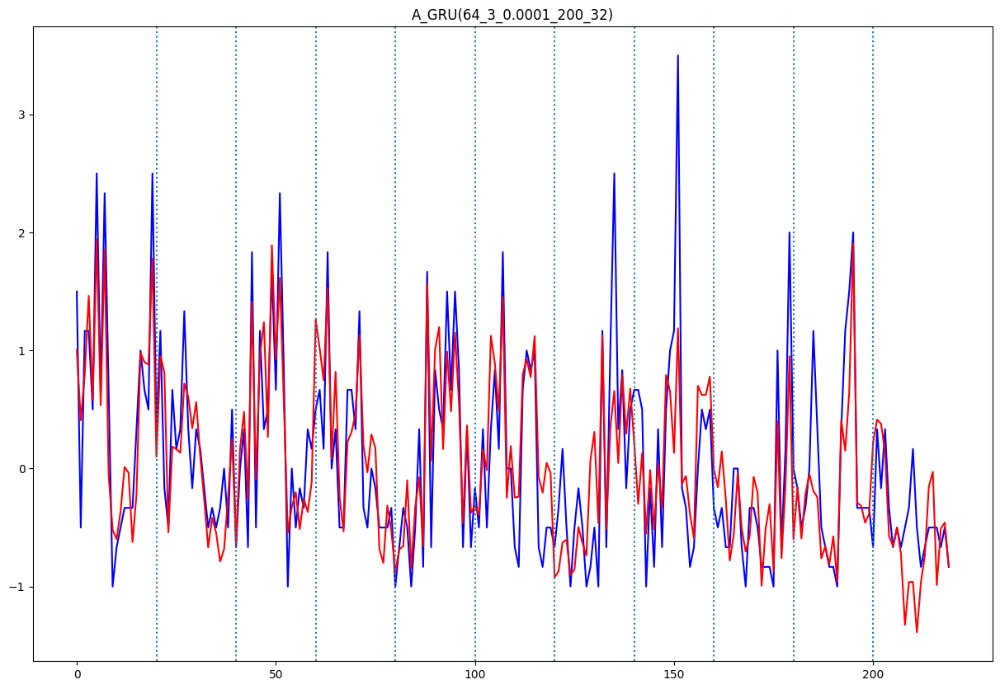

A_GRU(64_3_0.001_100_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.23764713433893758
평균 검증 RMSE: 0.4874906505143843


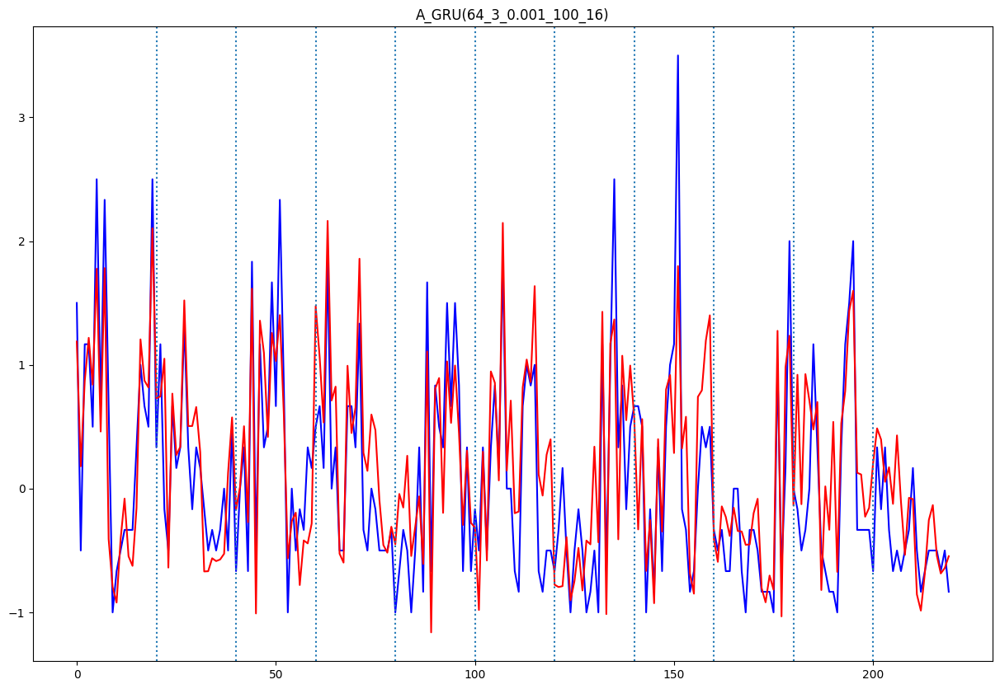

A_GRU(64_3_0.001_100_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.31817412440375586
평균 검증 RMSE: 0.5640692549711922


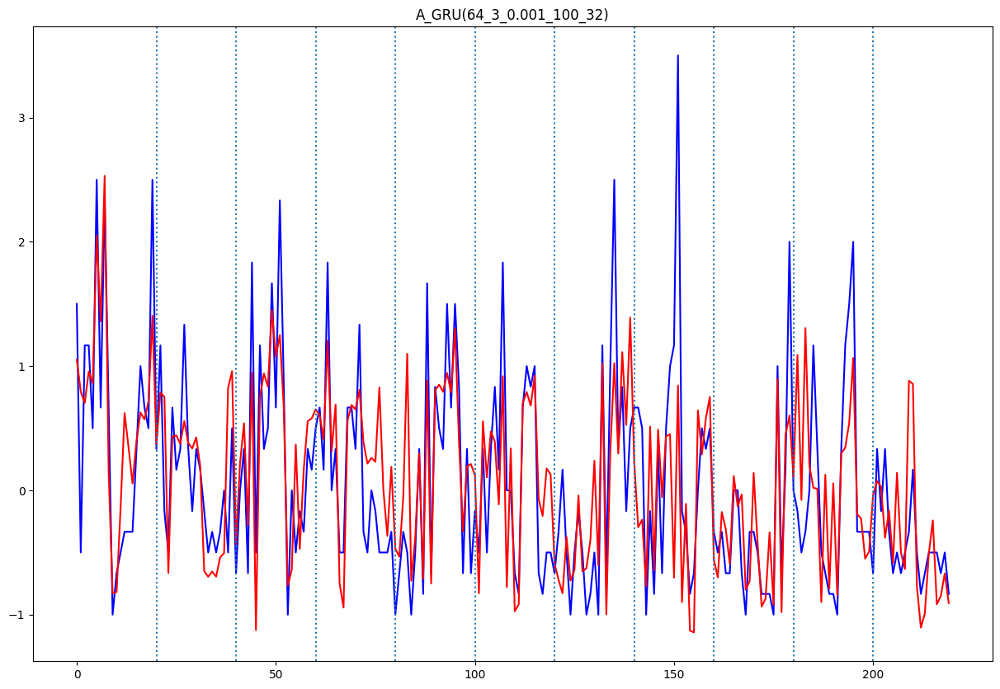

A_GRU(64_3_0.001_150_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.32810010834261616
평균 검증 RMSE: 0.572800234237571


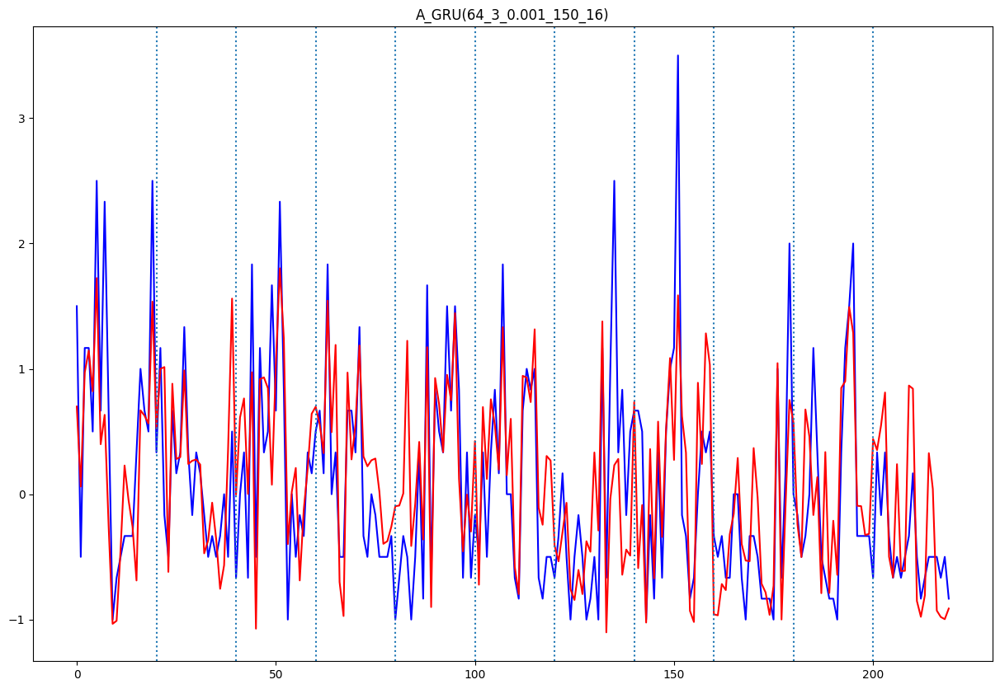

A_GRU(64_3_0.001_150_32)
7/7 [==============================] - 1s 8ms/step
평균 검증 MSE: 0.3133624597986579
평균 검증 RMSE: 0.5597878703568504


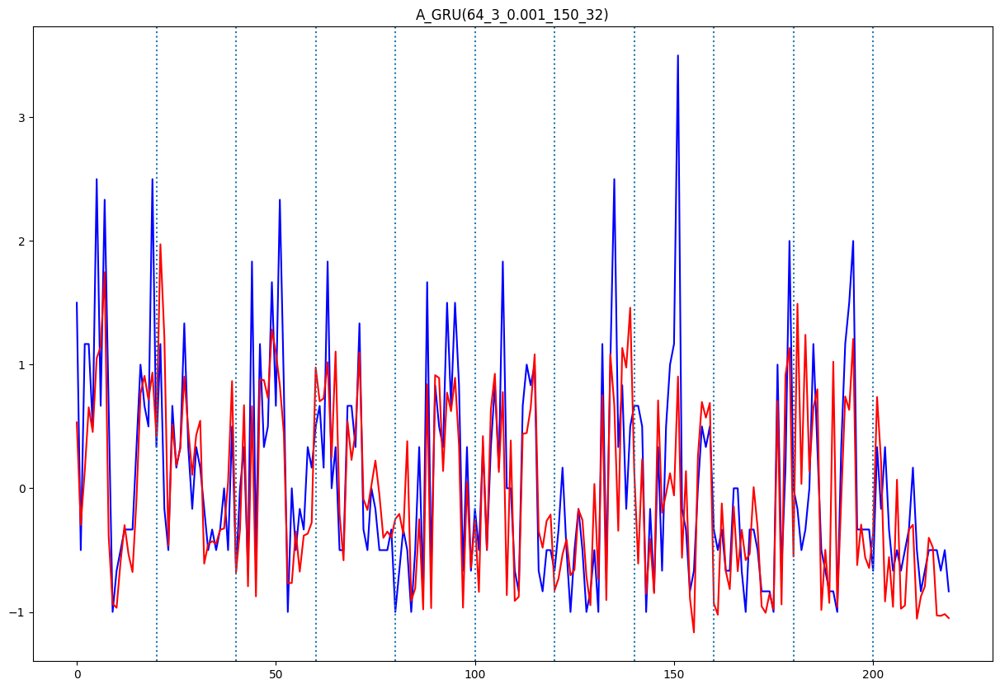

A_GRU(64_3_0.001_200_16)
7/7 [==============================] - 3s 6ms/step
평균 검증 MSE: 0.3119199371121629
평균 검증 RMSE: 0.5584979293714194


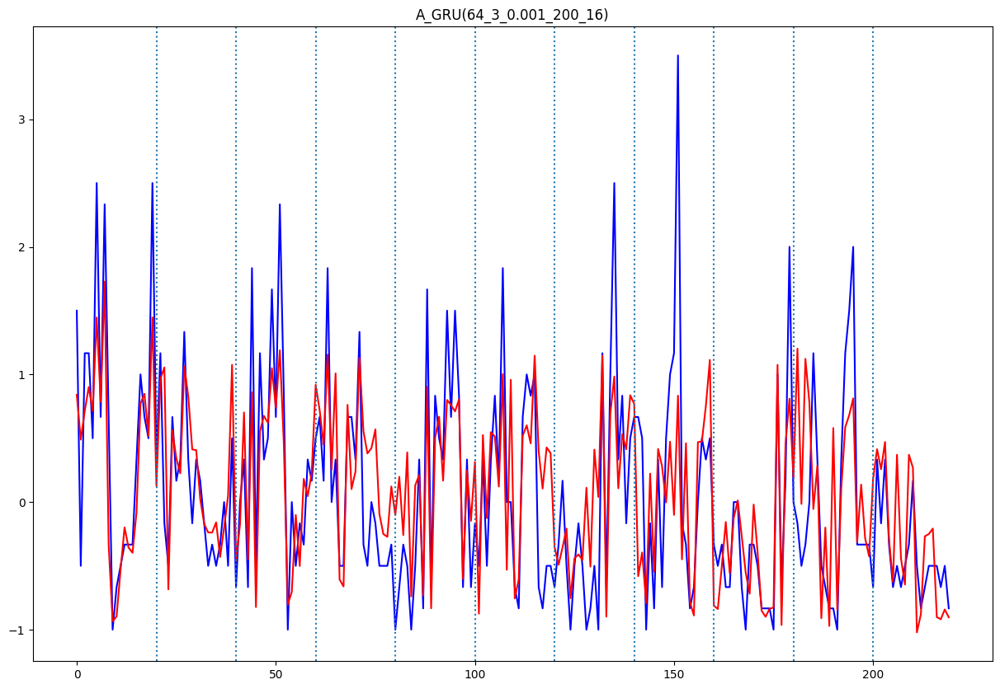

A_GRU(64_3_0.001_200_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.2801070468392162
평균 검증 RMSE: 0.5292514023025505


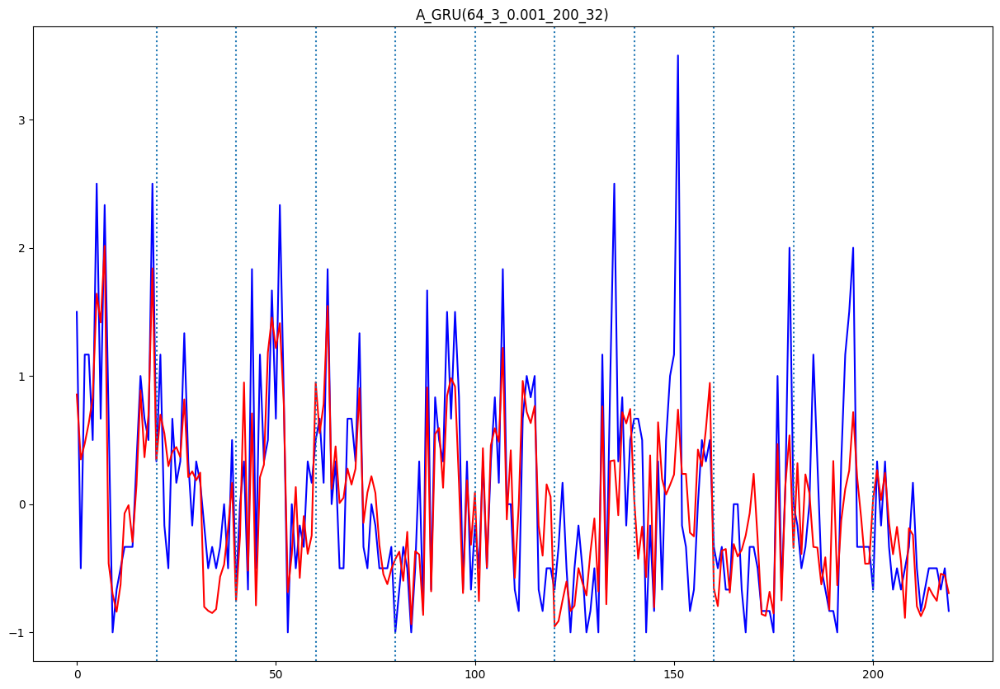

In [ ]:
history = {"case" : [], "model" : [],
           "num_units" : [], "num_layers" : [], "learning_rate" : [], "epochs" : [], "batch_size" : [],
           "mean_mse" : [], "mean_rmse" : []}

case_ = "A"
model_ = "GRU"

for num_units in num_units_case :
  for num_layers in num_layers_case :
    for learning_rate in learning_rate_case :
      for epochs in epochs_case :
        for batch_size in batch_size_case :
          # 파일 저장용 제목
          title = f"{case_}_{model_}({num_units}_{num_layers}_{learning_rate}_{epochs}_{batch_size})"

          print(f"{title}")

          # 모델 학습
          models = gru(X_train, y_train,
                      num_units = num_units,
                      num_layers = num_layers,
                      learning_rate = learning_rate,
                      epochs = epochs,
                      batch_size = batch_size)

          # 검증 진행
          mean_mse, mean_rmse = validation(X_test, y_test, models, title)

          # 기록
          history["case"].append(case_)
          history["model"].append(model_)
          history["num_units"].append(num_units)
          history["num_layers"].append(num_layers)
          history["learning_rate"].append(learning_rate)
          history["epochs"].append(epochs)
          history["batch_size"].append(batch_size)
          history["mean_mse"].append(mean_mse)
          history["mean_rmse"].append(mean_rmse)

# 기록 저장
history_df = pd.DataFrame.from_dict(data=history, orient='columns')
history_df.to_csv(f"history_{case_}_{model_}.csv", index=False)

### B case 코드 실행

#### 데이터 불러오기 및 split

In [ ]:
df = pd.read_csv("/최최종데이터_b_지난주추가.csv")
df.sort_values(by=["id", "week", "obj_num"], inplace=True)

columns = df.columns[4:]

X_train, y_train, X_test, y_test = scaling_train_test_split(df, columns)

#### 모델 돌리기 (LSTM)
- 마지막 줄의 history 저장할 때, 파일명 주의!!! 자기 상황에 맞게 수정하기!!!

B_LSTM(64_2_5e-05_100_16)
7/7 [==============================] - 1s 4ms/step
평균 검증 MSE: 0.6253966745167645
평균 검증 RMSE: 0.7908202542403454


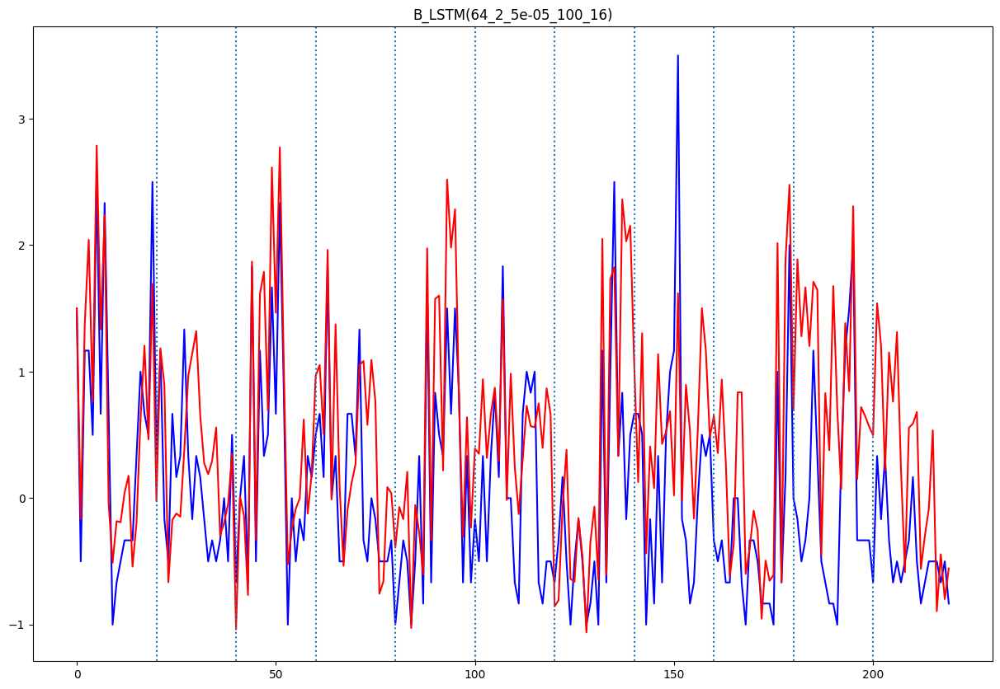

B_LSTM(64_2_5e-05_100_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.5245058687369917
평균 검증 RMSE: 0.7242277740717983


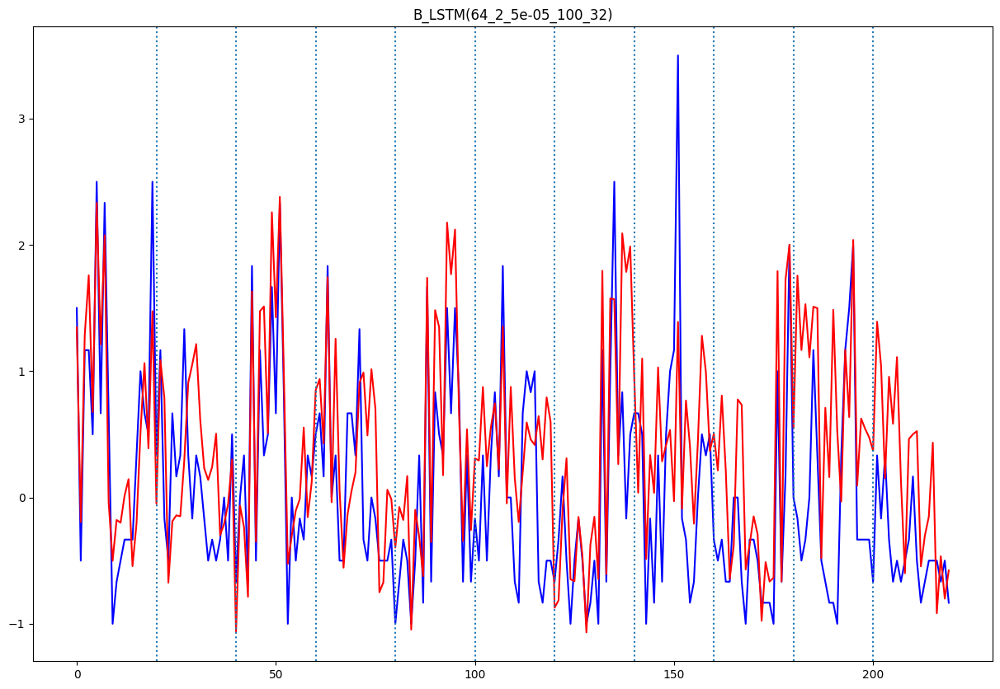

B_LSTM(64_2_5e-05_150_16)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.49447277324621086
평균 검증 RMSE: 0.7031875804123754


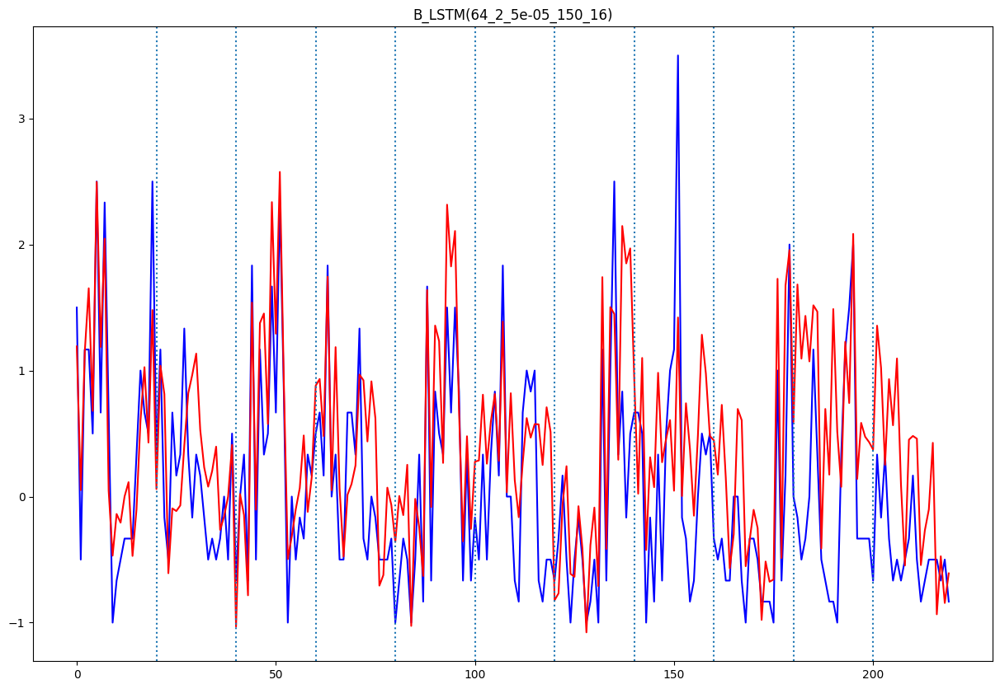

B_LSTM(64_2_5e-05_150_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.3711345928272722
평균 검증 RMSE: 0.609208168713513


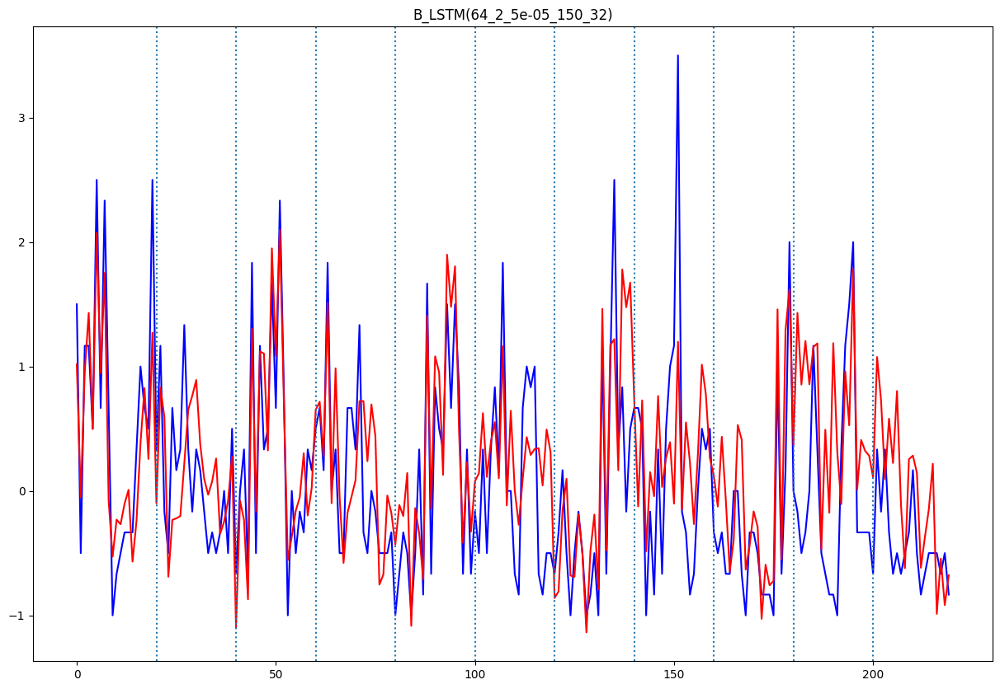

B_LSTM(64_2_5e-05_200_16)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.5571365502255143
평균 검증 RMSE: 0.7464158025025424


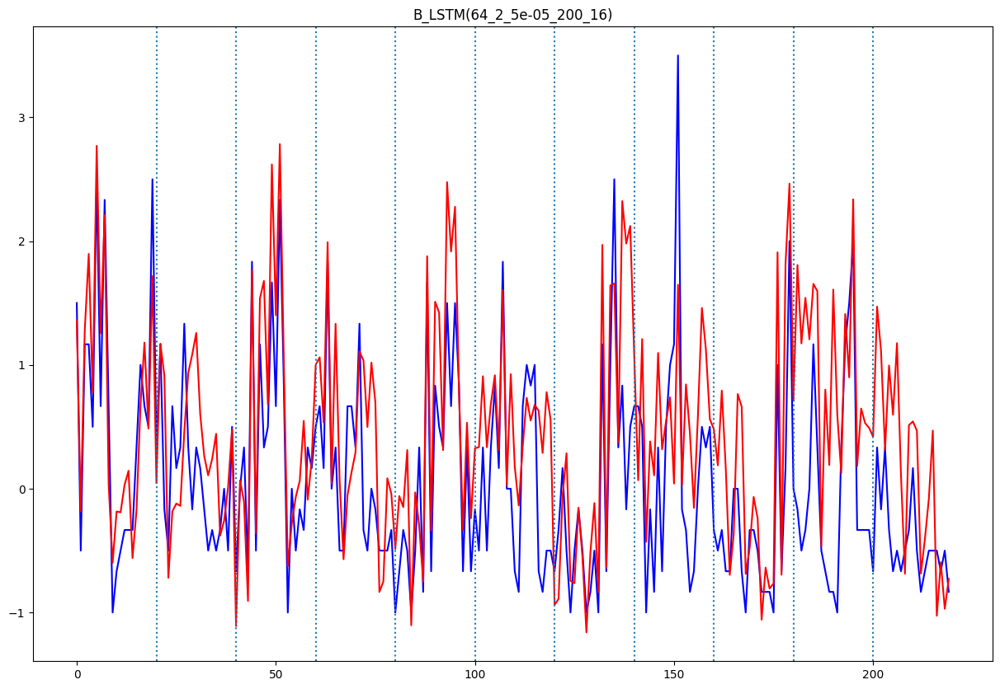

B_LSTM(64_2_5e-05_200_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.41725900025647744
평균 검증 RMSE: 0.645955881044888


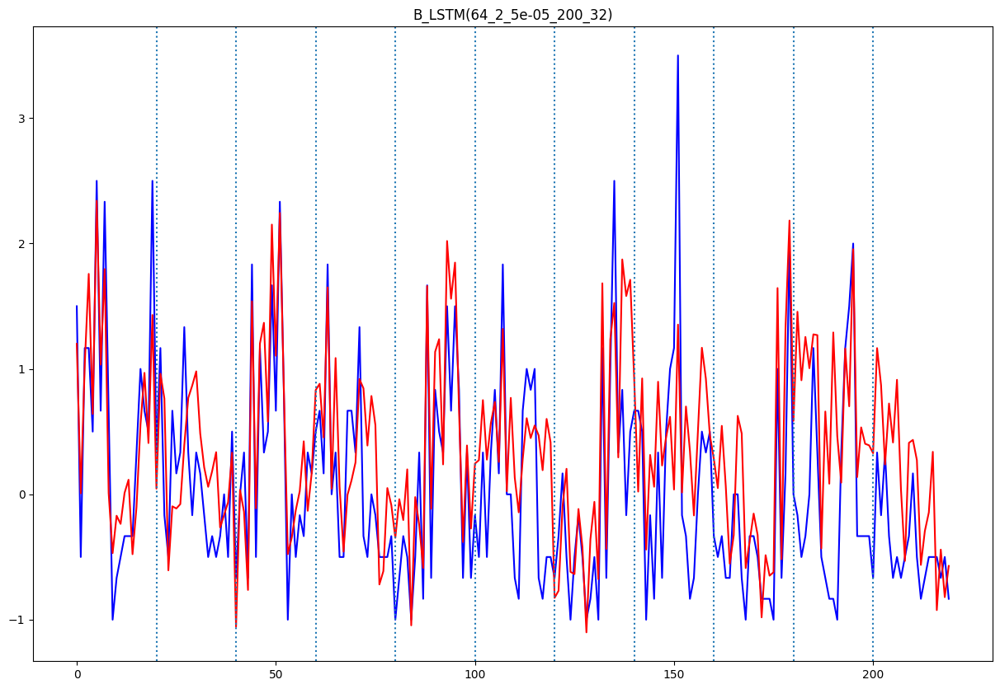

B_LSTM(64_2_0.0001_100_16)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.6430281780112642
평균 검증 RMSE: 0.801890377801894


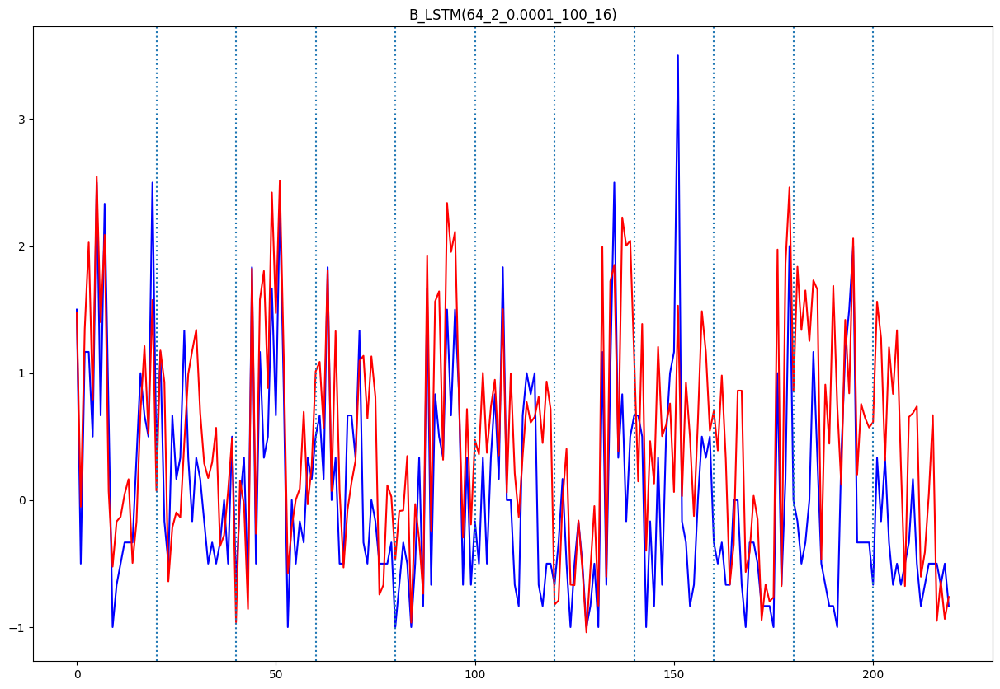

B_LSTM(64_2_0.0001_100_32)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.6087511695842638
평균 검증 RMSE: 0.780225076233944


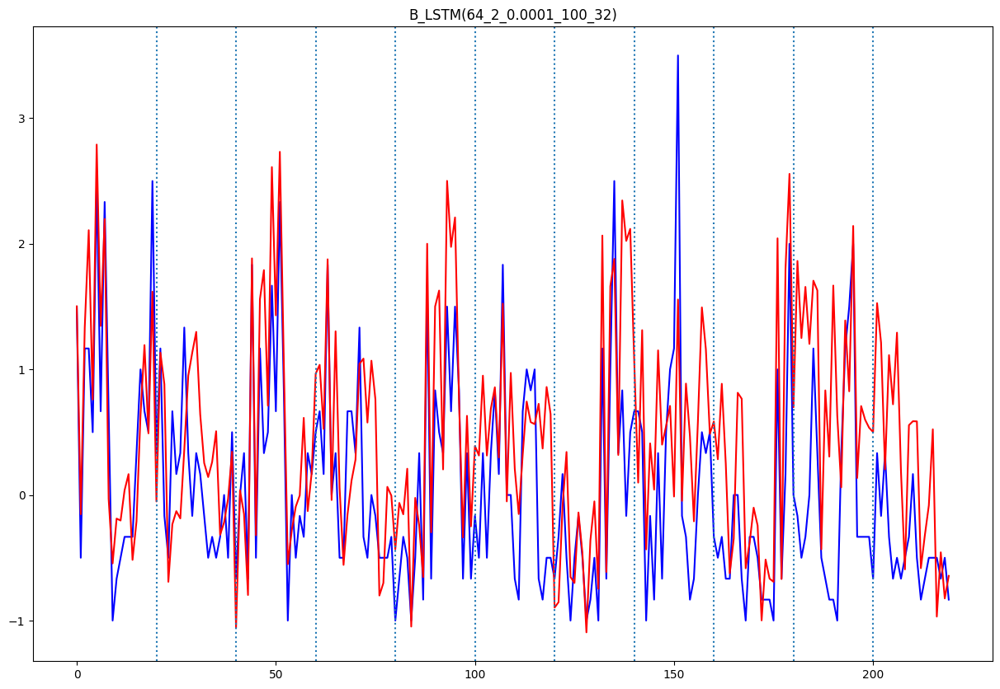

B_LSTM(64_2_0.0001_150_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.45959642225103375
평균 검증 RMSE: 0.6779354115629554


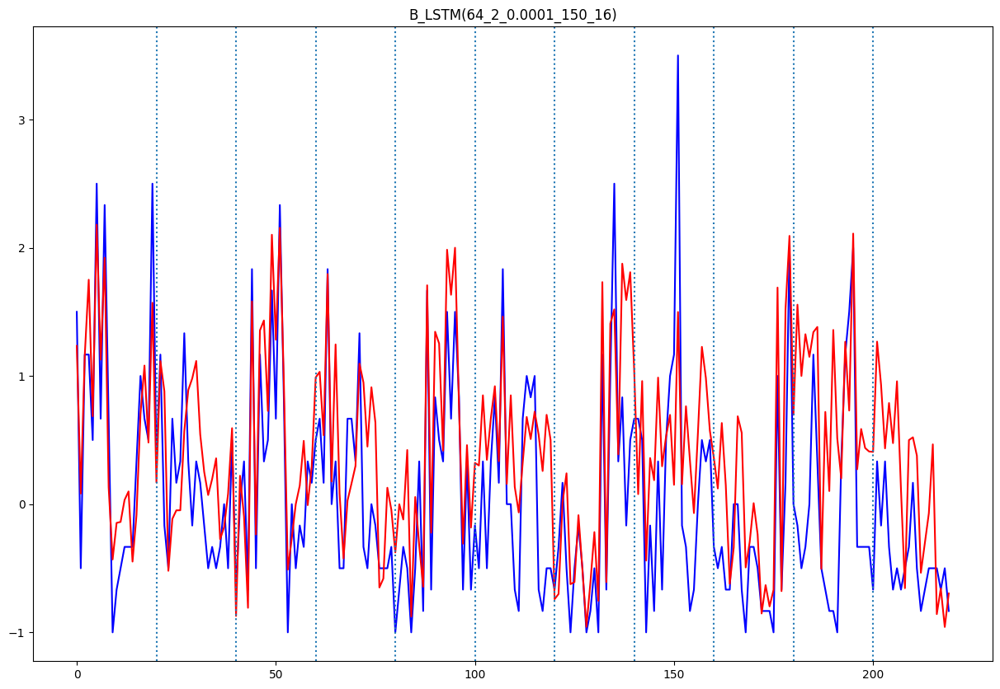

B_LSTM(64_2_0.0001_150_32)
7/7 [==============================] - 2s 6ms/step
평균 검증 MSE: 0.3579114178550558
평균 검증 RMSE: 0.5982569831226844


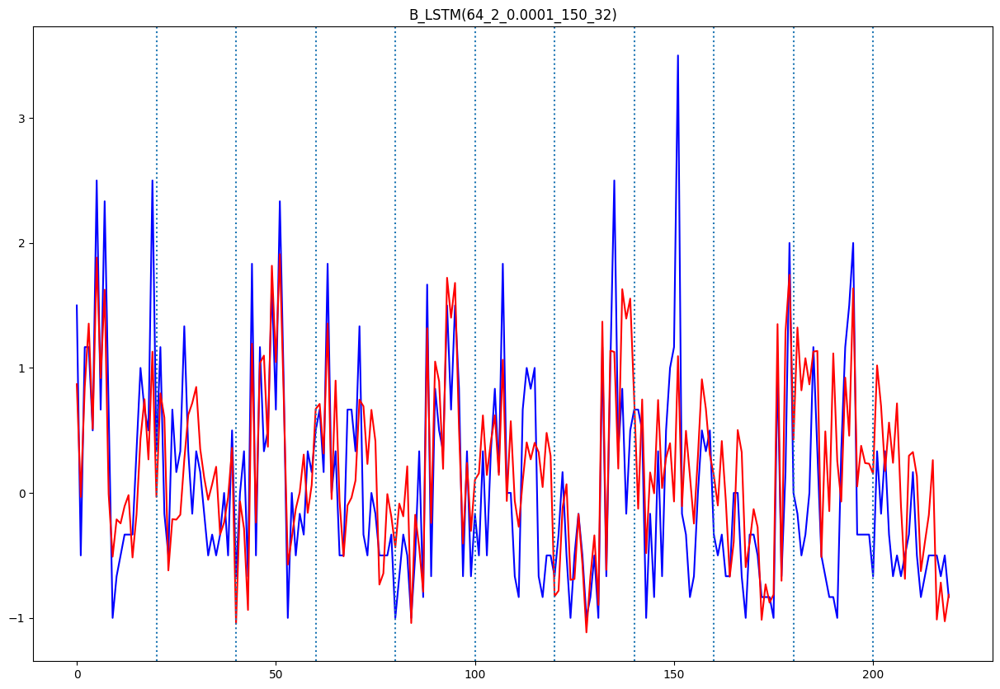

B_LSTM(64_2_0.0001_200_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.484454392529783
평균 검증 RMSE: 0.6960275802939011


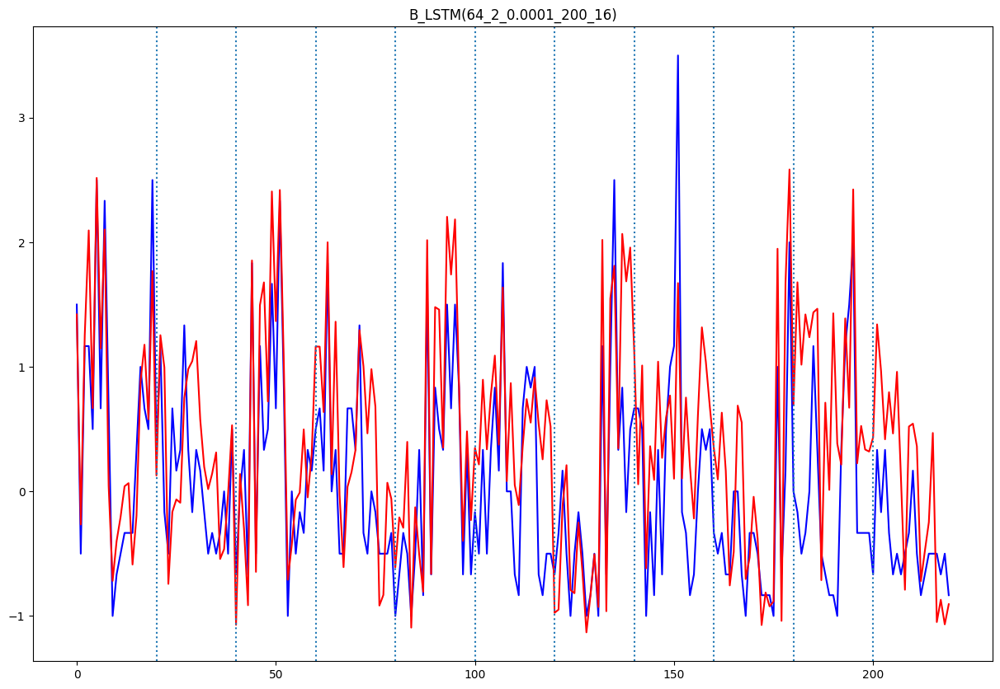

B_LSTM(64_2_0.0001_200_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.4459441230150754
평균 검증 RMSE: 0.6677904783800646


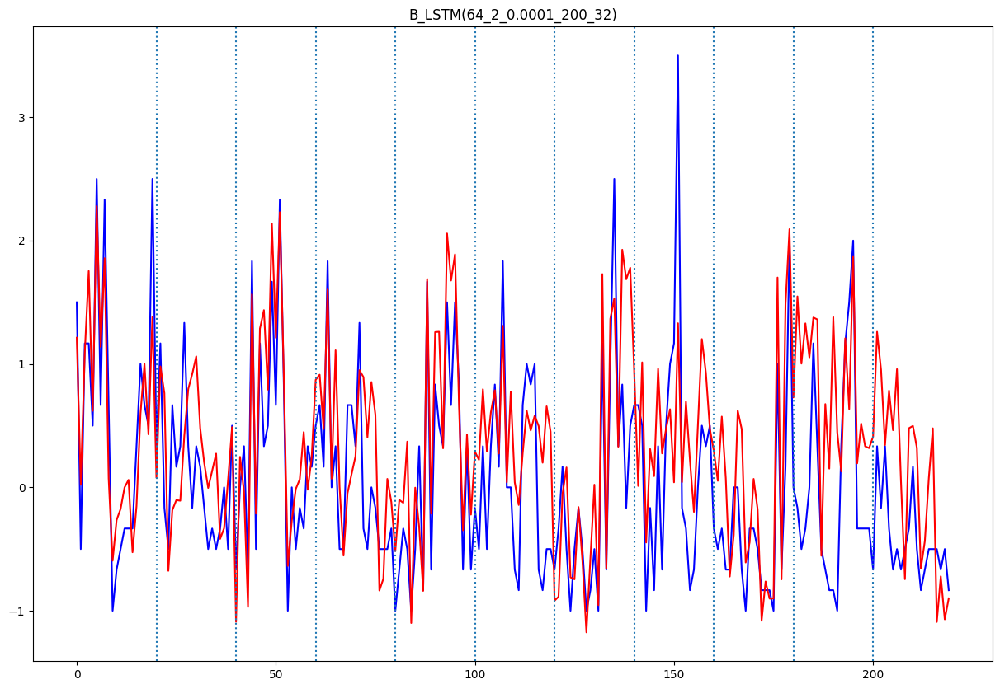

B_LSTM(64_2_0.001_100_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.5206353949346784
평균 검증 RMSE: 0.7215506877099338


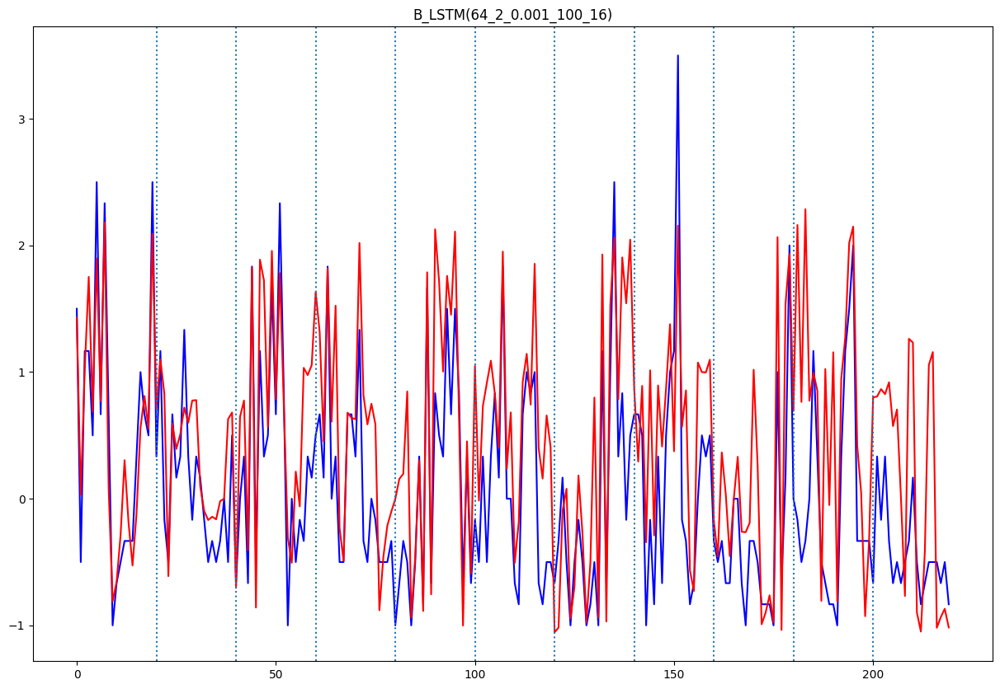

B_LSTM(64_2_0.001_100_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.41171979172784384
평균 검증 RMSE: 0.6416539501381129


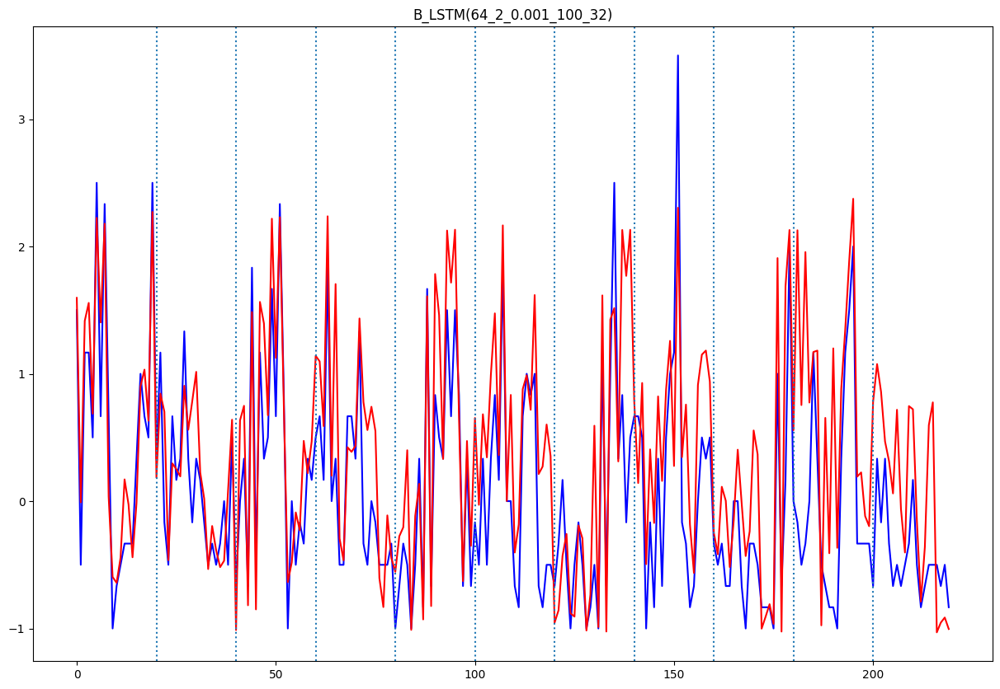

B_LSTM(64_2_0.001_150_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.47683815565516763
평균 검증 RMSE: 0.6905346882345359


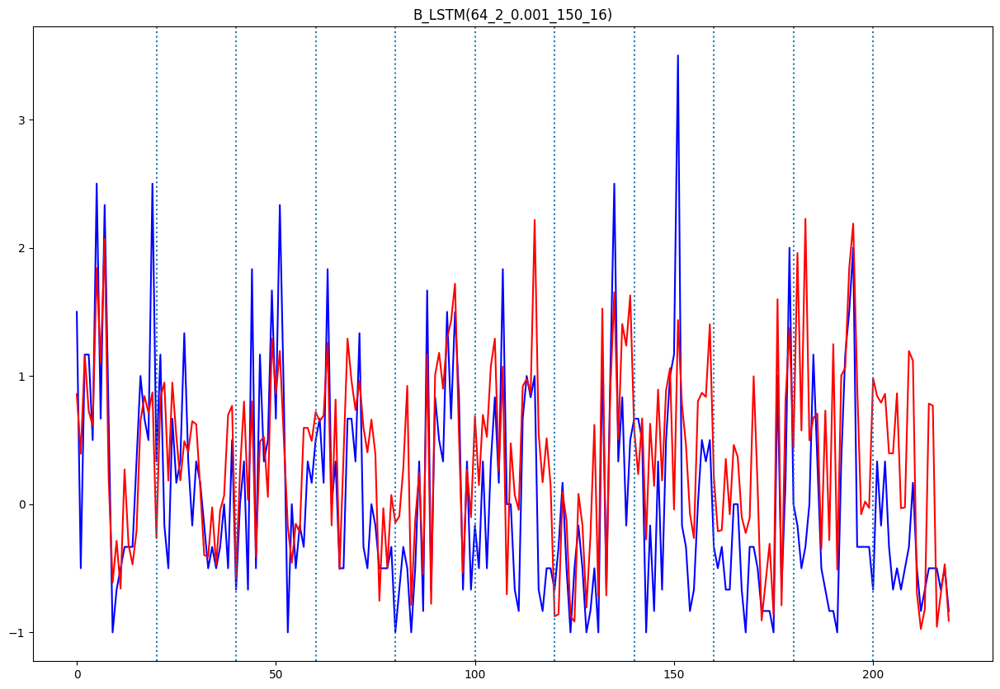

B_LSTM(64_2_0.001_150_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.42748876611929837
평균 검증 RMSE: 0.6538262507113785


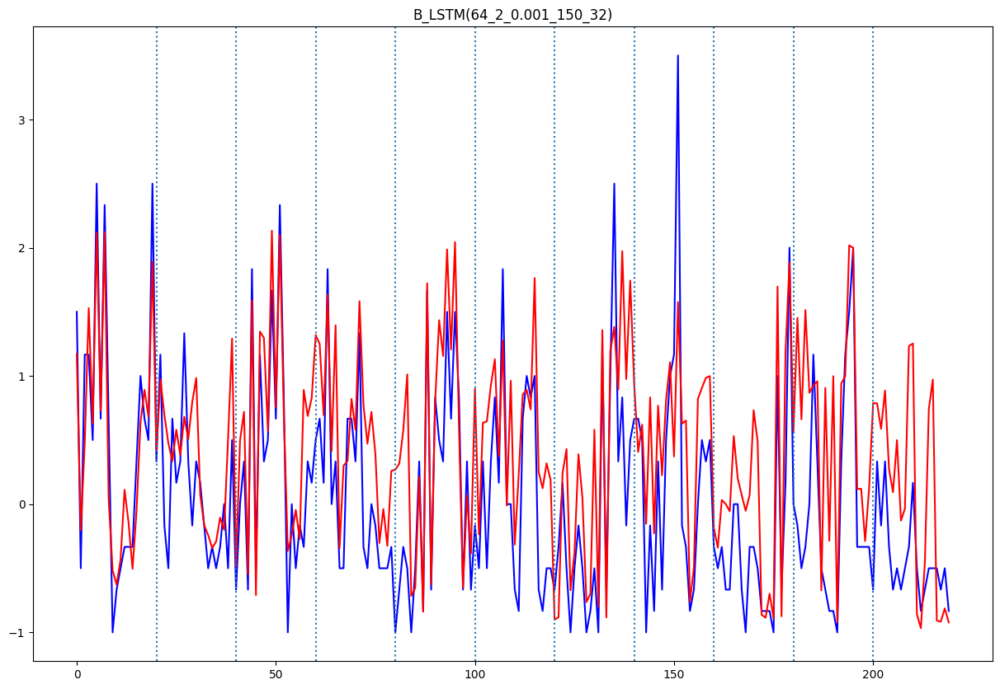

B_LSTM(64_2_0.001_200_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.3777918642701287
평균 검증 RMSE: 0.6146477562556694


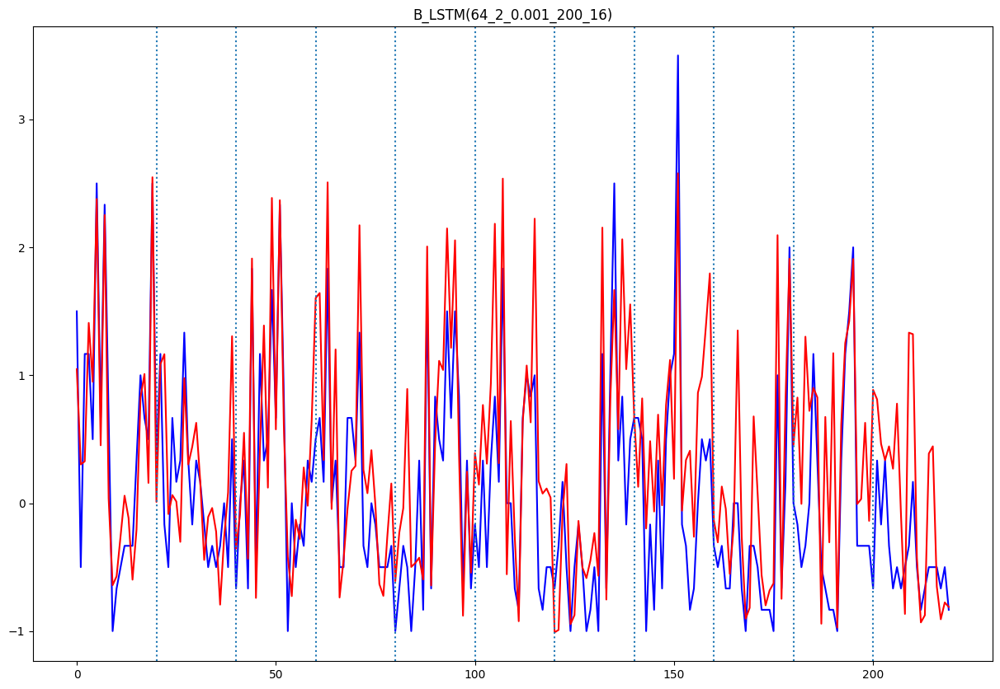

B_LSTM(64_2_0.001_200_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.34695000296962825
평균 검증 RMSE: 0.5890246200029573


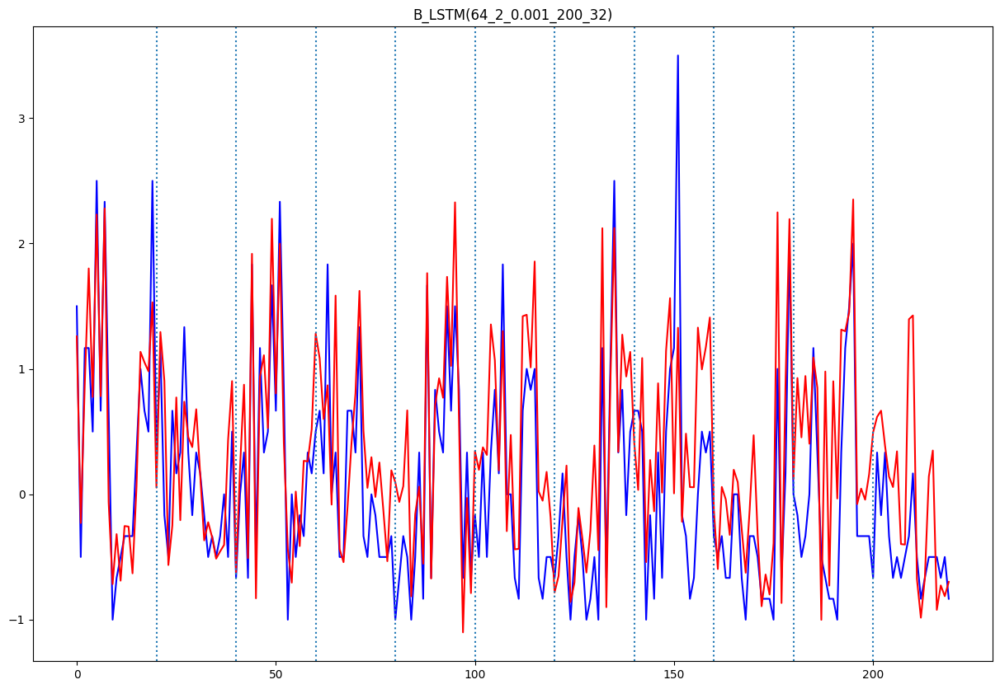

B_LSTM(64_3_5e-05_100_16)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.55960074093384
평균 검증 RMSE: 0.7480646636045845


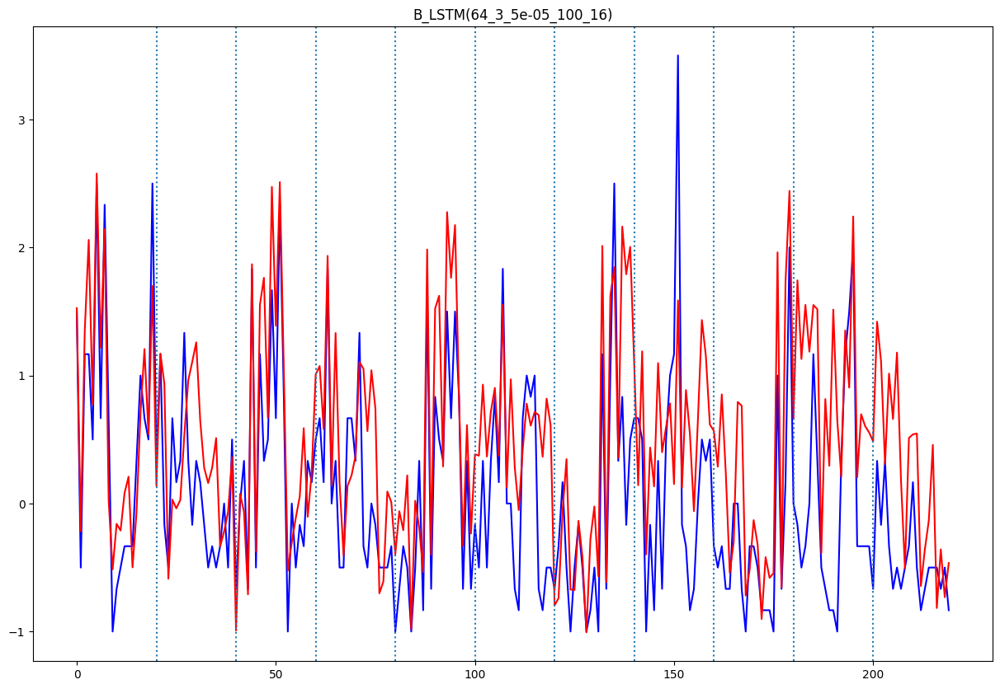

B_LSTM(64_3_5e-05_100_32)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.5165711798808518
평균 검증 RMSE: 0.71872886395417


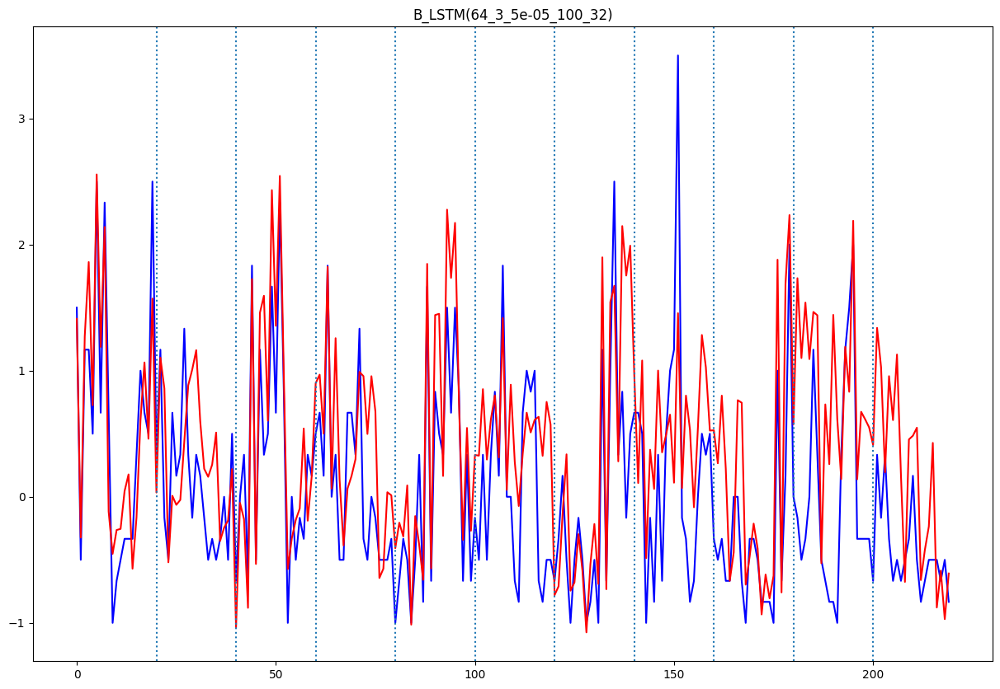

B_LSTM(64_3_5e-05_150_16)
7/7 [==============================] - 1s 8ms/step
평균 검증 MSE: 0.4241152874120616
평균 검증 RMSE: 0.6512413434450101


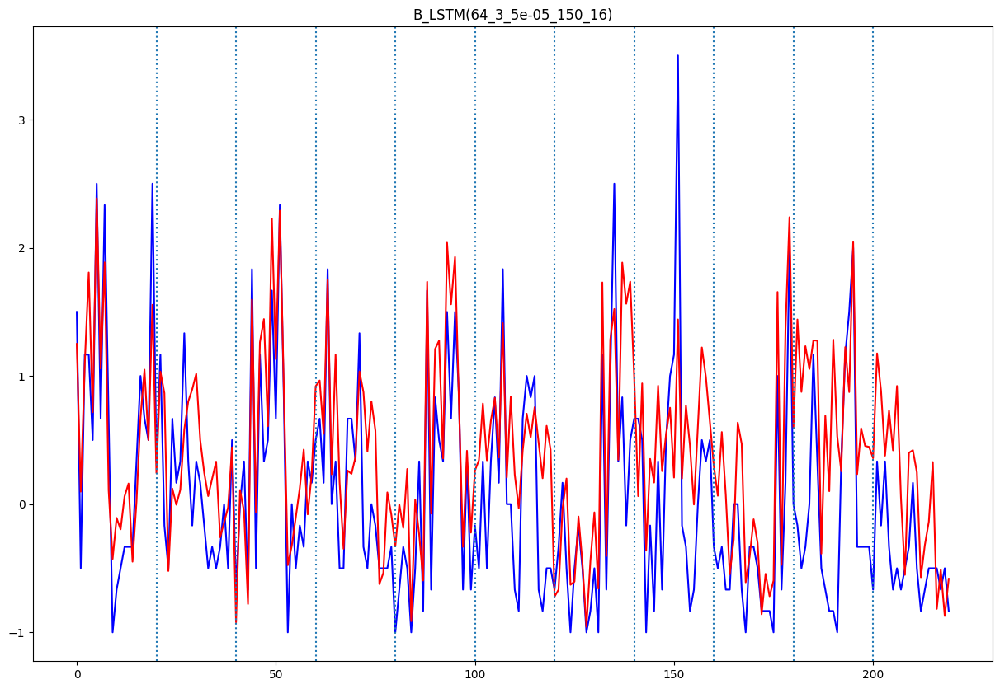

B_LSTM(64_3_5e-05_150_32)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.3234230224207078
평균 검증 RMSE: 0.5687029298506452


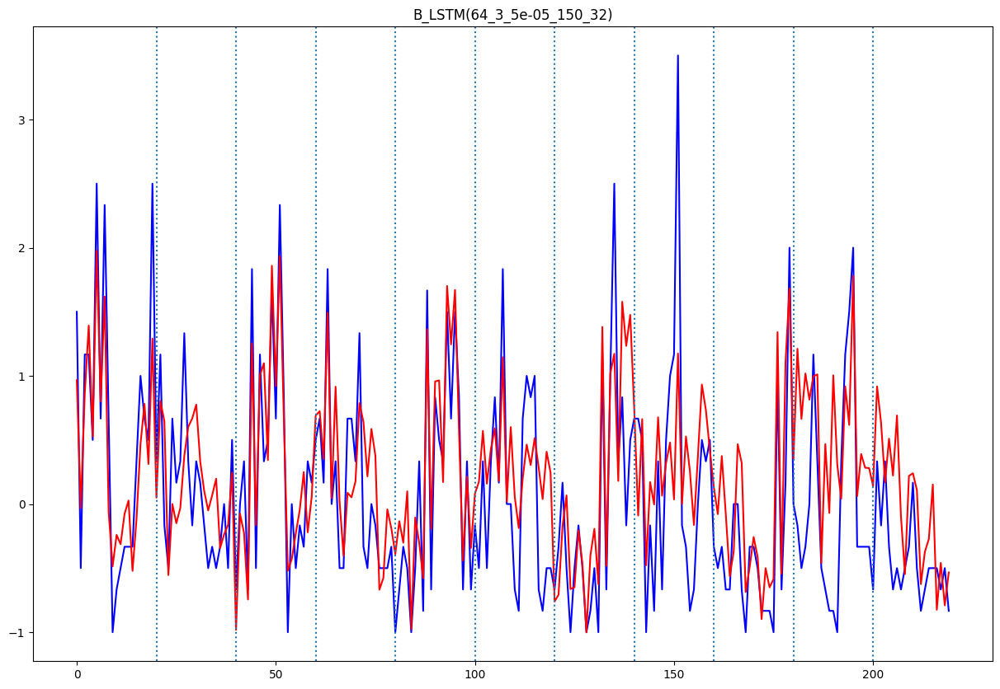

B_LSTM(64_3_5e-05_200_16)
7/7 [==============================] - 2s 8ms/step
평균 검증 MSE: 0.4940591991630273
평균 검증 RMSE: 0.7028934479443006


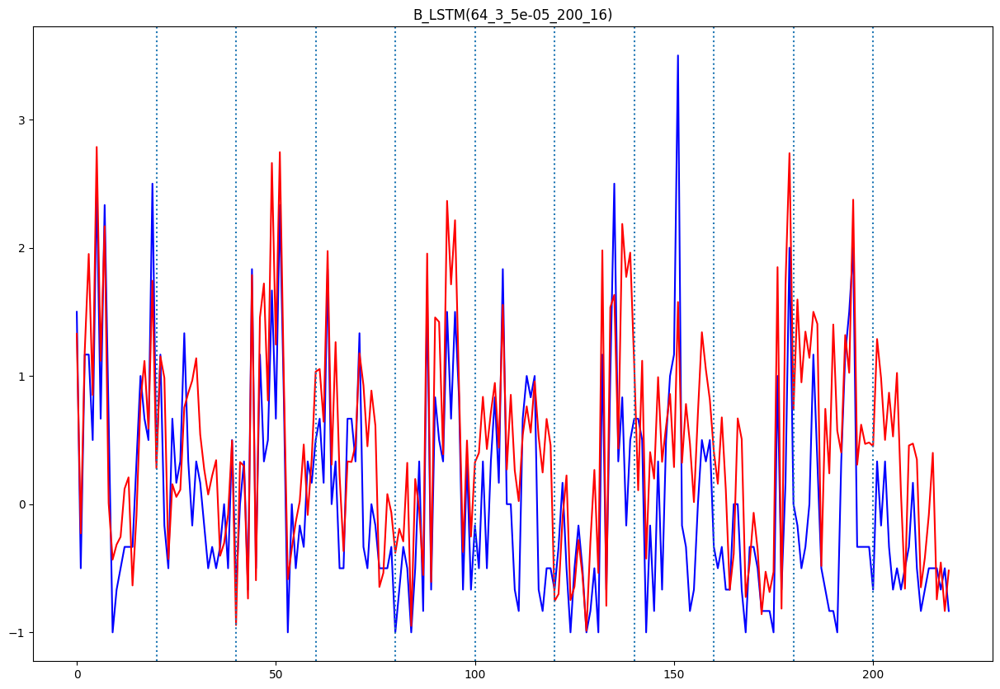

B_LSTM(64_3_5e-05_200_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.3976537410937106
평균 검증 RMSE: 0.6305979234771636


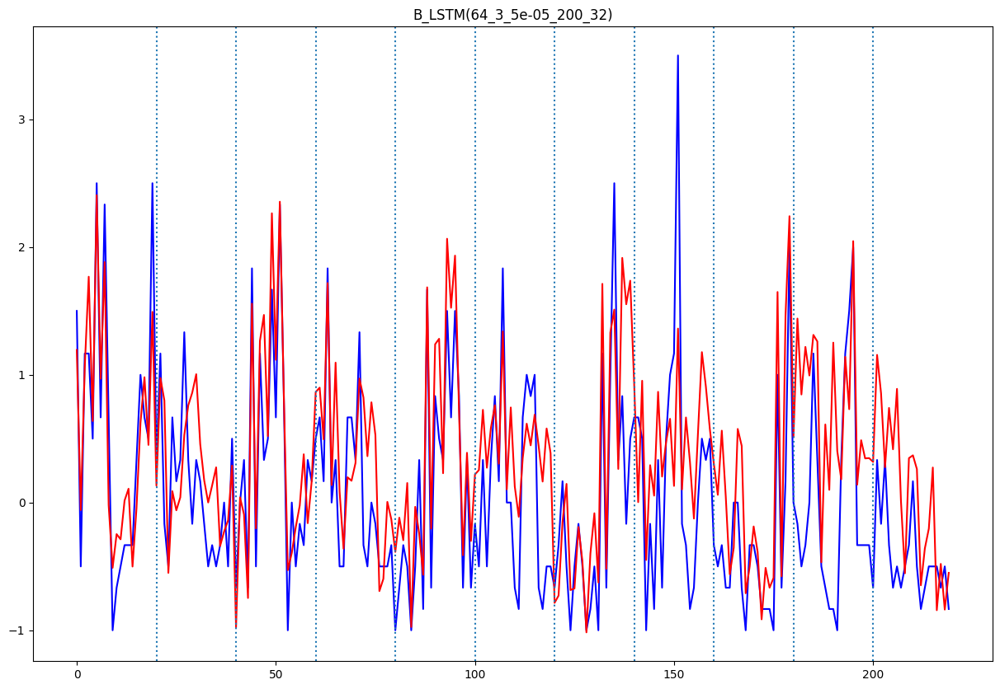

B_LSTM(64_3_0.0001_100_16)
7/7 [==============================] - 1s 8ms/step
평균 검증 MSE: 0.5326667526558465
평균 검증 RMSE: 0.7298402240599284


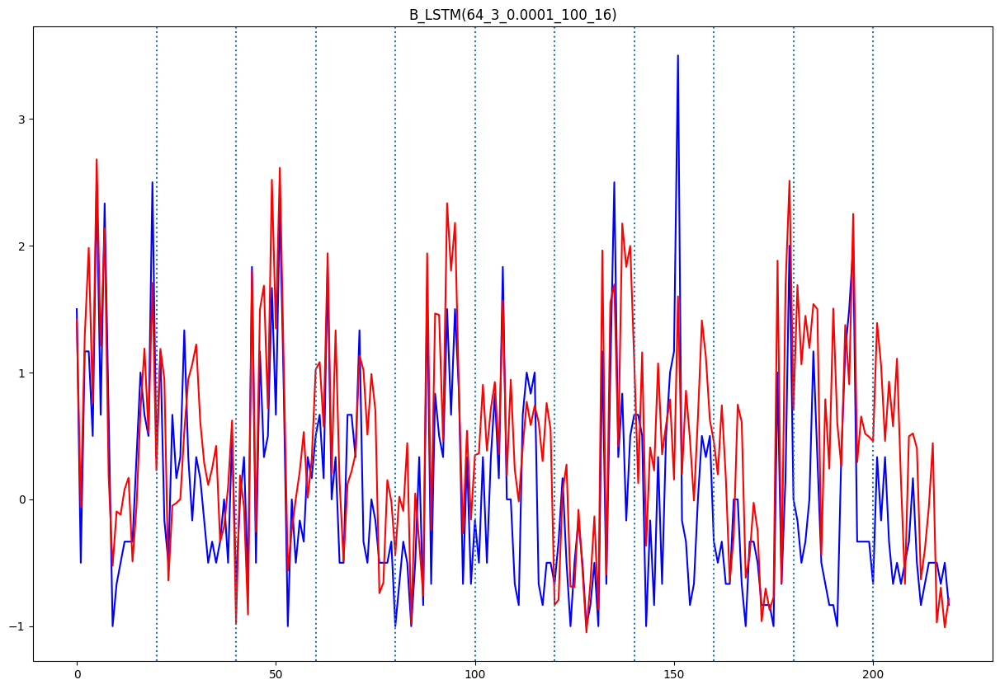

B_LSTM(64_3_0.0001_100_32)
7/7 [==============================] - 1s 8ms/step
평균 검증 MSE: 0.5663718131824342
평균 검증 RMSE: 0.7525767822504453


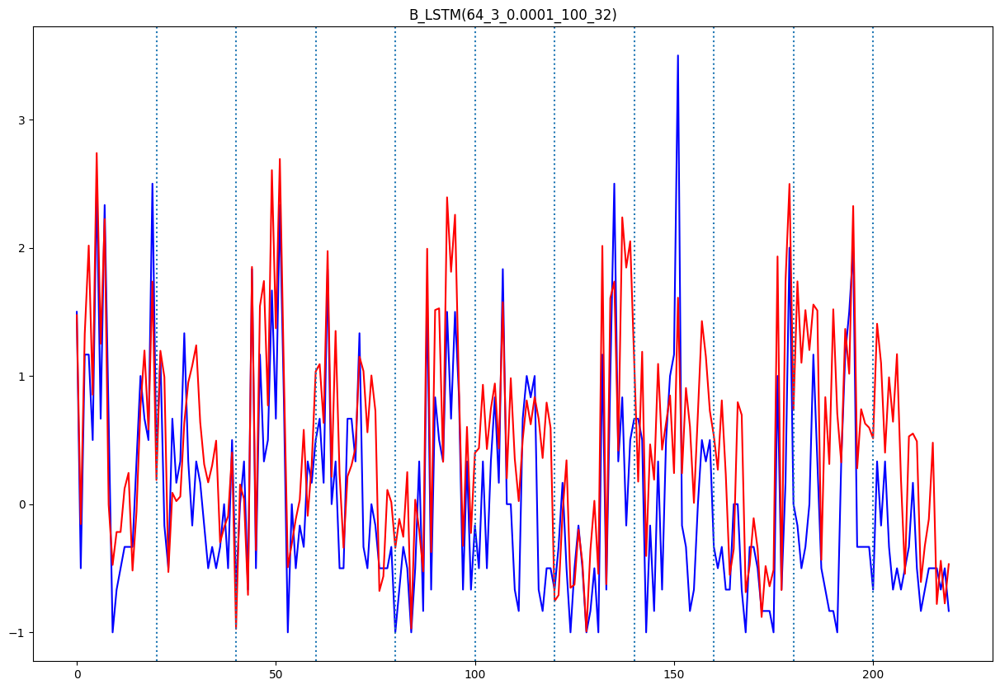

B_LSTM(64_3_0.0001_150_16)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.4132185341574707
평균 검증 RMSE: 0.6428207636328113


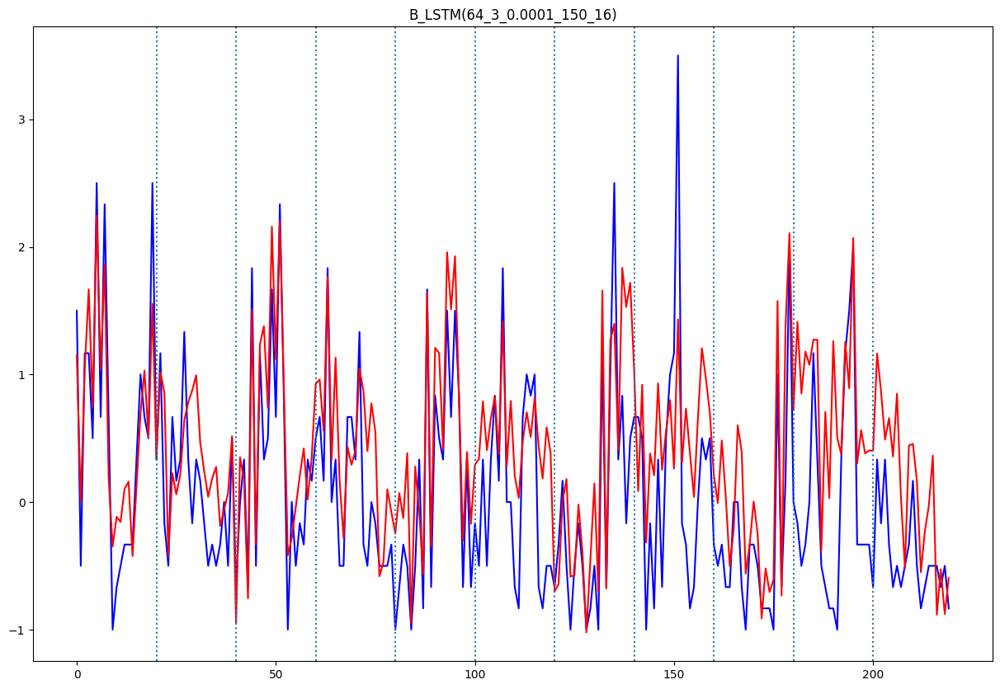

B_LSTM(64_3_0.0001_150_32)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.3289816149147762
평균 검증 RMSE: 0.5735691893004506


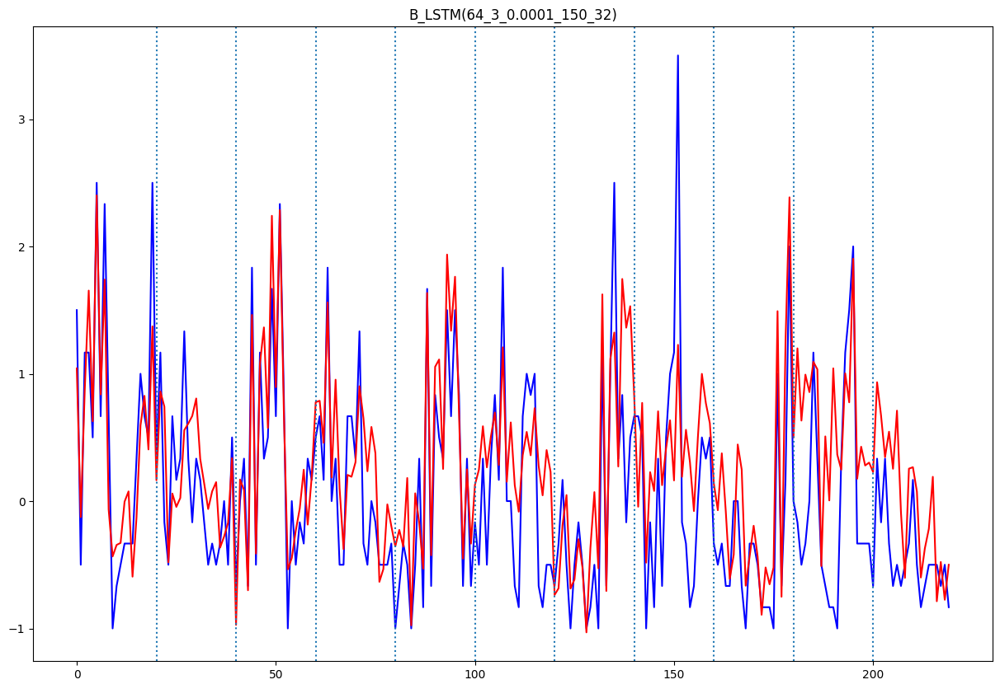

B_LSTM(64_3_0.0001_200_16)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.43819246308170184
평균 검증 RMSE: 0.6619610736906679


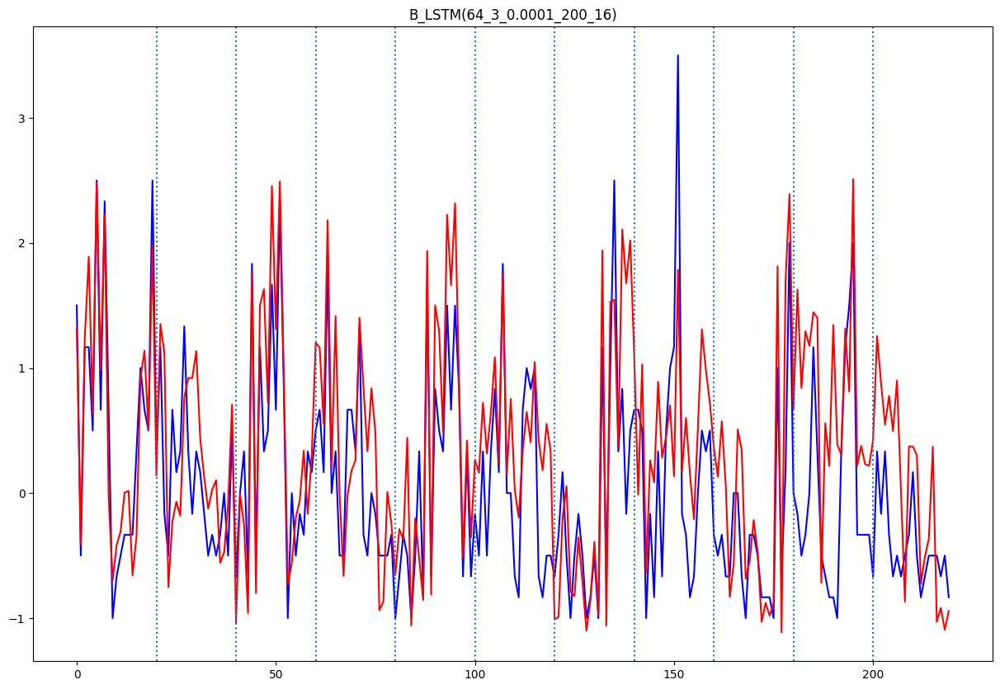

B_LSTM(64_3_0.0001_200_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.41579991705102476
평균 검증 RMSE: 0.6448254934872106


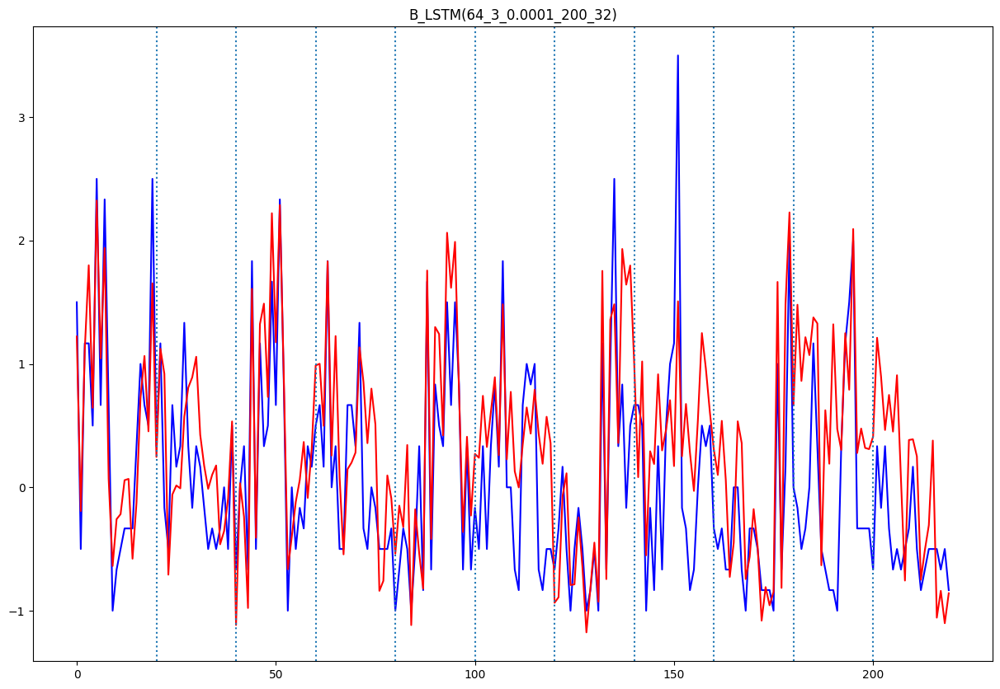

B_LSTM(64_3_0.001_100_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.5925894713818163
평균 검증 RMSE: 0.7697983316309644


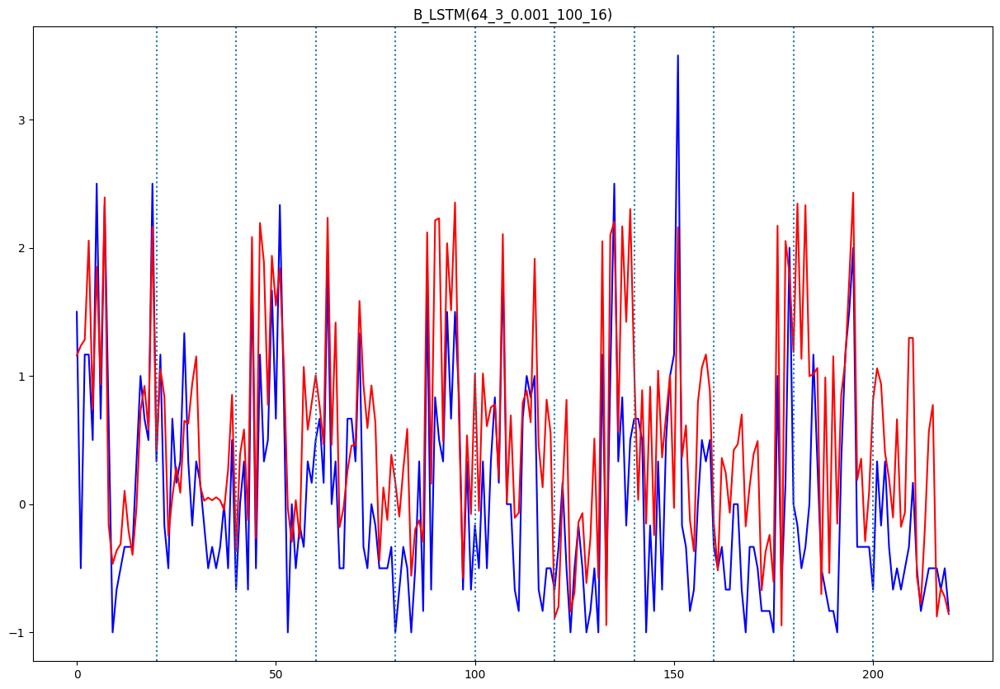

B_LSTM(64_3_0.001_100_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.4438214794670546
평균 검증 RMSE: 0.6661992790952679


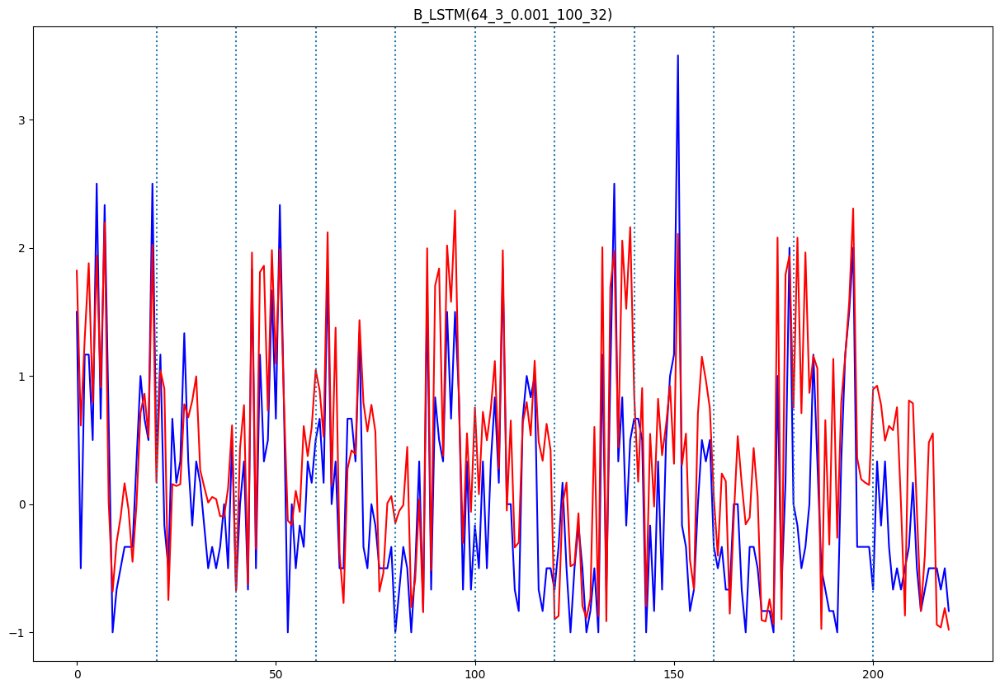

B_LSTM(64_3_0.001_150_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.33569066493205435
평균 검증 RMSE: 0.5793881815605616


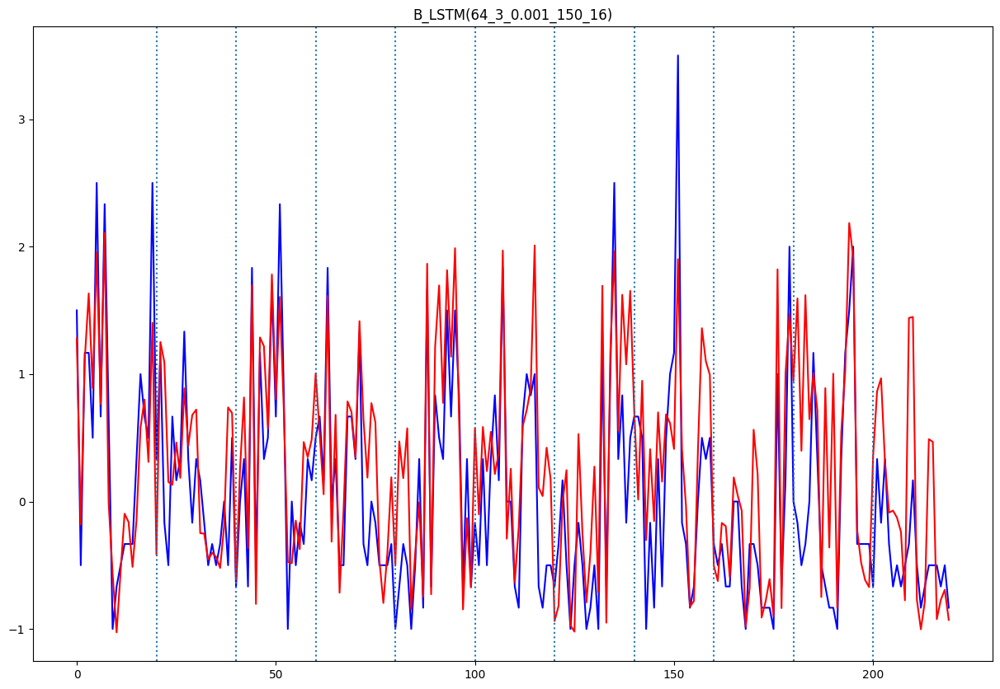

B_LSTM(64_3_0.001_150_32)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.3964167007027496
평균 검증 RMSE: 0.6296163122908662


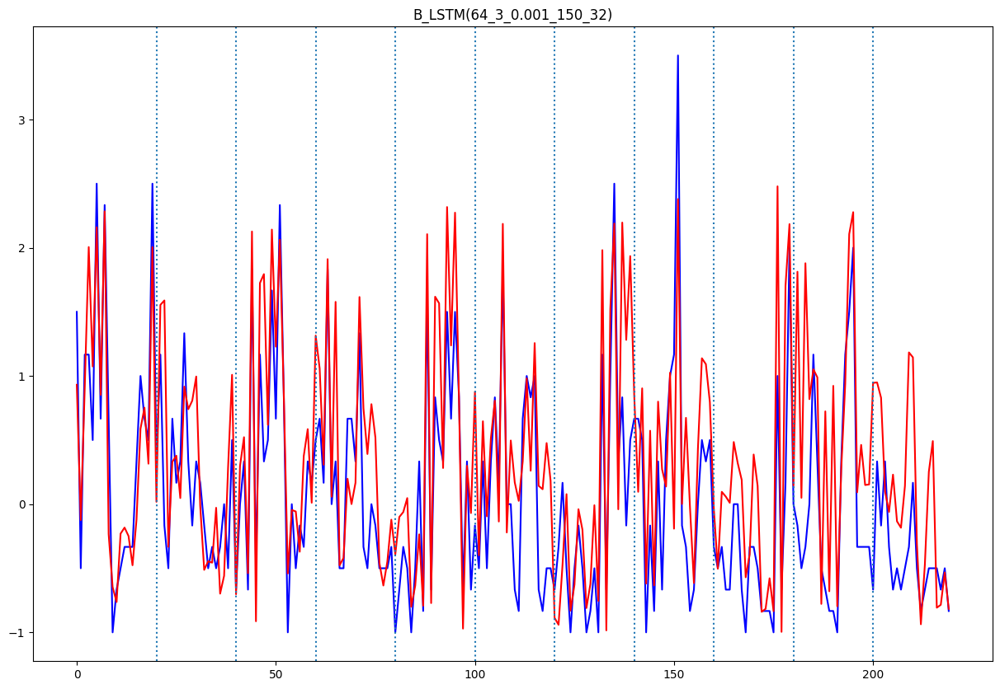

B_LSTM(64_3_0.001_200_16)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.3412789055029968
평균 검증 RMSE: 0.5841908125800993


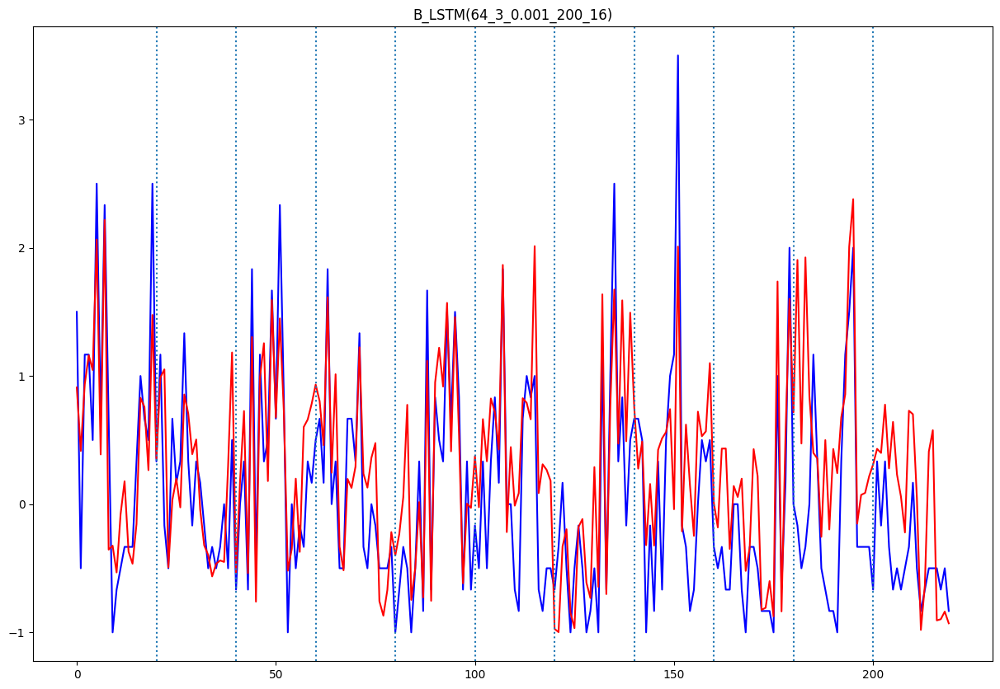

B_LSTM(64_3_0.001_200_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.38523447191266574
평균 검증 RMSE: 0.6206725963925471


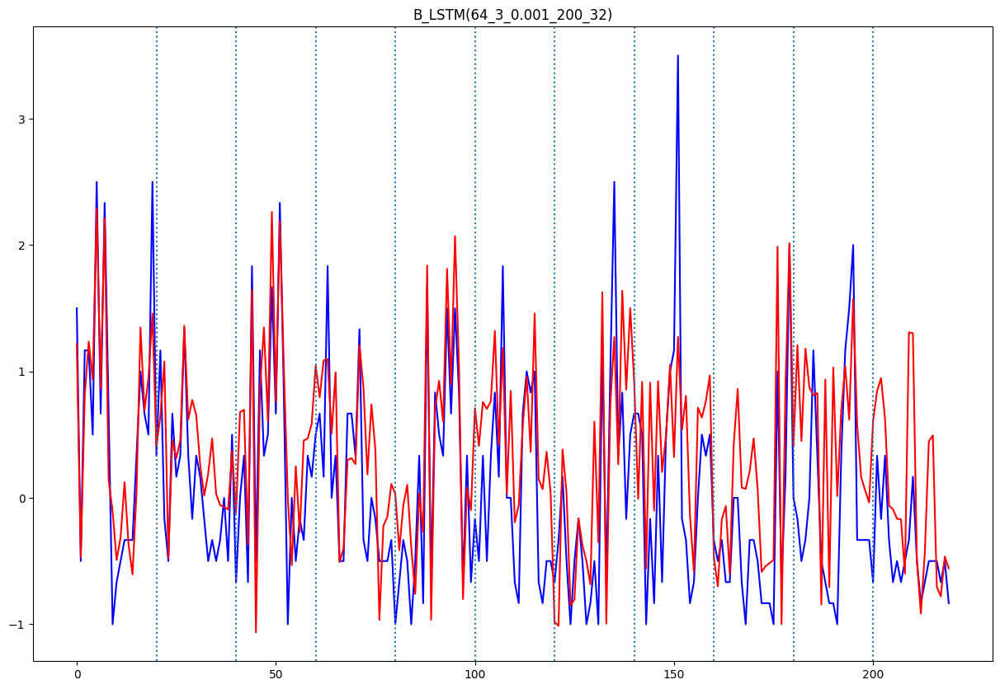

In [ ]:
history = {"case" : [], "model" : [],
           "num_units" : [], "num_layers" : [], "learning_rate" : [], "epochs" : [], "batch_size" : [],
           "mean_mse" : [], "mean_rmse" : []}

case_ = "B"
model_ = "LSTM"

for num_units in num_units_case :
  for num_layers in num_layers_case :
    for learning_rate in learning_rate_case :
      for epochs in epochs_case :
        for batch_size in batch_size_case :
          # 파일 저장용 제목
          title = f"{case_}_{model_}({num_units}_{num_layers}_{learning_rate}_{epochs}_{batch_size})"

          print(f"{title}")

          # 모델 학습
          models = lstm(X_train, y_train,
                      num_units = num_units,
                      num_layers = num_layers,
                      learning_rate = learning_rate,
                      epochs = epochs,
                      batch_size = batch_size)

          # 검증 진행
          mean_mse, mean_rmse = validation(X_test, y_test, models, title)

          # 기록
          history["case"].append(case_)
          history["model"].append(model_)
          history["num_units"].append(num_units)
          history["num_layers"].append(num_layers)
          history["learning_rate"].append(learning_rate)
          history["epochs"].append(epochs)
          history["batch_size"].append(batch_size)
          history["mean_mse"].append(mean_mse)
          history["mean_rmse"].append(mean_rmse)

# 기록 저장
history_df = pd.DataFrame.from_dict(data=history, orient='columns')
history_df.to_csv(f"history_{case_}_{model_}.csv", index=False)

#### 모델 돌리기 (GRU)
- 마지막 줄의 history 저장할 때, 파일명 주의!!! 자기 상황에 맞게 수정하기!!!

B_GRU(75_2_5e-05_100_16)
7/7 [==============================] - 1s 4ms/step
평균 검증 MSE: 0.4113927323033295
평균 검증 RMSE: 0.641399042954797


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

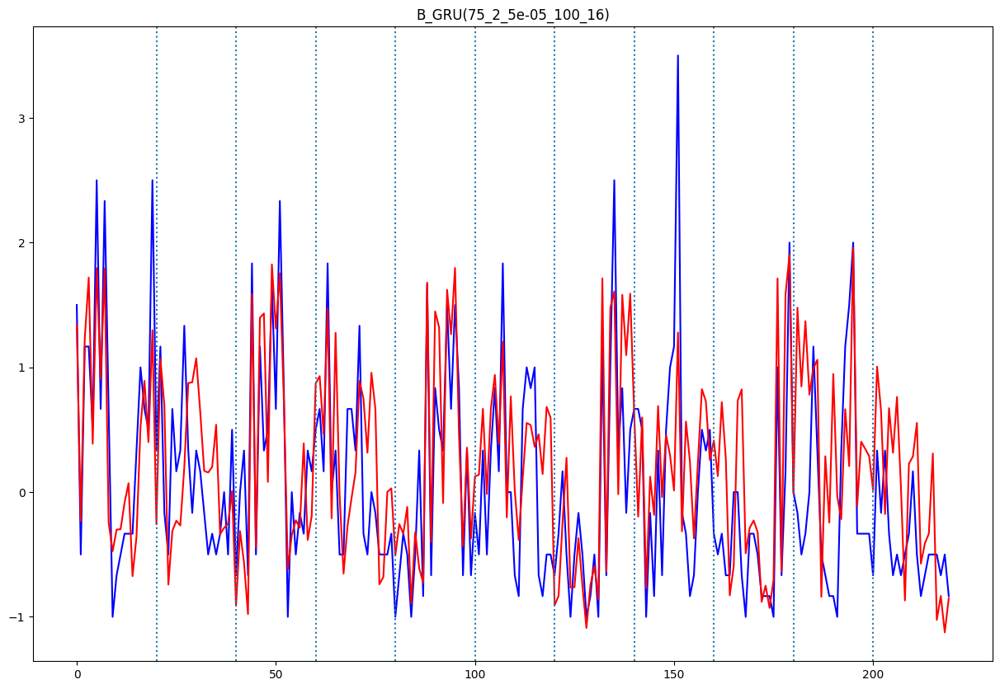

B_GRU(75_2_5e-05_100_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.5143553214080372
평균 검증 RMSE: 0.7171856952059468


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

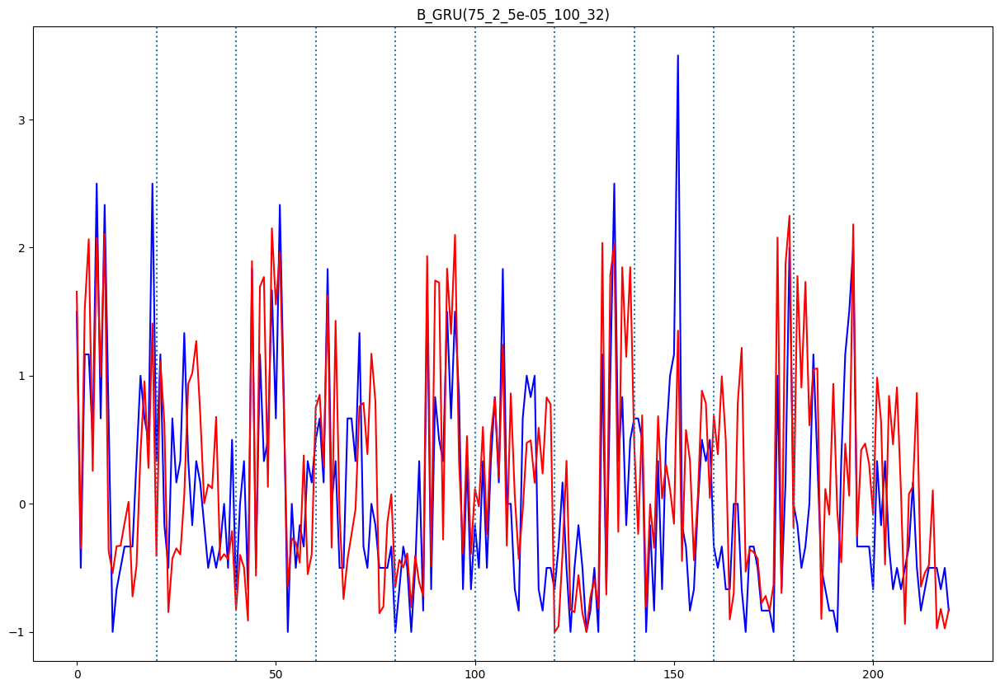

B_GRU(75_2_5e-05_150_16)
7/7 [==============================] - 1s 4ms/step
평균 검증 MSE: 0.5182135228209104
평균 검증 RMSE: 0.7198704903112159


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

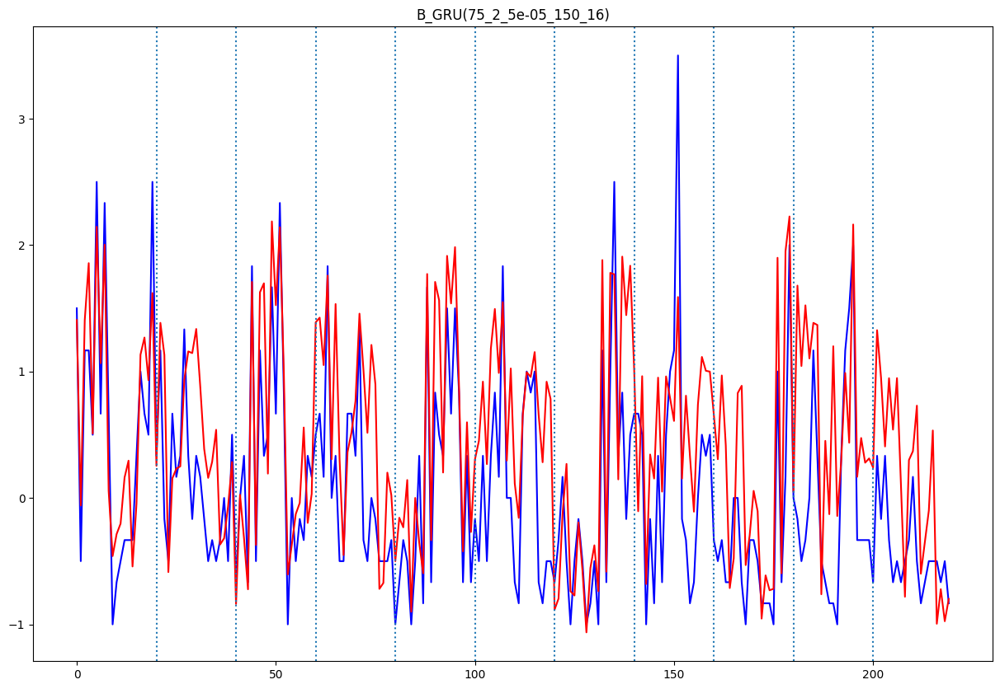

B_GRU(75_2_5e-05_150_32)
7/7 [==============================] - 1s 4ms/step
평균 검증 MSE: 0.4096751654995374
평균 검증 RMSE: 0.6400587203527013


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

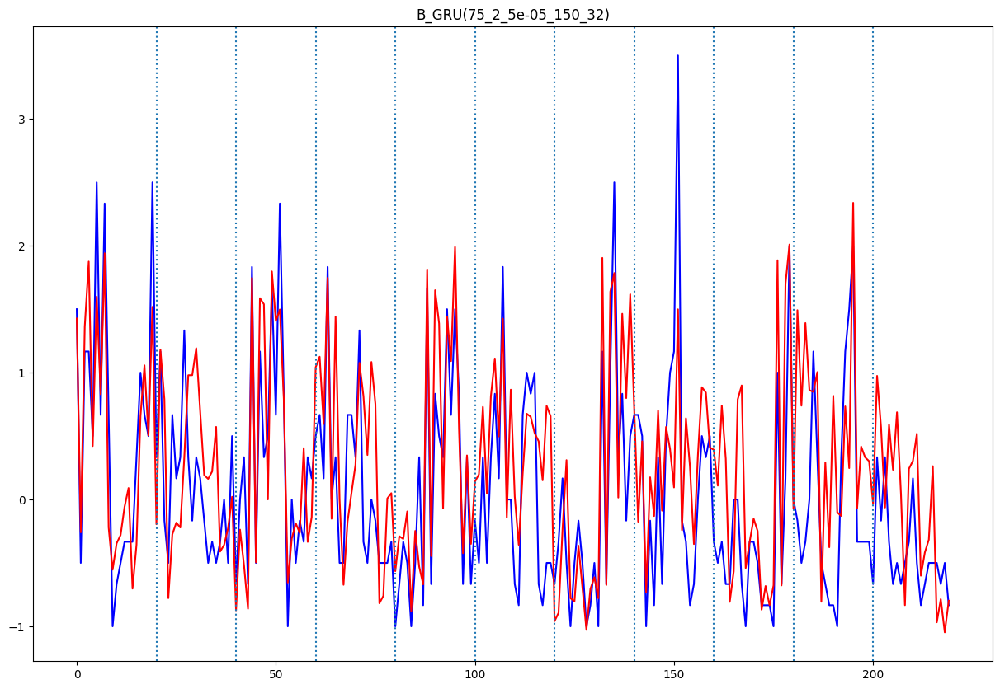

B_GRU(75_2_5e-05_200_16)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.4786110436431712
평균 검증 RMSE: 0.6918172039225182


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

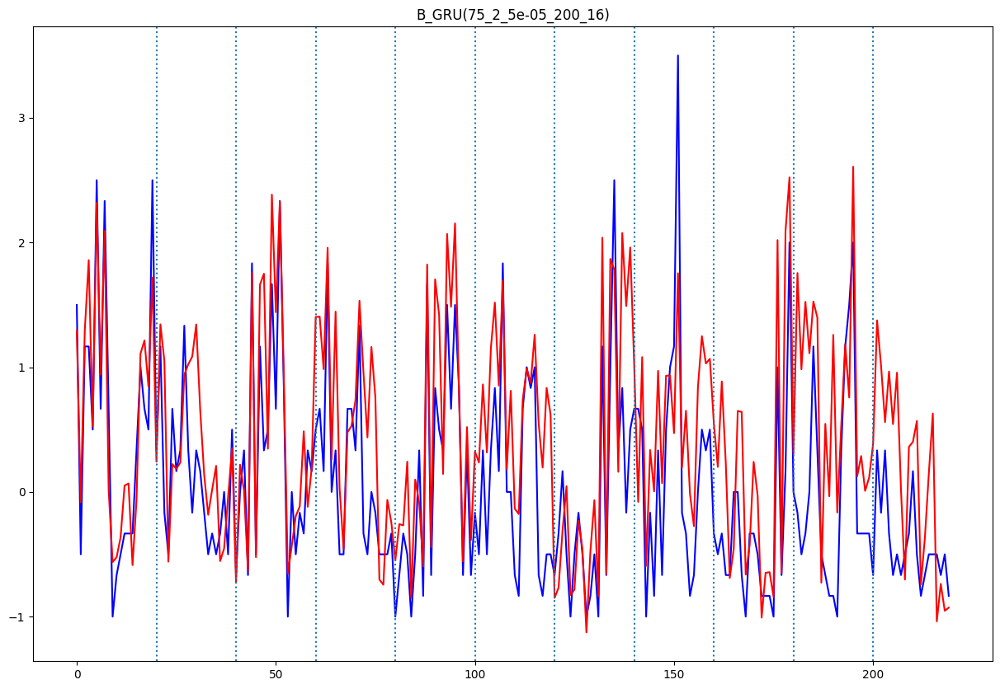

B_GRU(75_2_5e-05_200_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.5593114864833515
평균 검증 RMSE: 0.7478713034228225


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

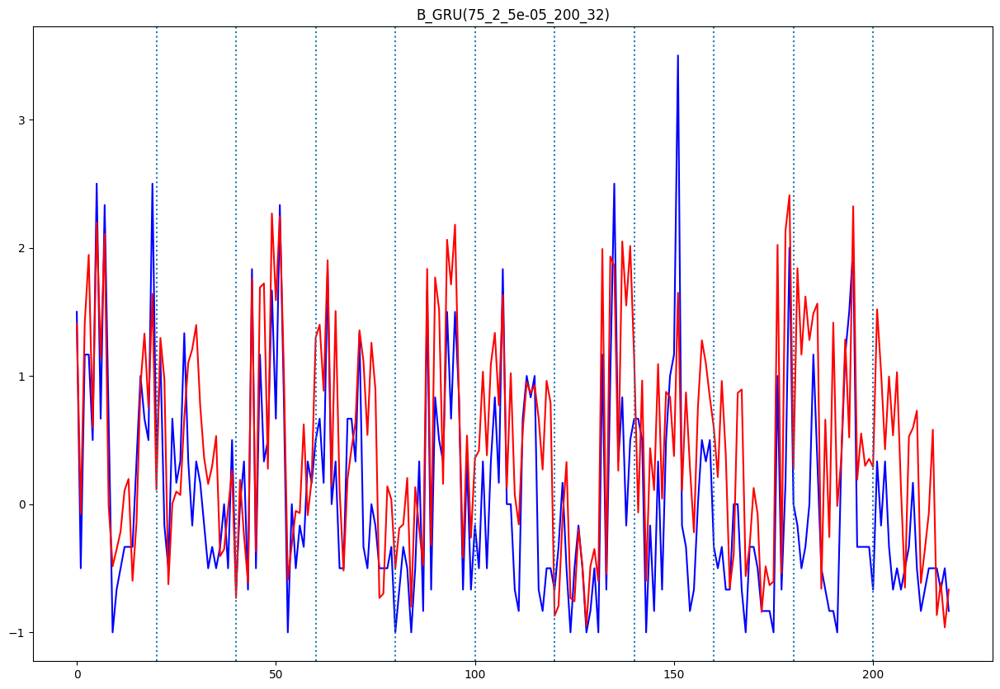

B_GRU(75_2_0.0001_100_16)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.5891454475657546
평균 검증 RMSE: 0.7675581069637364


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

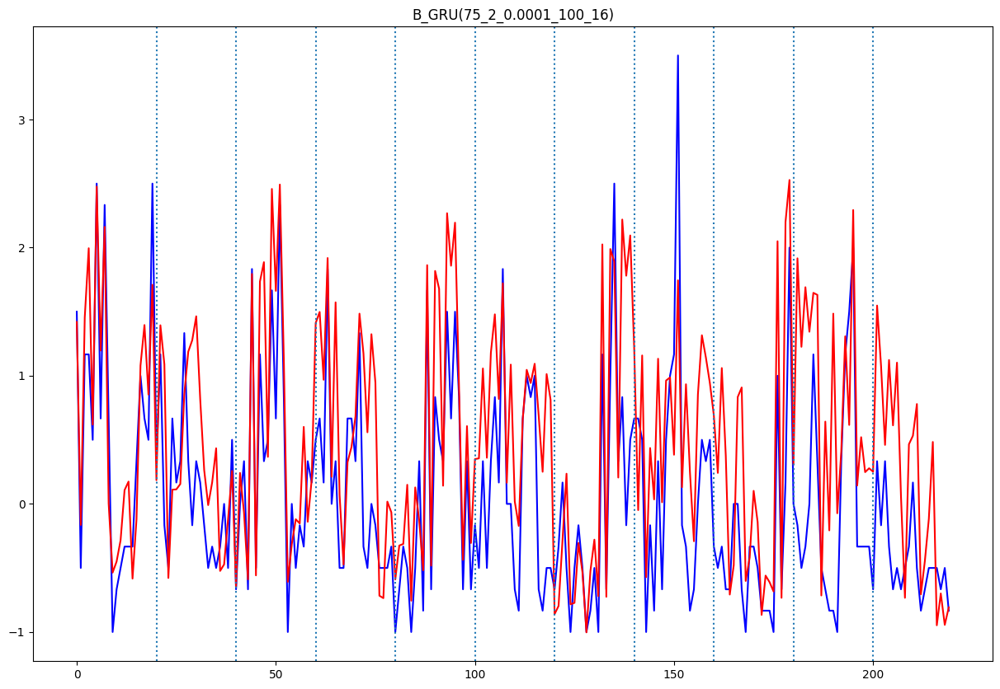

B_GRU(75_2_0.0001_100_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.39102267846794314
평균 검증 RMSE: 0.6253180618436854


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

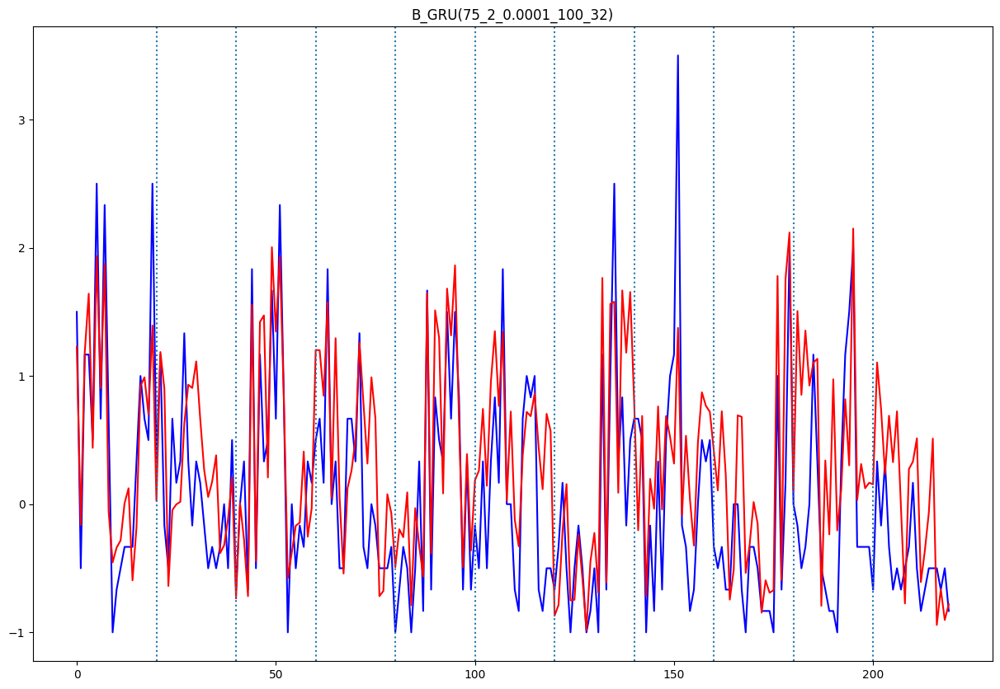

B_GRU(75_2_0.0001_150_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.3934422844724265
평균 검증 RMSE: 0.6272497783757492


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

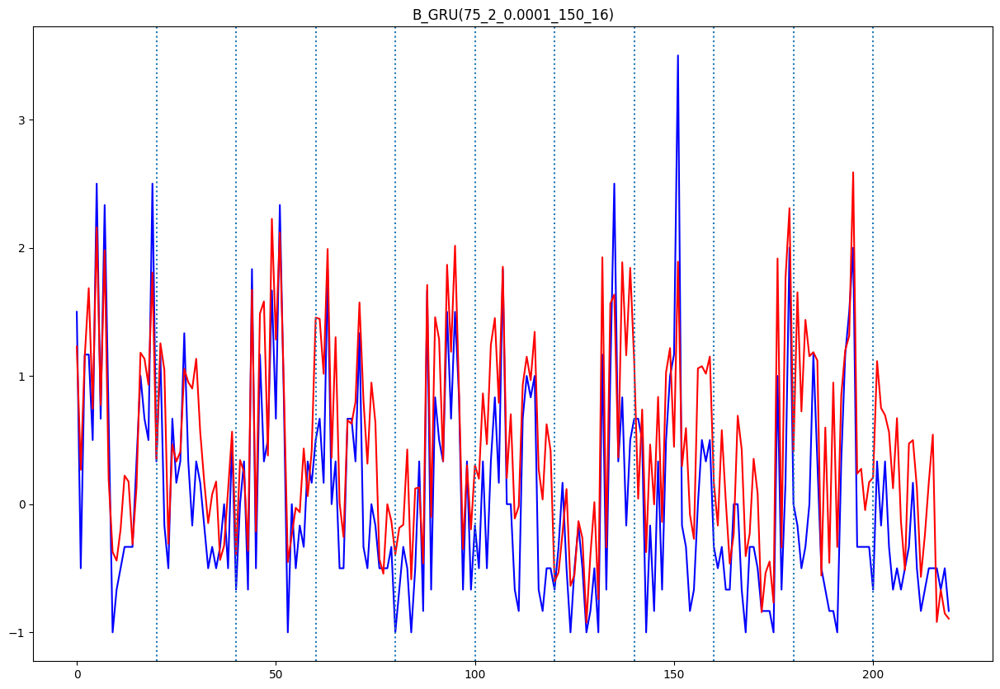

B_GRU(75_2_0.0001_150_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.48930320430245205
평균 검증 RMSE: 0.6995021117212242


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

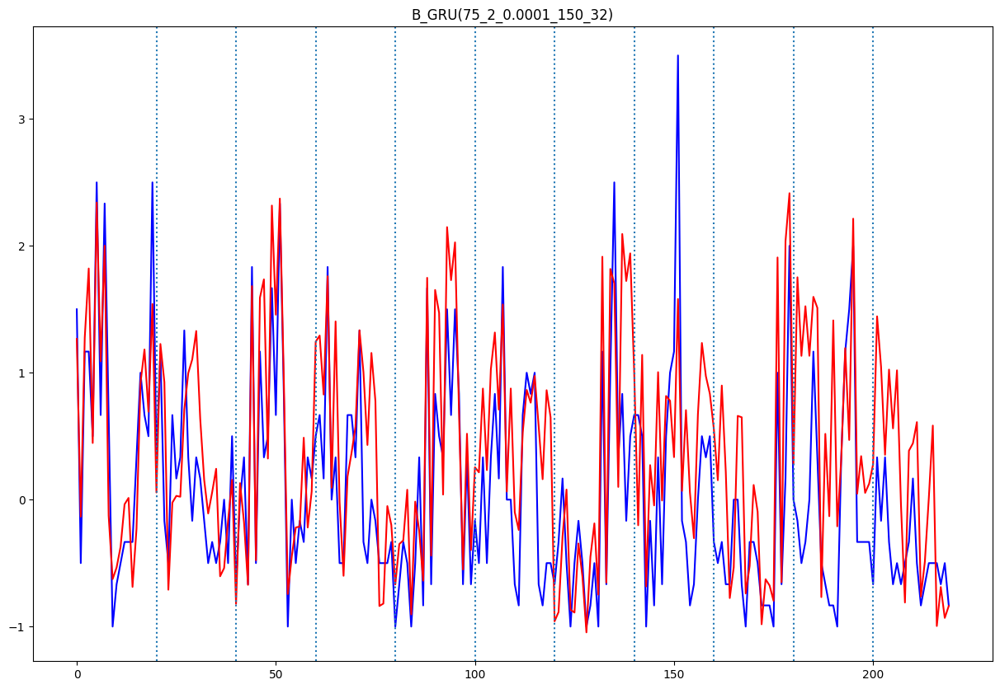

B_GRU(75_2_0.0001_200_16)
7/7 [==============================] - 1s 4ms/step
평균 검증 MSE: 0.3987375823734192
평균 검증 RMSE: 0.631456714568322


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

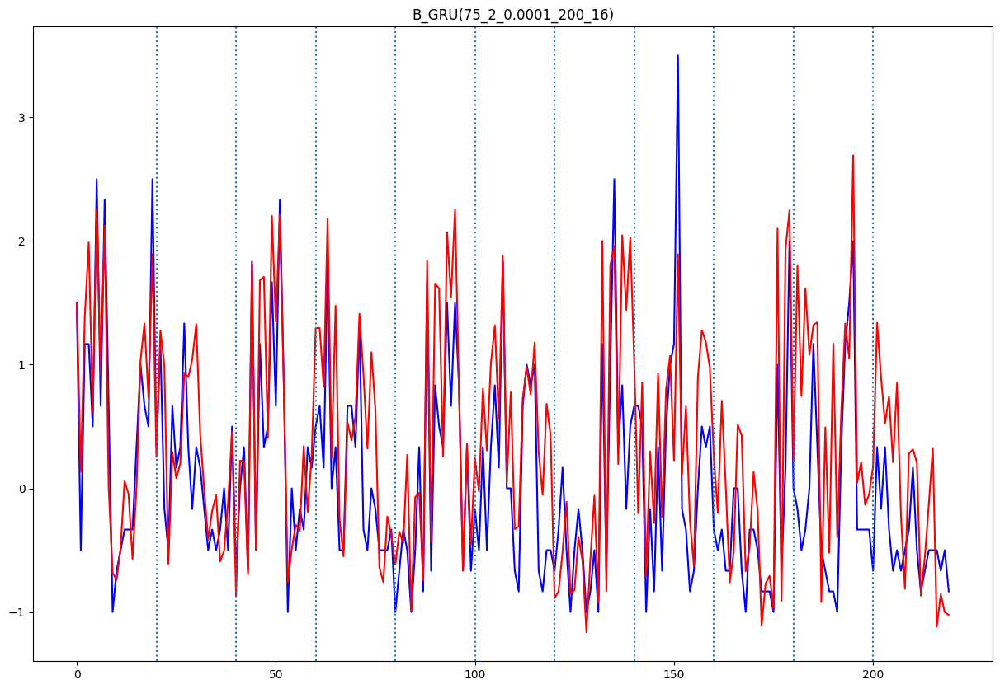

B_GRU(75_2_0.0001_200_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.3703783950661411
평균 검증 RMSE: 0.6085872123748092


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

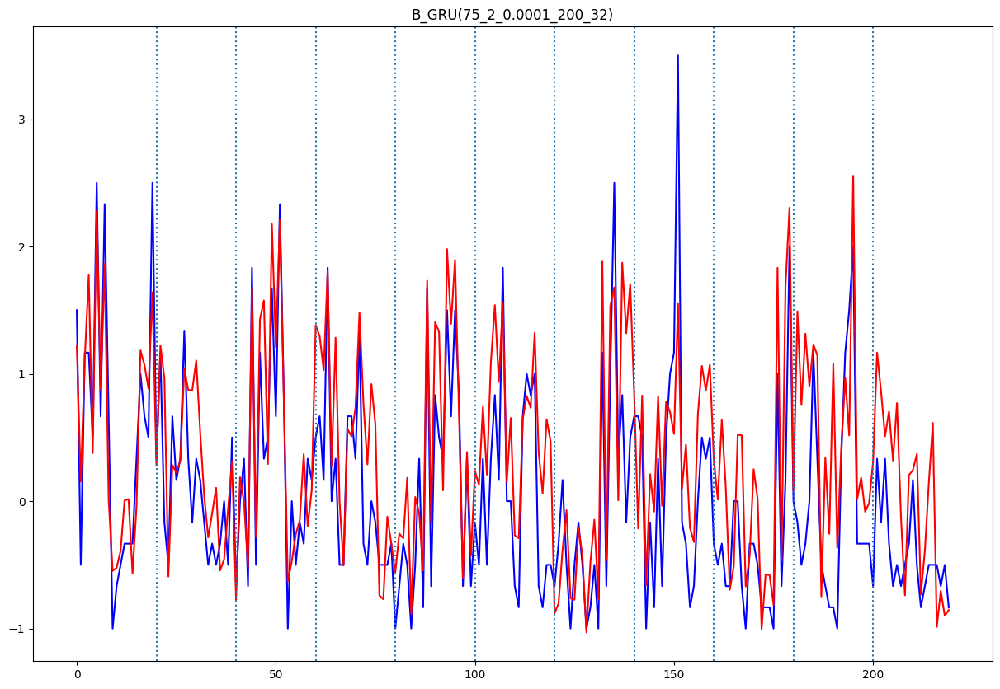

B_GRU(75_2_0.001_100_16)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.3032524346943213
평균 검증 RMSE: 0.5506836067056303


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

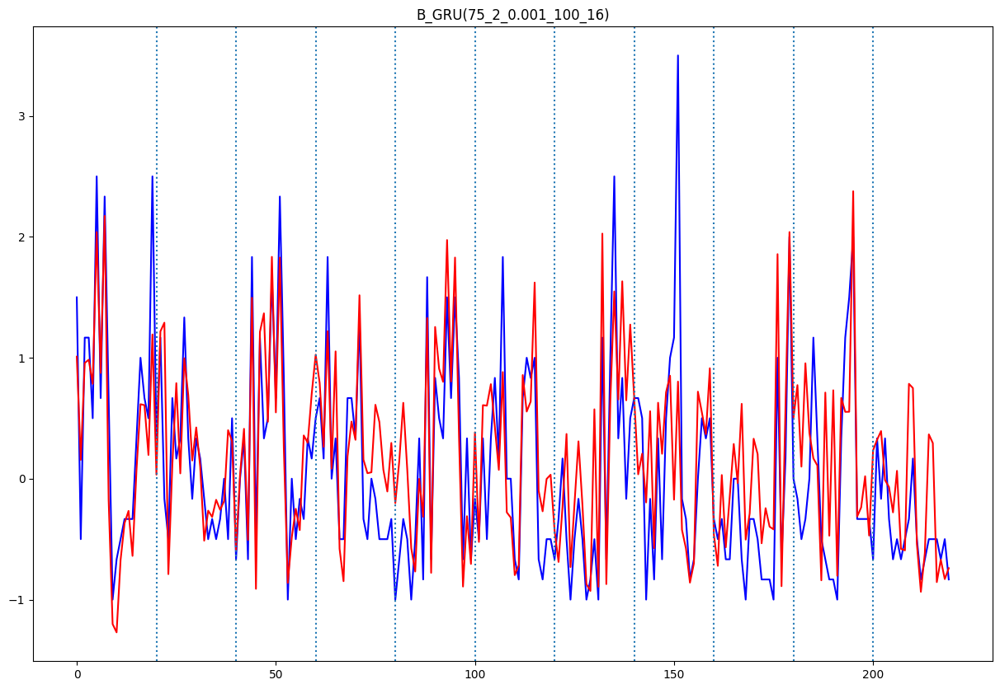

B_GRU(75_2_0.001_100_32)
7/7 [==============================] - 1s 8ms/step
평균 검증 MSE: 0.3679116666530282
평균 검증 RMSE: 0.6065572245493646


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

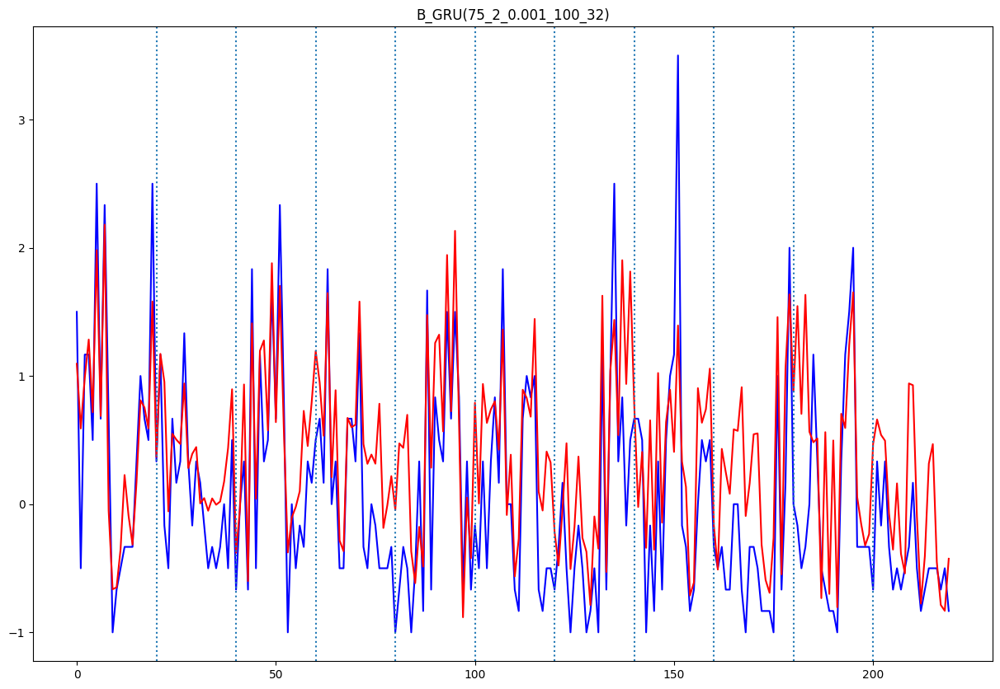

B_GRU(75_2_0.001_150_16)
7/7 [==============================] - 1s 4ms/step
평균 검증 MSE: 0.372287032580473
평균 검증 RMSE: 0.6101532861342902


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

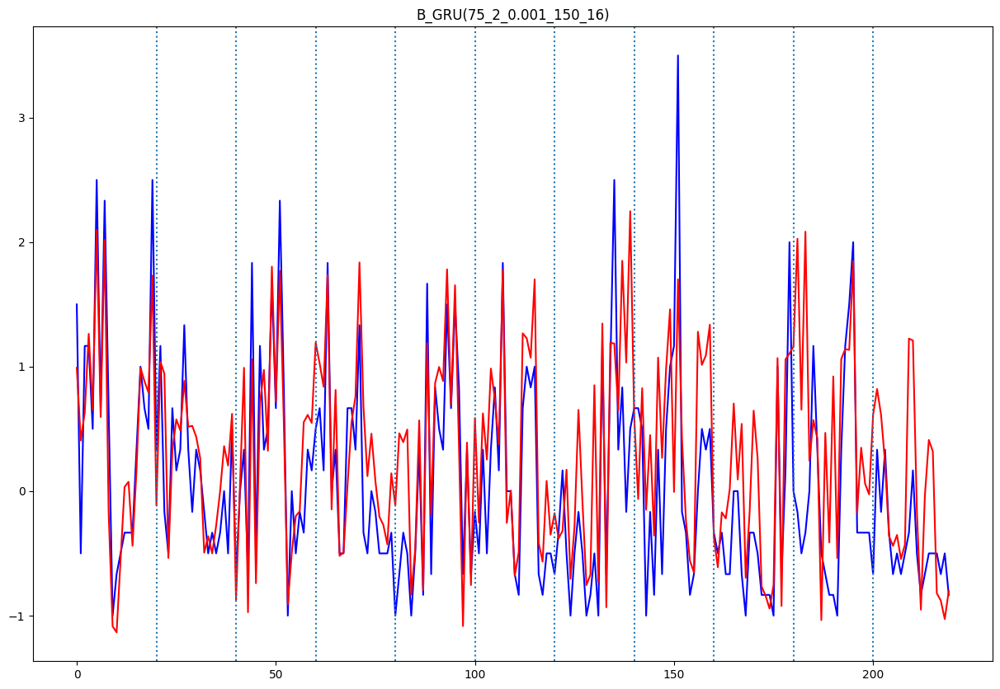

B_GRU(75_2_0.001_150_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.3798509563772861
평균 검증 RMSE: 0.6163204980992325


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

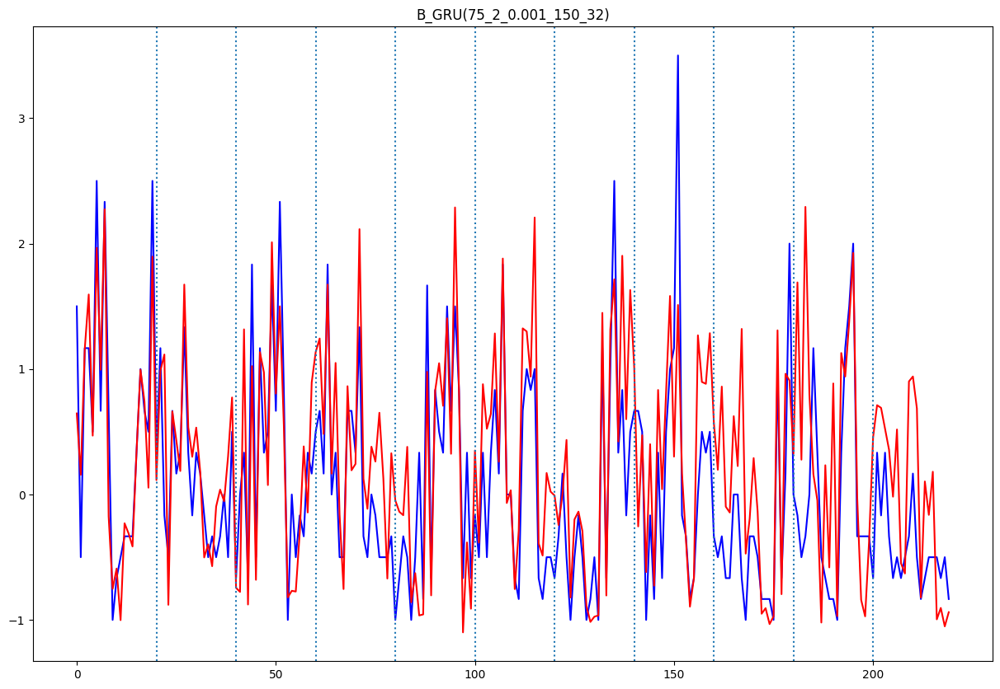

B_GRU(75_2_0.001_200_16)
7/7 [==============================] - 2s 4ms/step
평균 검증 MSE: 0.2976677239896472
평균 검증 RMSE: 0.5455893363965678


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

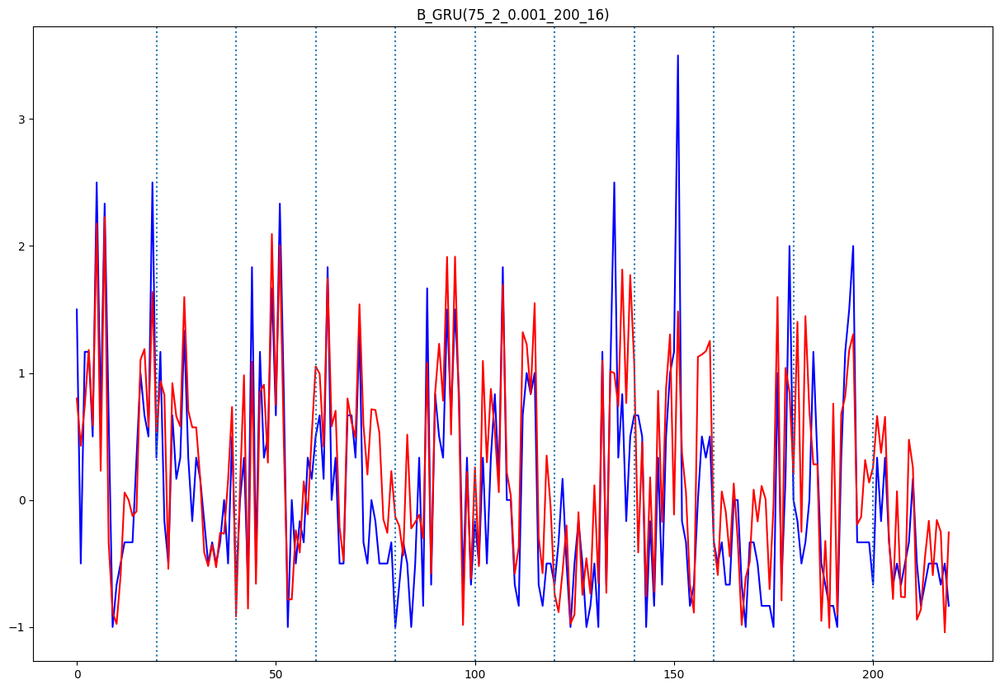

B_GRU(75_2_0.001_200_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.3347828993756103
평균 검증 RMSE: 0.5786042683696779


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

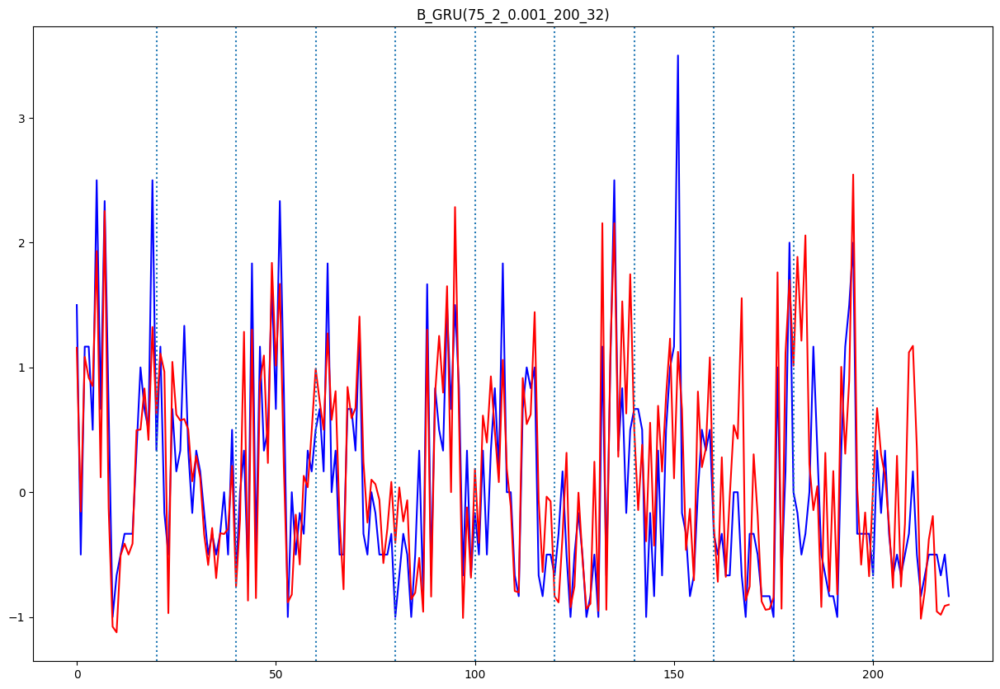

B_GRU(75_3_5e-05_100_16)
7/7 [==============================] - 2s 7ms/step
평균 검증 MSE: 0.510569135214252
평균 검증 RMSE: 0.7145412060995866


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

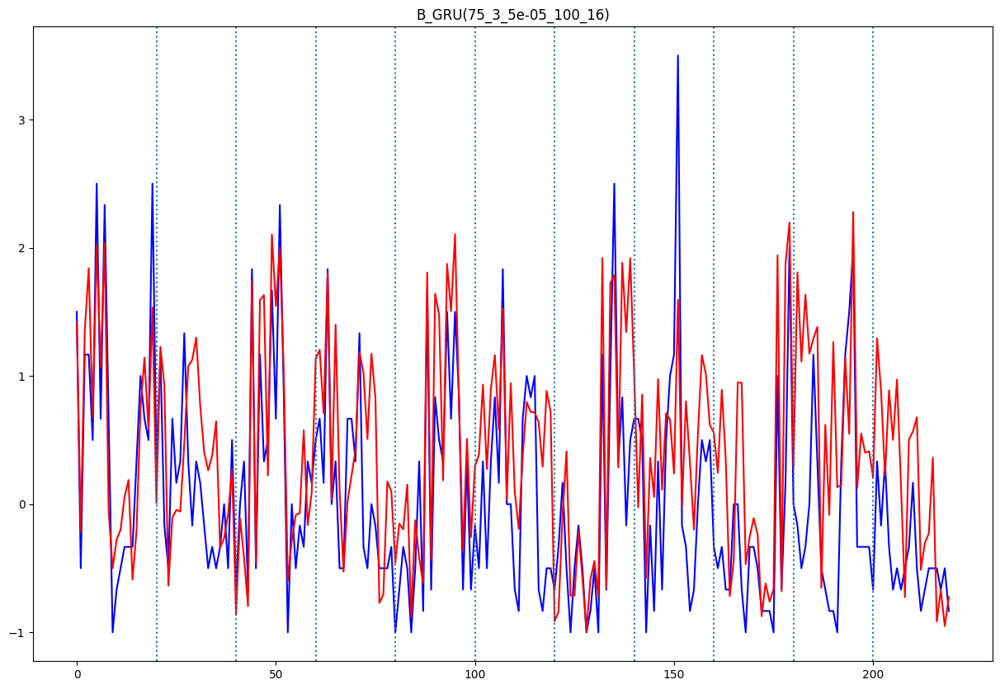

B_GRU(75_3_5e-05_100_32)
7/7 [==============================] - 1s 4ms/step
평균 검증 MSE: 0.47782575662838256
평균 검증 RMSE: 0.6912494170908086


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

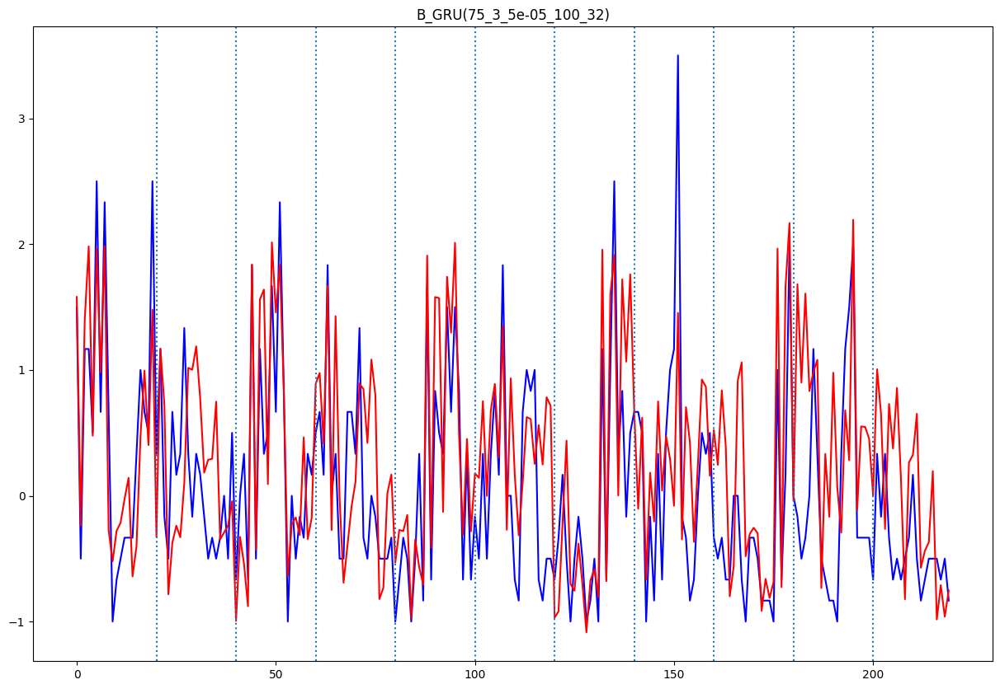

B_GRU(75_3_5e-05_150_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.5564258556953289
평균 검증 RMSE: 0.7459395791183954


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

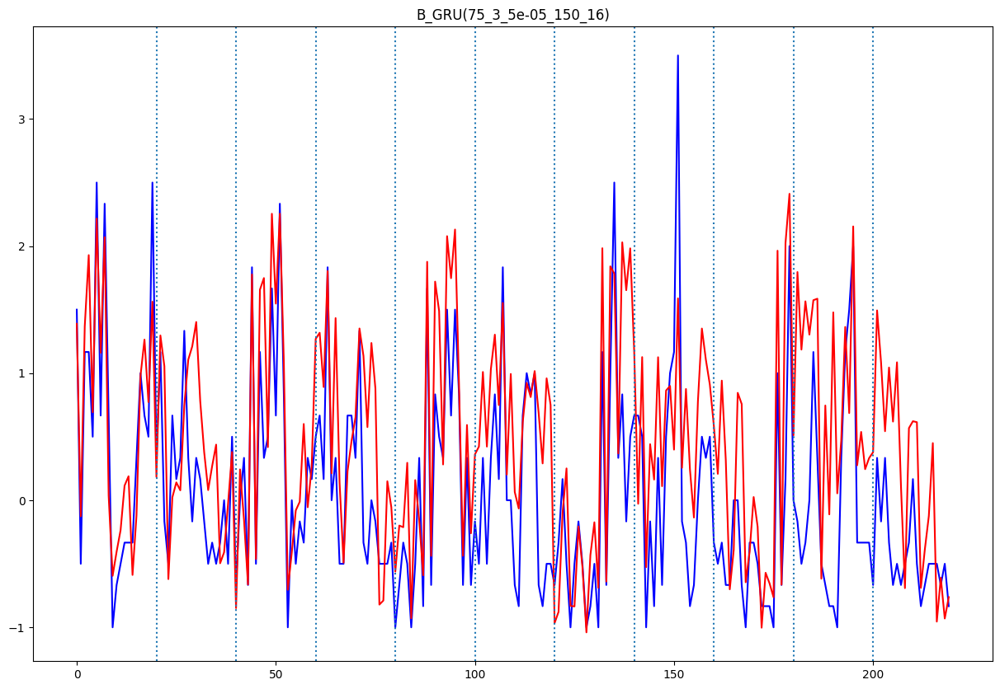

B_GRU(75_3_5e-05_150_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.43241359419480263
평균 검증 RMSE: 0.6575816254996809


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

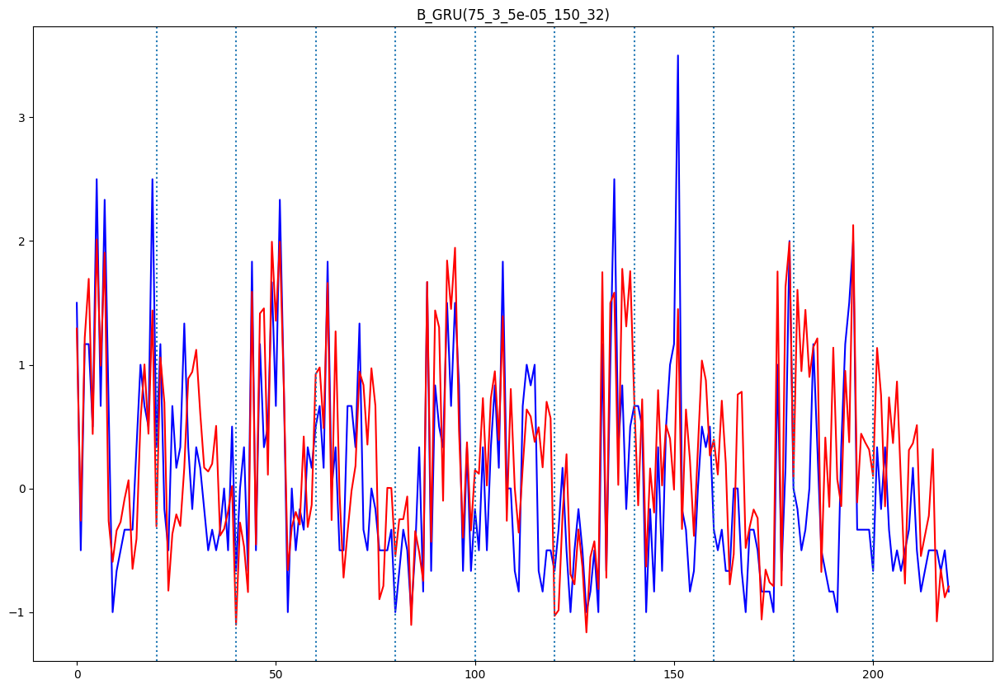

B_GRU(75_3_5e-05_200_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.5379019490628061
평균 검증 RMSE: 0.7334179906866248


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

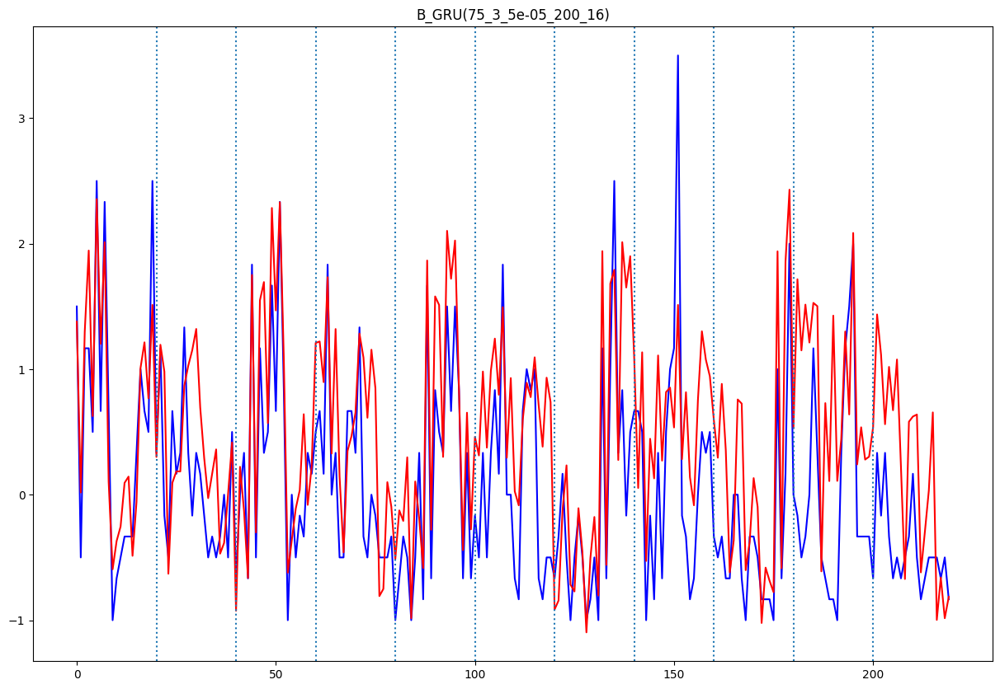

B_GRU(75_3_5e-05_200_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.4461684072035446
평균 검증 RMSE: 0.6679583873292891


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

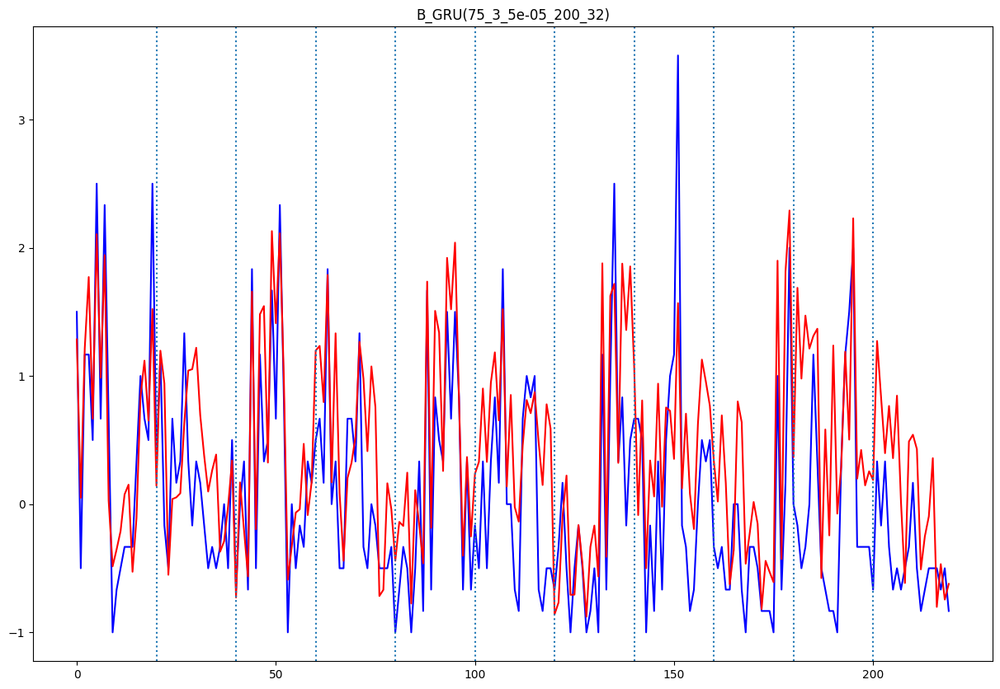

B_GRU(75_3_0.0001_100_16)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.45944559420999426
평균 검증 RMSE: 0.6778241617189478


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

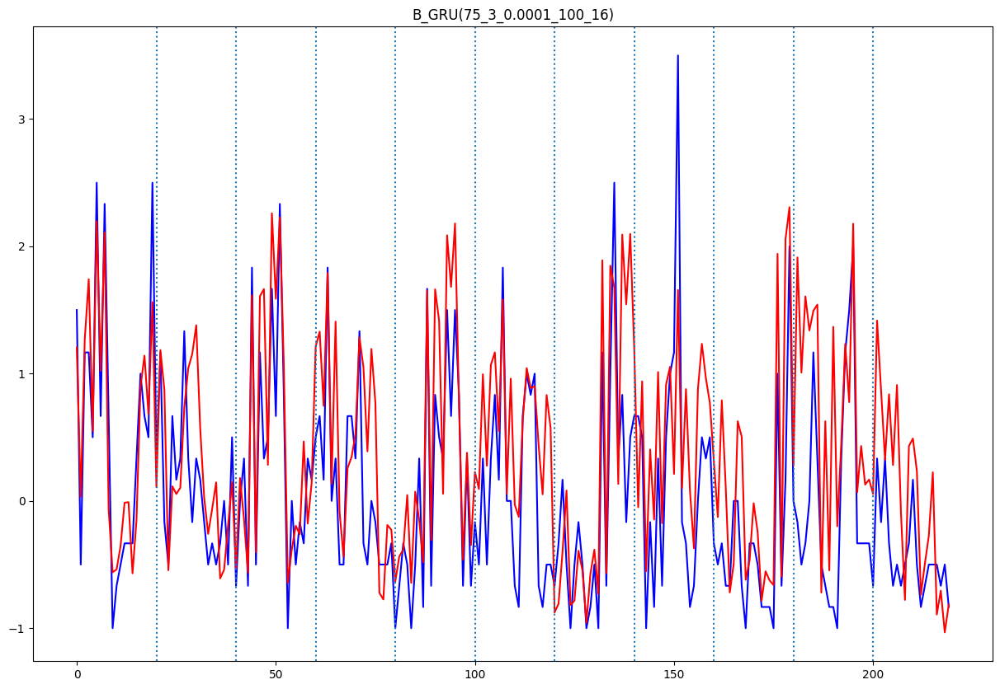

B_GRU(75_3_0.0001_100_32)
7/7 [==============================] - 1s 8ms/step
평균 검증 MSE: 0.5583685167217564
평균 검증 RMSE: 0.7472406016282549


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

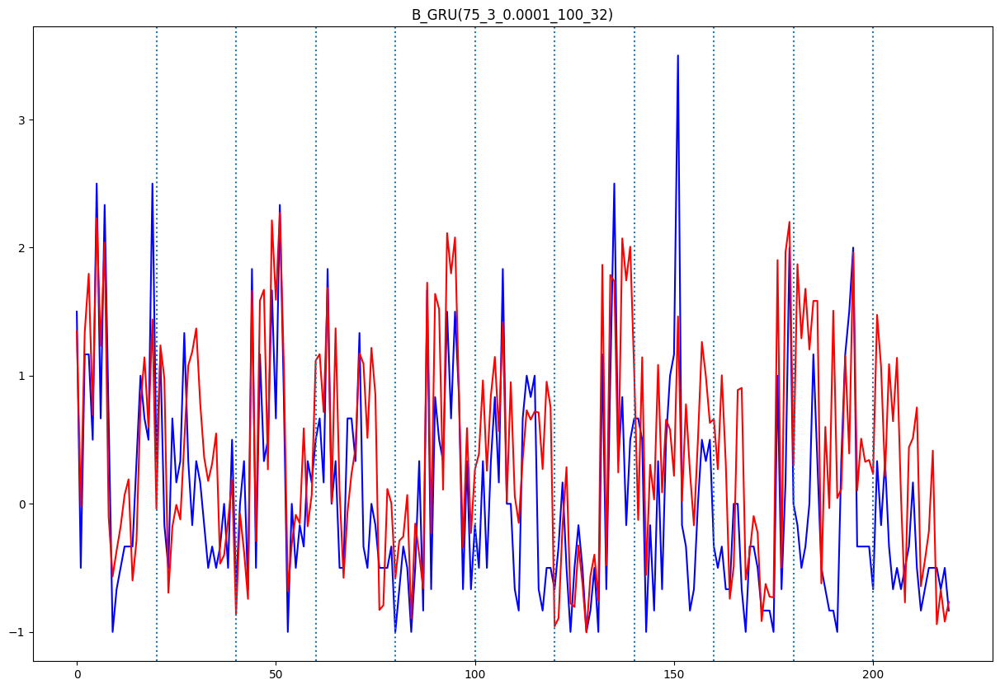

B_GRU(75_3_0.0001_150_16)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.39211834825123565
평균 검증 RMSE: 0.6261935389727649


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

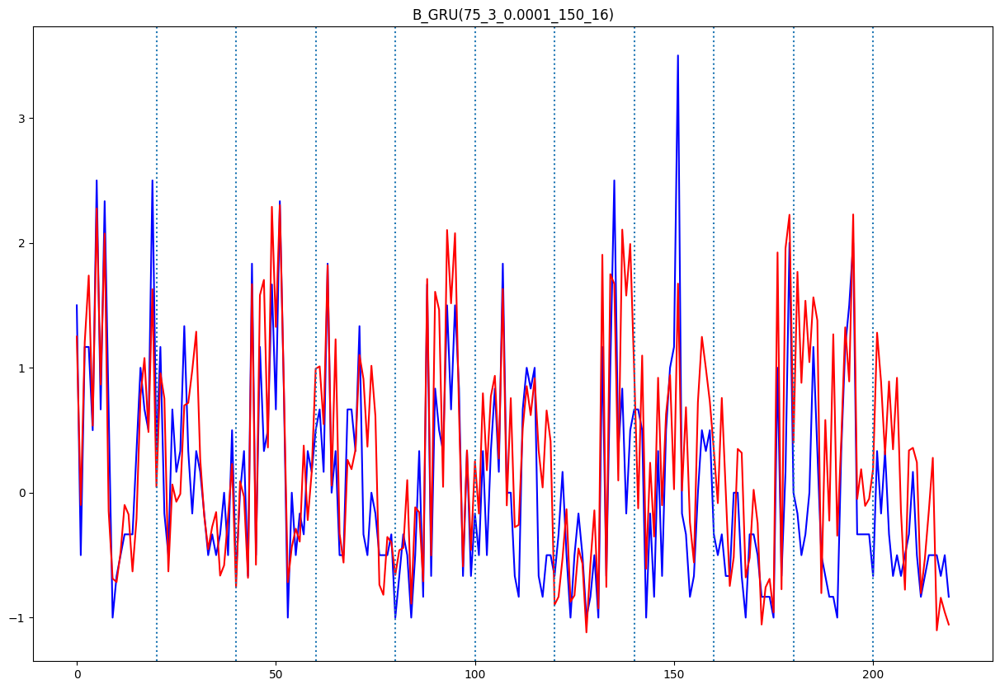

B_GRU(75_3_0.0001_150_32)
7/7 [==============================] - 2s 6ms/step
평균 검증 MSE: 0.48883712315539685
평균 검증 RMSE: 0.6991688802824371


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

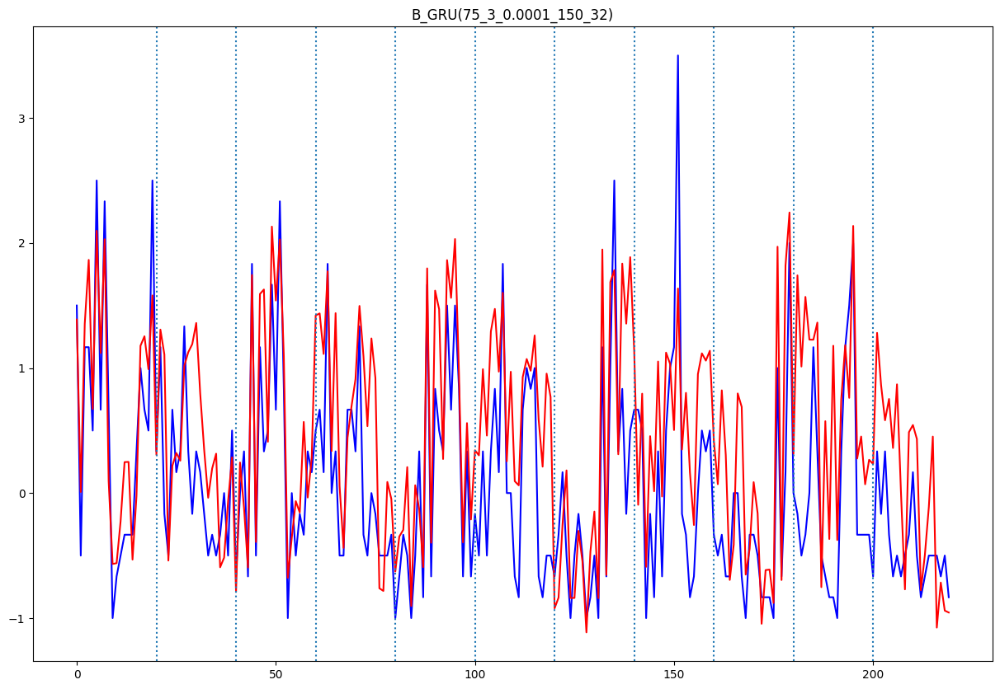

B_GRU(75_3_0.0001_200_16)
7/7 [==============================] - 1s 9ms/step
평균 검증 MSE: 0.4242405167183599
평균 검증 RMSE: 0.6513374829674398


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

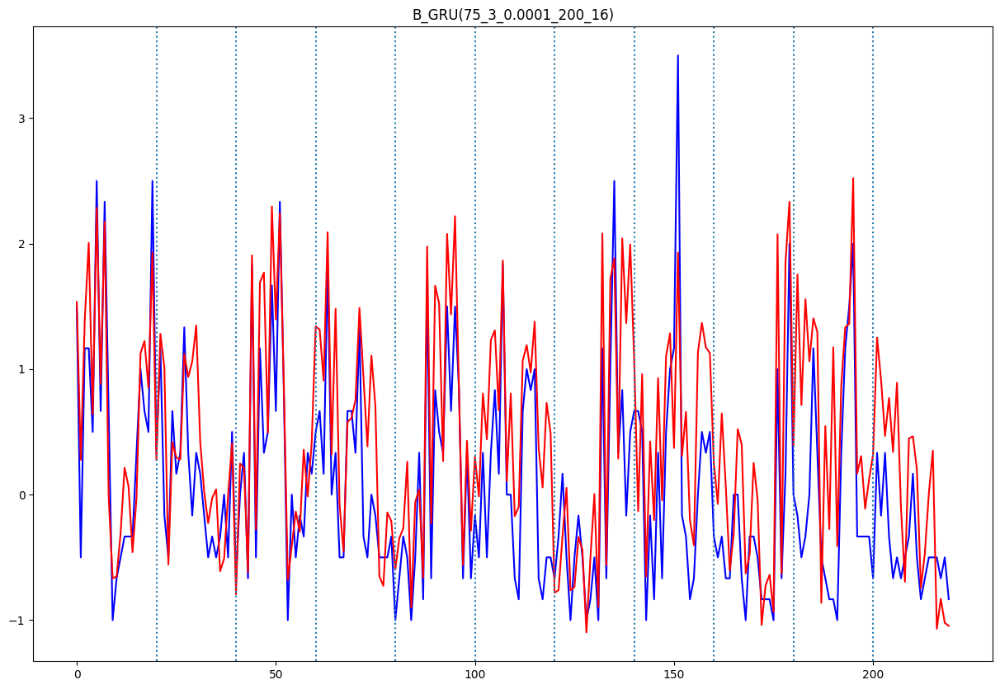

B_GRU(75_3_0.0001_200_32)
7/7 [==============================] - 1s 5ms/step
평균 검증 MSE: 0.5387898101475289
평균 검증 RMSE: 0.7340230310743178


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

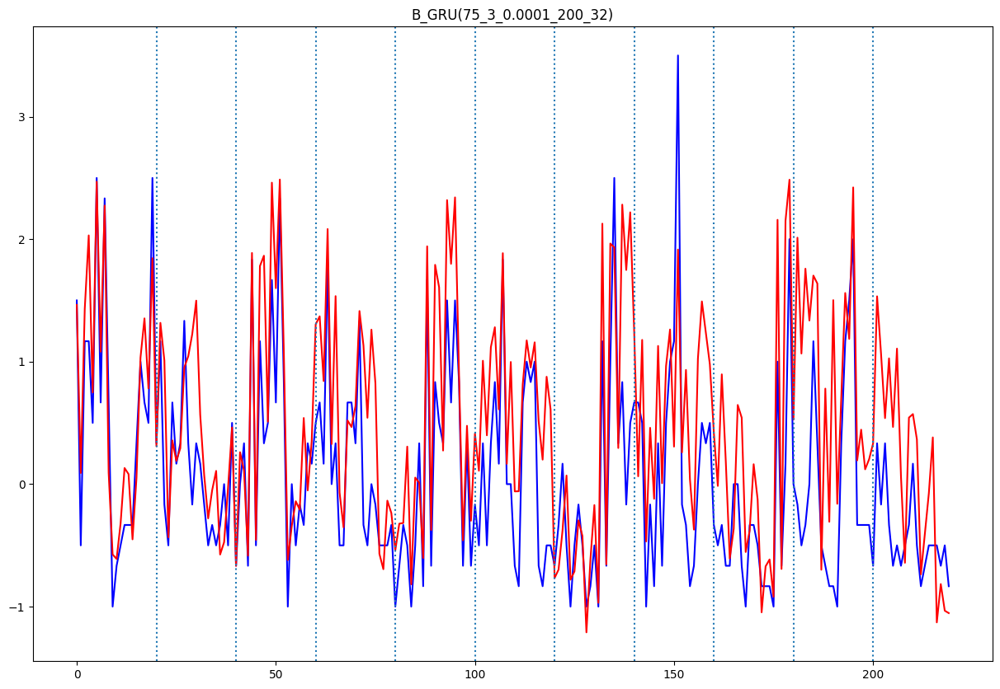

B_GRU(75_3_0.001_100_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.36573819956963816
평균 검증 RMSE: 0.6047629284022278


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

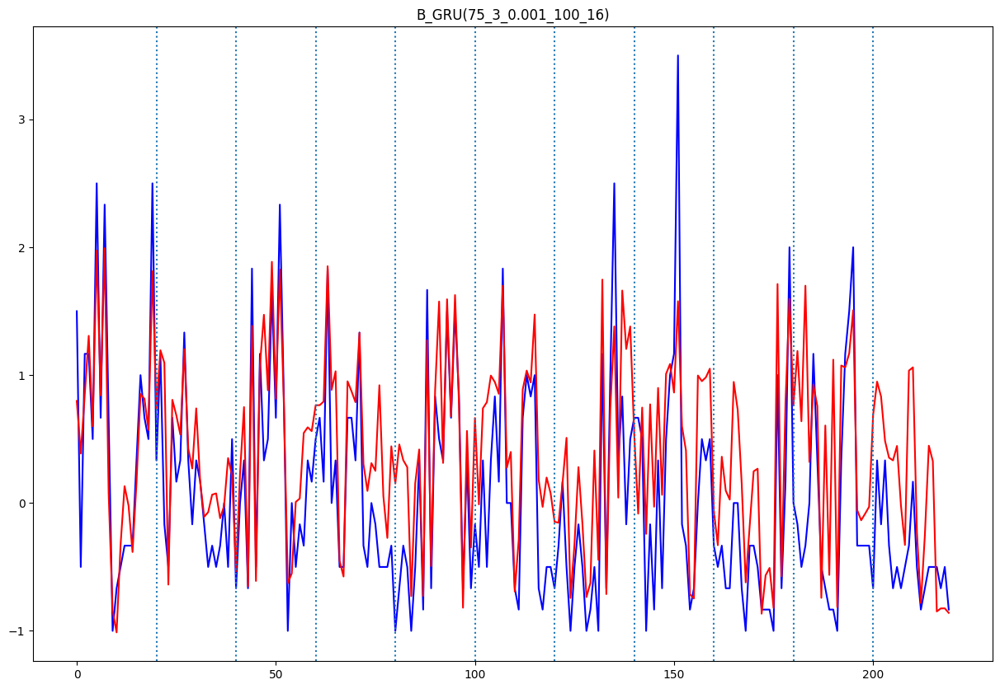

B_GRU(75_3_0.001_100_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.3084542955359632
평균 검증 RMSE: 0.5553866180742594


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

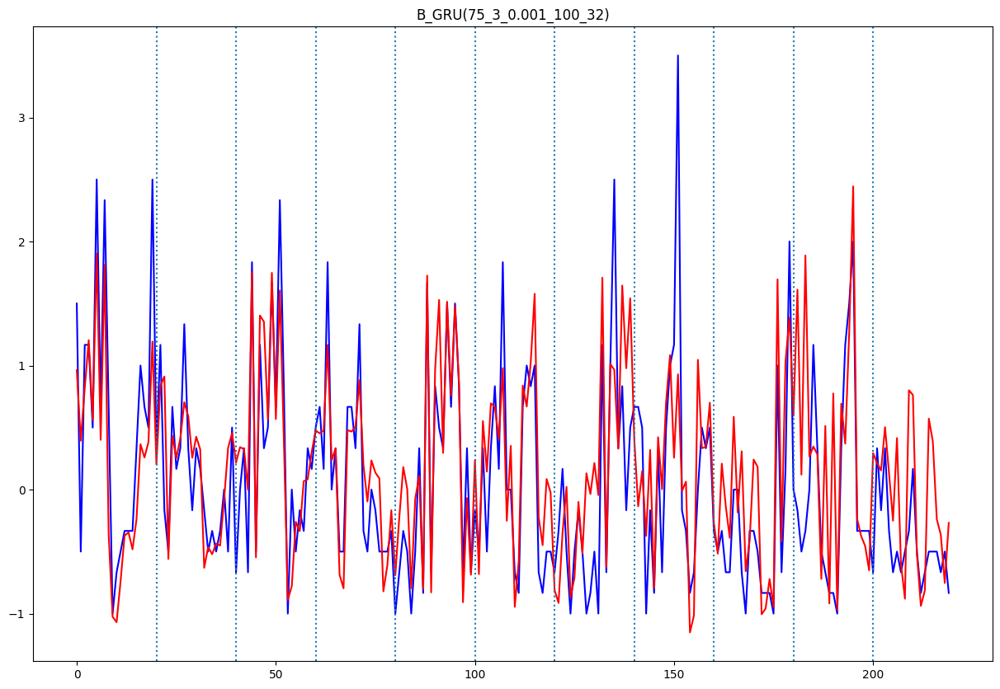

B_GRU(75_3_0.001_150_16)
7/7 [==============================] - 2s 5ms/step
평균 검증 MSE: 0.4207571772438294
평균 검증 RMSE: 0.6486579817159651


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

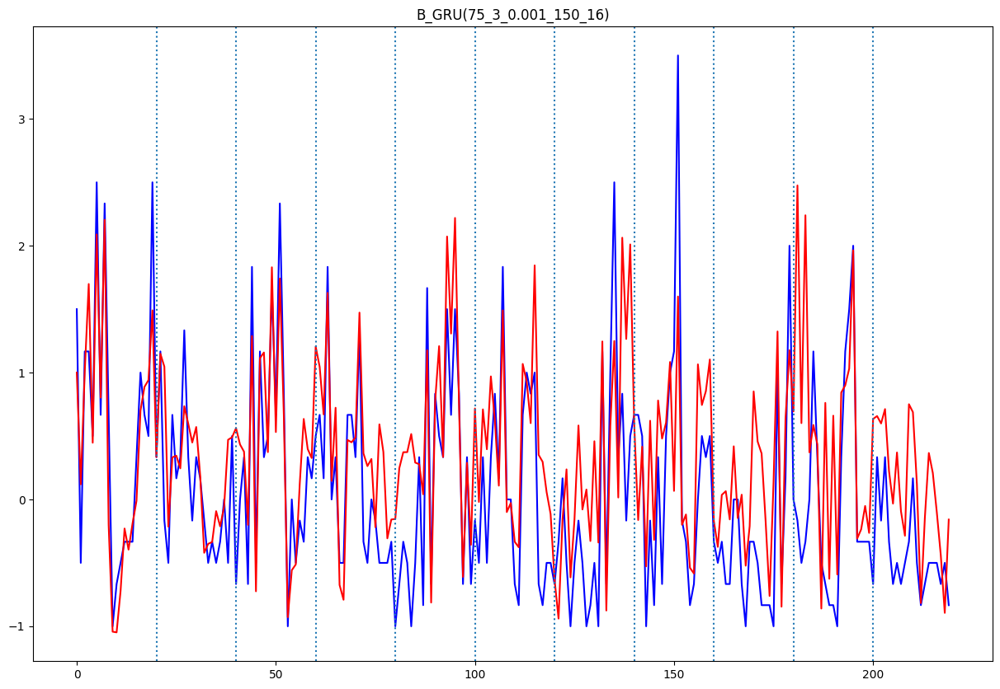

B_GRU(75_3_0.001_150_32)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.3628719805008105
평균 검증 RMSE: 0.6023885627241029


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

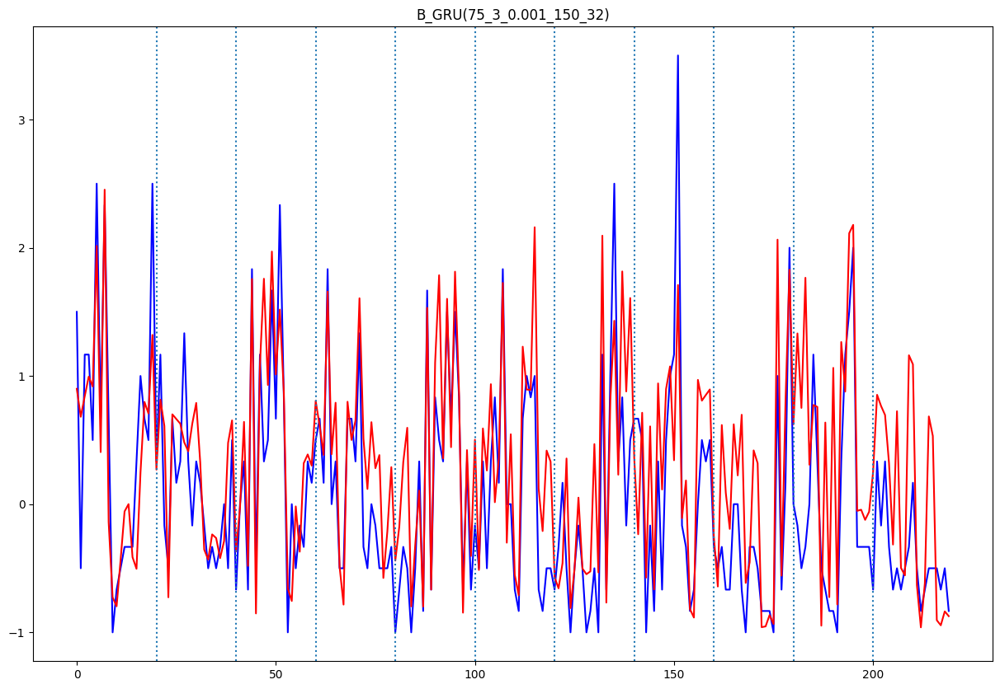

B_GRU(75_3_0.001_200_16)
7/7 [==============================] - 1s 6ms/step
평균 검증 MSE: 0.3598978756289093
평균 검증 RMSE: 0.5999148903210432


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

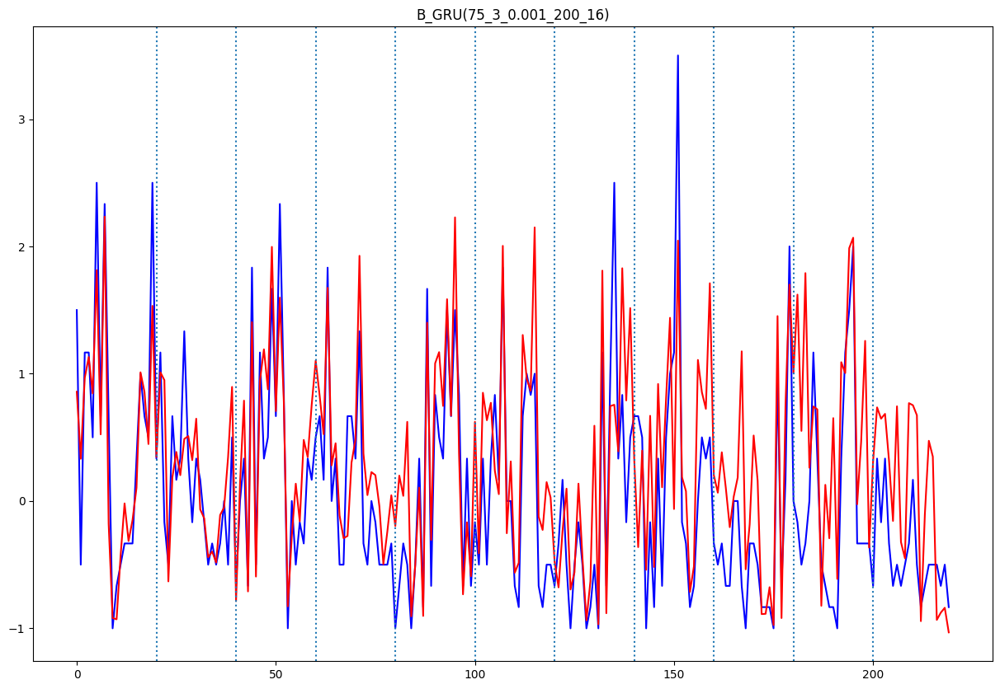

B_GRU(75_3_0.001_200_32)
7/7 [==============================] - 1s 7ms/step
평균 검증 MSE: 0.3539704952701472
평균 검증 RMSE: 0.594954195942971


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

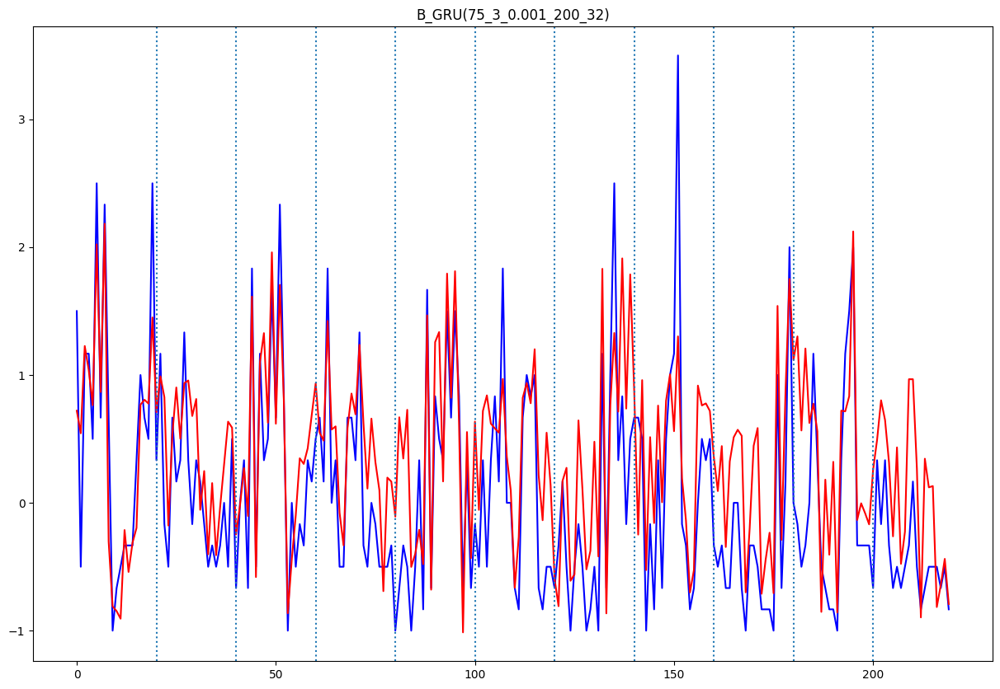

In [ ]:
history = {"case" : [], "model" : [],
           "num_units" : [], "num_layers" : [], "learning_rate" : [], "epochs" : [], "batch_size" : [],
           "mean_mse" : [], "mean_rmse" : []}

case_ = "B"
model_ = "GRU"

for num_units in num_units_case :
  for num_layers in num_layers_case :
    for learning_rate in learning_rate_case :
      for epochs in epochs_case :
        for batch_size in batch_size_case :
          # 파일 저장용 제목
          title = f"{case_}_{model_}({num_units}_{num_layers}_{learning_rate}_{epochs}_{batch_size})"

          print(f"{title}")

          # 모델 학습
          models = gru(X_train, y_train,
                      num_units = num_units,
                      num_layers = num_layers,
                      learning_rate = learning_rate,
                      epochs = epochs,
                      batch_size = batch_size)

          # 검증 진행
          mean_mse, mean_rmse = validation(X_test, y_test, models, title)

          # 기록
          history["case"].append(case_)
          history["model"].append(model_)
          history["num_units"].append(num_units)
          history["num_layers"].append(num_layers)
          history["learning_rate"].append(learning_rate)
          history["epochs"].append(epochs)
          history["batch_size"].append(batch_size)
          history["mean_mse"].append(mean_mse)
          history["mean_rmse"].append(mean_rmse)

# 기록 저장
history_df = pd.DataFrame.from_dict(data=history, orient='columns')
history_df.to_csv(f"history_{case_}_{model_}.csv", index=False)

In [ ]:
## 파일 전체 저장용

import os

file_list = os.listdir("/content")
file_list

for i in file_list :
  if i == '.config' or i == 'sample_data' :
    continue
  else :
    files.download(i)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>